In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES']='3'

# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [2]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

/usr/local/lib/python3.5/dist-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [3]:
!mkdir data

mkdir: cannot create directory 'data': File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [4]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

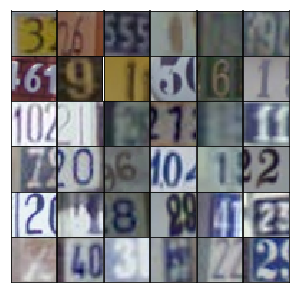

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

### MNIST Dataset

In [12]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper
import cv2
from glob import glob
helper.download_extract('mnist', data_dir)

Found mnist Data


In [13]:
class MNIST_Dataset:
    def __init__(self, data_files, shuffle=False):
        self.shuffle = shuffle
        self.data_files = data_files
    
    def read_imgs(self, imgpaths):
        minibatch = []
        for imgp in imgpaths:
            minibatch.append(
                cv2.resize(
                    cv2.imread(imgp, cv2.IMREAD_GRAYSCALE),
                    (32, 32)))
        return (np.array(minibatch).astype(np.float32)-128)/255
    
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(self.data_files))
            np.random.shuffle(idx)
        
        n_batches = len(self.data_files)//batch_size
        for ii in range(0, len(self.data_files), batch_size):
            x = self.read_imgs(self.data_files[ii:ii+batch_size])
            y = 'dummy'
            yield x, y

(25, 32, 32) float32


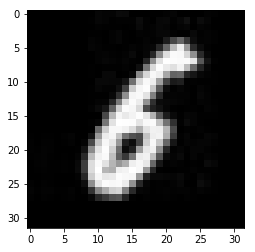

In [15]:
mnist = MNIST_Dataset(glob(os.path.join(data_dir, 'mnist/*.jpg')), shuffle=True)
for x,y in mnist.batches(25):
    pass
plt.imshow(x[4], cmap='gray')
print(x.shape, x.dtype)

## Network Inputs

Here, just creating some placeholders like normal.

In [16]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [17]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha*x1, x1)
 
        x2 = tf.layers.conv2d_transpose(x1, filters=256, 
                                        kernel_size=5, strides=(2,2), padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha*x2, x2)
        
        x3 = tf.layers.conv2d_transpose(x2, filters=128, 
                                        kernel_size=5, strides=(2,2), padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha*x3, x3)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, filters=output_dim, 
                                            kernel_size=5, strides=(2,2), padding='same')
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [18]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, filters=64, 
                              kernel_size=5, strides=(2, 2), padding='same')
        bn1 = tf.layers.batch_normalization(x1, training=True)
        lrelu1 = tf.maximum(alpha*bn1, bn1)
        
        x2 = tf.layers.conv2d(lrelu1, filters=128,
                              kernel_size=5, strides=(2, 2), padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        lrelu2 = tf.maximum(alpha*bn2, bn2)
        
        x3 = tf.layers.conv2d(lrelu2, filters=256,
                             kernel_size=5, strides=(2, 2), padding='same')
        bn3 =  tf.layers.batch_normalization(x3, training=True)
        lrelu3 = tf.maximum(alpha*bn3, bn3)
        
        flat = tf.reshape(lrelu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat,1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [19]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [20]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [21]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [22]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [23]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [24]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2420... Generator Loss: 0.9266
Epoch 1/25... Discriminator Loss: 0.3843... Generator Loss: 3.1629
Epoch 1/25... Discriminator Loss: 0.1745... Generator Loss: 2.5871
Epoch 1/25... Discriminator Loss: 0.2224... Generator Loss: 2.2486
Epoch 1/25... Discriminator Loss: 0.2260... Generator Loss: 2.3642
Epoch 1/25... Discriminator Loss: 0.1103... Generator Loss: 2.8852
Epoch 1/25... Discriminator Loss: 0.0993... Generator Loss: 3.3088
Epoch 1/25... Discriminator Loss: 0.1287... Generator Loss: 3.0191
Epoch 1/25... Discriminator Loss: 0.3227... Generator Loss: 2.3582
Epoch 1/25... Discriminator Loss: 0.7562... Generator Loss: 2.0647


/usr/local/lib/python3.5/dist-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


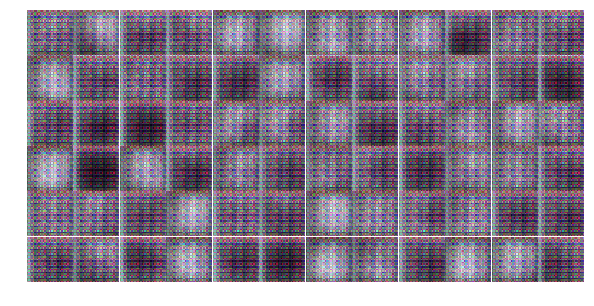

Epoch 1/25... Discriminator Loss: 0.5525... Generator Loss: 1.9243
Epoch 1/25... Discriminator Loss: 0.4435... Generator Loss: 2.0531
Epoch 1/25... Discriminator Loss: 0.4363... Generator Loss: 2.1713
Epoch 1/25... Discriminator Loss: 0.2541... Generator Loss: 2.4586
Epoch 1/25... Discriminator Loss: 0.2623... Generator Loss: 2.5667
Epoch 1/25... Discriminator Loss: 0.4177... Generator Loss: 1.5150
Epoch 1/25... Discriminator Loss: 0.3264... Generator Loss: 1.8593
Epoch 1/25... Discriminator Loss: 0.4901... Generator Loss: 2.4284
Epoch 1/25... Discriminator Loss: 0.6327... Generator Loss: 1.1146
Epoch 1/25... Discriminator Loss: 0.2368... Generator Loss: 2.6709


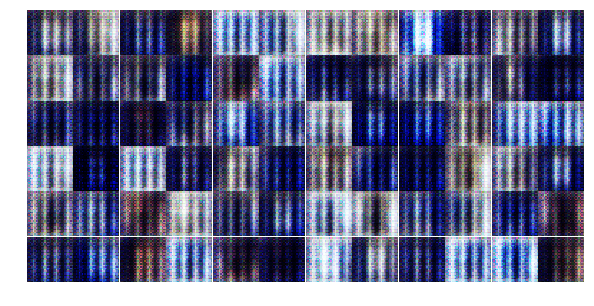

Epoch 1/25... Discriminator Loss: 0.2556... Generator Loss: 3.2465
Epoch 1/25... Discriminator Loss: 0.3102... Generator Loss: 3.8074
Epoch 1/25... Discriminator Loss: 0.9646... Generator Loss: 2.6630
Epoch 1/25... Discriminator Loss: 0.1337... Generator Loss: 3.2513
Epoch 1/25... Discriminator Loss: 0.1297... Generator Loss: 4.5542
Epoch 1/25... Discriminator Loss: 1.1310... Generator Loss: 3.5717
Epoch 1/25... Discriminator Loss: 0.6329... Generator Loss: 1.3460
Epoch 1/25... Discriminator Loss: 0.4641... Generator Loss: 1.9261
Epoch 1/25... Discriminator Loss: 0.6084... Generator Loss: 1.3079
Epoch 1/25... Discriminator Loss: 0.4138... Generator Loss: 1.6703


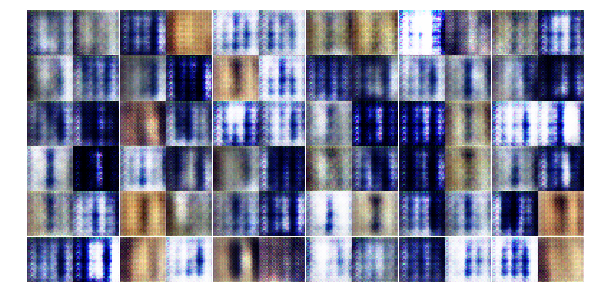

Epoch 1/25... Discriminator Loss: 0.7618... Generator Loss: 2.7282
Epoch 1/25... Discriminator Loss: 0.3626... Generator Loss: 1.6573
Epoch 1/25... Discriminator Loss: 0.1856... Generator Loss: 2.5181
Epoch 1/25... Discriminator Loss: 1.0787... Generator Loss: 0.5920
Epoch 1/25... Discriminator Loss: 0.3368... Generator Loss: 1.9206
Epoch 1/25... Discriminator Loss: 0.6742... Generator Loss: 2.6948
Epoch 1/25... Discriminator Loss: 0.9464... Generator Loss: 0.7755
Epoch 1/25... Discriminator Loss: 0.2433... Generator Loss: 2.7053
Epoch 1/25... Discriminator Loss: 1.8094... Generator Loss: 4.1939
Epoch 1/25... Discriminator Loss: 1.1870... Generator Loss: 4.1752


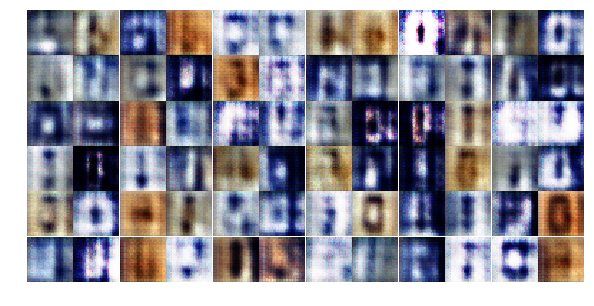

Epoch 1/25... Discriminator Loss: 0.4742... Generator Loss: 2.0647
Epoch 1/25... Discriminator Loss: 0.3991... Generator Loss: 1.7906
Epoch 1/25... Discriminator Loss: 0.1644... Generator Loss: 2.3833
Epoch 1/25... Discriminator Loss: 1.1558... Generator Loss: 2.9335
Epoch 1/25... Discriminator Loss: 0.5282... Generator Loss: 1.6118
Epoch 1/25... Discriminator Loss: 0.3098... Generator Loss: 2.6835
Epoch 1/25... Discriminator Loss: 0.3023... Generator Loss: 3.3626
Epoch 1/25... Discriminator Loss: 0.3478... Generator Loss: 1.6592
Epoch 1/25... Discriminator Loss: 0.7594... Generator Loss: 1.1212
Epoch 1/25... Discriminator Loss: 1.3447... Generator Loss: 0.4738


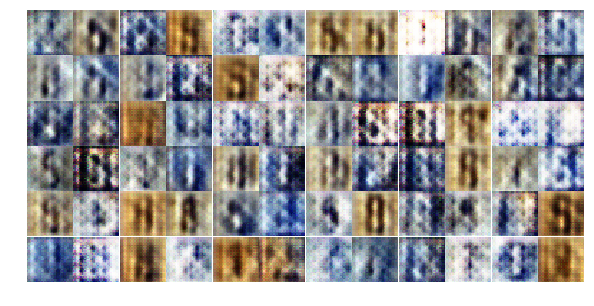

Epoch 1/25... Discriminator Loss: 0.6617... Generator Loss: 2.0454
Epoch 1/25... Discriminator Loss: 0.5545... Generator Loss: 2.8089
Epoch 1/25... Discriminator Loss: 0.4501... Generator Loss: 1.7302
Epoch 1/25... Discriminator Loss: 1.6463... Generator Loss: 0.3543
Epoch 1/25... Discriminator Loss: 0.6345... Generator Loss: 1.2474
Epoch 1/25... Discriminator Loss: 0.3582... Generator Loss: 2.2284
Epoch 1/25... Discriminator Loss: 0.4272... Generator Loss: 3.1811
Epoch 2/25... Discriminator Loss: 1.0020... Generator Loss: 0.6710
Epoch 2/25... Discriminator Loss: 0.2042... Generator Loss: 2.2925
Epoch 2/25... Discriminator Loss: 0.6976... Generator Loss: 1.1741


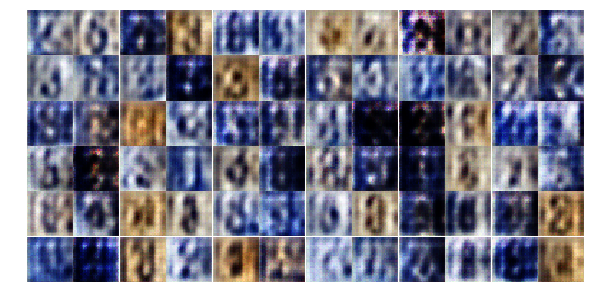

Epoch 2/25... Discriminator Loss: 0.2196... Generator Loss: 2.7596
Epoch 2/25... Discriminator Loss: 0.7340... Generator Loss: 1.7986
Epoch 2/25... Discriminator Loss: 0.6005... Generator Loss: 1.8918
Epoch 2/25... Discriminator Loss: 0.9808... Generator Loss: 0.6084
Epoch 2/25... Discriminator Loss: 0.8990... Generator Loss: 0.8816
Epoch 2/25... Discriminator Loss: 1.6435... Generator Loss: 0.3261
Epoch 2/25... Discriminator Loss: 0.6548... Generator Loss: 0.9622
Epoch 2/25... Discriminator Loss: 1.1233... Generator Loss: 0.5708
Epoch 2/25... Discriminator Loss: 0.3149... Generator Loss: 1.5835
Epoch 2/25... Discriminator Loss: 1.1304... Generator Loss: 1.8699


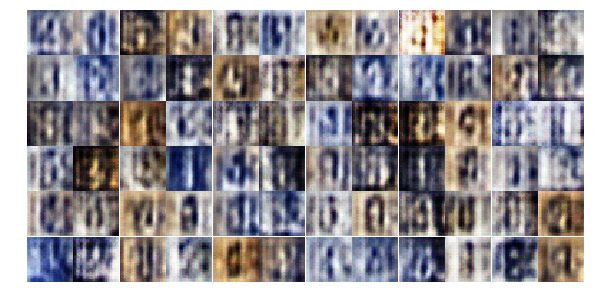

Epoch 2/25... Discriminator Loss: 0.7995... Generator Loss: 0.9154
Epoch 2/25... Discriminator Loss: 0.2256... Generator Loss: 5.6958
Epoch 2/25... Discriminator Loss: 0.1850... Generator Loss: 3.5576
Epoch 2/25... Discriminator Loss: 0.3707... Generator Loss: 1.5207
Epoch 2/25... Discriminator Loss: 0.2230... Generator Loss: 4.0157
Epoch 2/25... Discriminator Loss: 0.4502... Generator Loss: 6.0532
Epoch 2/25... Discriminator Loss: 5.1668... Generator Loss: 6.1677
Epoch 2/25... Discriminator Loss: 1.0952... Generator Loss: 0.8860
Epoch 2/25... Discriminator Loss: 0.6444... Generator Loss: 1.8505
Epoch 2/25... Discriminator Loss: 0.3976... Generator Loss: 5.0988


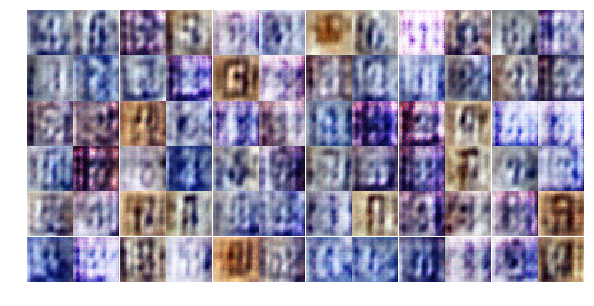

Epoch 2/25... Discriminator Loss: 0.2135... Generator Loss: 2.3044
Epoch 2/25... Discriminator Loss: 1.1863... Generator Loss: 0.4771
Epoch 2/25... Discriminator Loss: 0.1957... Generator Loss: 4.0579
Epoch 2/25... Discriminator Loss: 0.8602... Generator Loss: 6.5518
Epoch 2/25... Discriminator Loss: 0.3087... Generator Loss: 3.4437
Epoch 2/25... Discriminator Loss: 0.7092... Generator Loss: 5.2951
Epoch 2/25... Discriminator Loss: 0.4378... Generator Loss: 1.5878
Epoch 2/25... Discriminator Loss: 2.5557... Generator Loss: 3.0364
Epoch 2/25... Discriminator Loss: 0.7147... Generator Loss: 4.1412
Epoch 2/25... Discriminator Loss: 1.4107... Generator Loss: 0.3947


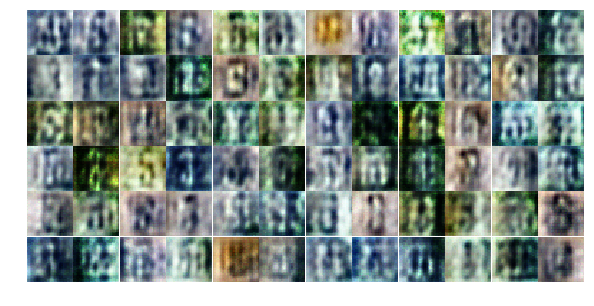

Epoch 2/25... Discriminator Loss: 0.2994... Generator Loss: 1.5582
Epoch 2/25... Discriminator Loss: 0.0486... Generator Loss: 4.0250
Epoch 2/25... Discriminator Loss: 0.9579... Generator Loss: 6.5021
Epoch 2/25... Discriminator Loss: 0.2989... Generator Loss: 4.8781
Epoch 2/25... Discriminator Loss: 0.1773... Generator Loss: 3.2475
Epoch 2/25... Discriminator Loss: 0.2886... Generator Loss: 2.0336
Epoch 2/25... Discriminator Loss: 0.1307... Generator Loss: 4.0241
Epoch 2/25... Discriminator Loss: 0.9969... Generator Loss: 0.5759
Epoch 2/25... Discriminator Loss: 1.3569... Generator Loss: 0.3842
Epoch 2/25... Discriminator Loss: 0.0706... Generator Loss: 4.5762


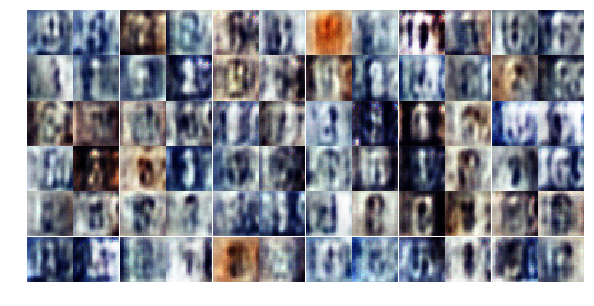

Epoch 2/25... Discriminator Loss: 0.0751... Generator Loss: 5.1844
Epoch 2/25... Discriminator Loss: 2.4456... Generator Loss: 0.1447
Epoch 2/25... Discriminator Loss: 0.1990... Generator Loss: 3.6581
Epoch 2/25... Discriminator Loss: 2.5825... Generator Loss: 5.5814
Epoch 2/25... Discriminator Loss: 0.1517... Generator Loss: 5.2963
Epoch 2/25... Discriminator Loss: 0.3151... Generator Loss: 2.5823
Epoch 2/25... Discriminator Loss: 0.0820... Generator Loss: 4.8774
Epoch 2/25... Discriminator Loss: 0.4055... Generator Loss: 3.6502
Epoch 2/25... Discriminator Loss: 0.4672... Generator Loss: 1.3611
Epoch 2/25... Discriminator Loss: 0.1628... Generator Loss: 3.6352


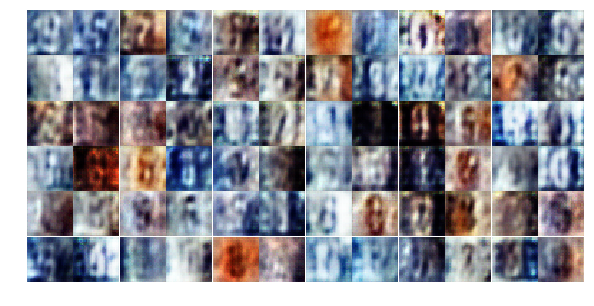

Epoch 2/25... Discriminator Loss: 0.0611... Generator Loss: 5.2181
Epoch 2/25... Discriminator Loss: 0.2471... Generator Loss: 2.2834
Epoch 2/25... Discriminator Loss: 0.1335... Generator Loss: 2.9903
Epoch 2/25... Discriminator Loss: 0.3232... Generator Loss: 3.2822
Epoch 3/25... Discriminator Loss: 0.0587... Generator Loss: 4.5379
Epoch 3/25... Discriminator Loss: 0.4804... Generator Loss: 1.4523
Epoch 3/25... Discriminator Loss: 0.4489... Generator Loss: 1.7669
Epoch 3/25... Discriminator Loss: 0.0561... Generator Loss: 3.5245
Epoch 3/25... Discriminator Loss: 1.2538... Generator Loss: 0.4809
Epoch 3/25... Discriminator Loss: 0.1334... Generator Loss: 4.0223


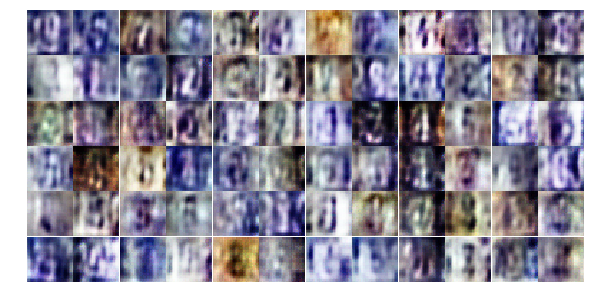

Epoch 3/25... Discriminator Loss: 1.5287... Generator Loss: 0.3175
Epoch 3/25... Discriminator Loss: 0.2608... Generator Loss: 2.7644
Epoch 3/25... Discriminator Loss: 1.1684... Generator Loss: 0.4989
Epoch 3/25... Discriminator Loss: 0.3153... Generator Loss: 5.0416
Epoch 3/25... Discriminator Loss: 0.0642... Generator Loss: 3.4949
Epoch 3/25... Discriminator Loss: 0.0892... Generator Loss: 4.6013
Epoch 3/25... Discriminator Loss: 0.2410... Generator Loss: 3.9128
Epoch 3/25... Discriminator Loss: 0.3131... Generator Loss: 4.9579
Epoch 3/25... Discriminator Loss: 0.5719... Generator Loss: 1.2913
Epoch 3/25... Discriminator Loss: 0.2339... Generator Loss: 2.5295


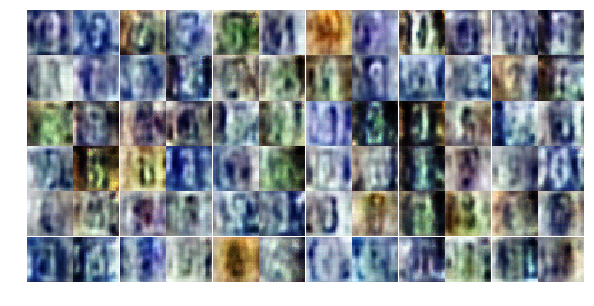

Epoch 3/25... Discriminator Loss: 0.5040... Generator Loss: 1.4604
Epoch 3/25... Discriminator Loss: 0.4596... Generator Loss: 5.2811
Epoch 3/25... Discriminator Loss: 0.2077... Generator Loss: 2.5969
Epoch 3/25... Discriminator Loss: 0.2188... Generator Loss: 2.1549
Epoch 3/25... Discriminator Loss: 0.3420... Generator Loss: 3.5591
Epoch 3/25... Discriminator Loss: 1.2357... Generator Loss: 0.5694
Epoch 3/25... Discriminator Loss: 1.2103... Generator Loss: 4.4543
Epoch 3/25... Discriminator Loss: 0.7729... Generator Loss: 3.7963
Epoch 3/25... Discriminator Loss: 0.9649... Generator Loss: 0.6831
Epoch 3/25... Discriminator Loss: 0.1357... Generator Loss: 7.0113


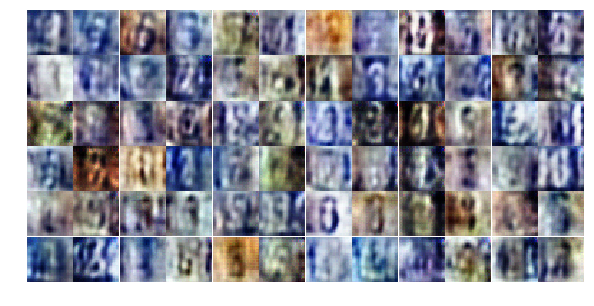

Epoch 3/25... Discriminator Loss: 0.6908... Generator Loss: 7.4996
Epoch 3/25... Discriminator Loss: 0.4725... Generator Loss: 1.4212
Epoch 3/25... Discriminator Loss: 1.2281... Generator Loss: 0.5229
Epoch 3/25... Discriminator Loss: 0.7839... Generator Loss: 3.8509
Epoch 3/25... Discriminator Loss: 0.7350... Generator Loss: 1.1040
Epoch 3/25... Discriminator Loss: 0.3512... Generator Loss: 5.9972
Epoch 3/25... Discriminator Loss: 0.8750... Generator Loss: 5.7395
Epoch 3/25... Discriminator Loss: 0.1967... Generator Loss: 4.1852
Epoch 3/25... Discriminator Loss: 0.5545... Generator Loss: 1.1731
Epoch 3/25... Discriminator Loss: 1.1492... Generator Loss: 0.5787


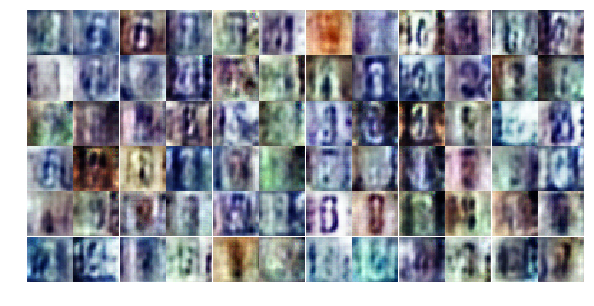

Epoch 3/25... Discriminator Loss: 0.7174... Generator Loss: 1.8468
Epoch 3/25... Discriminator Loss: 0.7473... Generator Loss: 0.9868
Epoch 3/25... Discriminator Loss: 0.2789... Generator Loss: 1.8222
Epoch 3/25... Discriminator Loss: 0.5822... Generator Loss: 7.0234
Epoch 3/25... Discriminator Loss: 0.6687... Generator Loss: 1.2578
Epoch 3/25... Discriminator Loss: 0.4504... Generator Loss: 4.0110
Epoch 3/25... Discriminator Loss: 0.1238... Generator Loss: 5.3944
Epoch 3/25... Discriminator Loss: 0.7286... Generator Loss: 1.0370
Epoch 3/25... Discriminator Loss: 0.7165... Generator Loss: 3.3838
Epoch 3/25... Discriminator Loss: 0.4853... Generator Loss: 3.6507


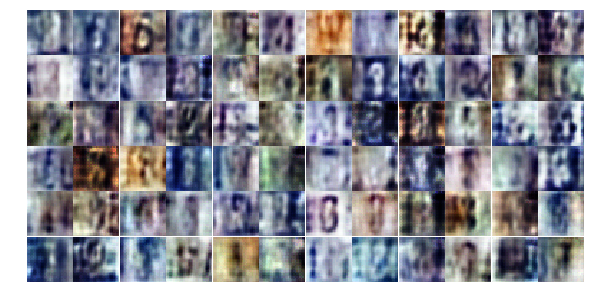

Epoch 3/25... Discriminator Loss: 0.9510... Generator Loss: 0.7717
Epoch 3/25... Discriminator Loss: 0.3563... Generator Loss: 6.0870
Epoch 3/25... Discriminator Loss: 0.2554... Generator Loss: 2.6516
Epoch 3/25... Discriminator Loss: 0.3299... Generator Loss: 2.0522
Epoch 3/25... Discriminator Loss: 0.2527... Generator Loss: 2.4758
Epoch 3/25... Discriminator Loss: 0.1921... Generator Loss: 3.1285
Epoch 3/25... Discriminator Loss: 0.3327... Generator Loss: 1.6974
Epoch 3/25... Discriminator Loss: 0.6874... Generator Loss: 4.6260
Epoch 3/25... Discriminator Loss: 0.4588... Generator Loss: 1.6763
Epoch 3/25... Discriminator Loss: 0.9765... Generator Loss: 0.7991


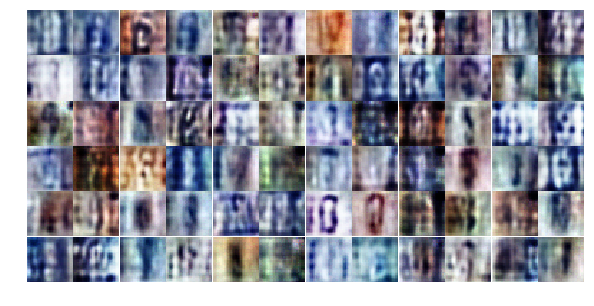

Epoch 3/25... Discriminator Loss: 0.6378... Generator Loss: 1.2369
Epoch 4/25... Discriminator Loss: 0.5102... Generator Loss: 1.5577
Epoch 4/25... Discriminator Loss: 0.4534... Generator Loss: 1.2861
Epoch 4/25... Discriminator Loss: 0.8137... Generator Loss: 1.0103
Epoch 4/25... Discriminator Loss: 0.5687... Generator Loss: 1.6986
Epoch 4/25... Discriminator Loss: 0.4830... Generator Loss: 1.2526
Epoch 4/25... Discriminator Loss: 0.2514... Generator Loss: 4.1367
Epoch 4/25... Discriminator Loss: 0.6236... Generator Loss: 1.1511
Epoch 4/25... Discriminator Loss: 2.5968... Generator Loss: 5.2912
Epoch 4/25... Discriminator Loss: 0.7128... Generator Loss: 1.0916


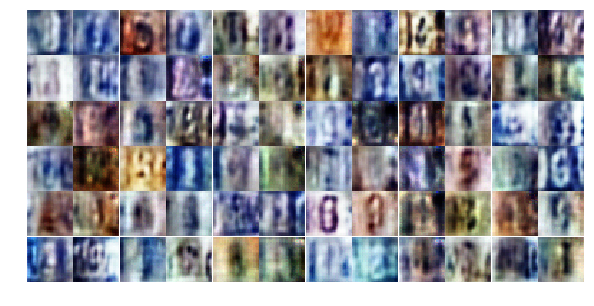

Epoch 4/25... Discriminator Loss: 1.7506... Generator Loss: 0.2861
Epoch 4/25... Discriminator Loss: 0.6543... Generator Loss: 2.8271
Epoch 4/25... Discriminator Loss: 0.4789... Generator Loss: 1.8956
Epoch 4/25... Discriminator Loss: 0.6871... Generator Loss: 1.2925
Epoch 4/25... Discriminator Loss: 1.3343... Generator Loss: 0.4333
Epoch 4/25... Discriminator Loss: 0.1891... Generator Loss: 3.7719
Epoch 4/25... Discriminator Loss: 0.4973... Generator Loss: 4.6967
Epoch 4/25... Discriminator Loss: 0.3616... Generator Loss: 7.1833
Epoch 4/25... Discriminator Loss: 2.1763... Generator Loss: 0.1870
Epoch 4/25... Discriminator Loss: 0.3083... Generator Loss: 2.4785


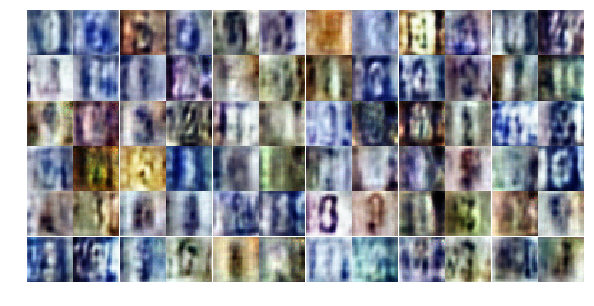

Epoch 4/25... Discriminator Loss: 0.3111... Generator Loss: 1.8305
Epoch 4/25... Discriminator Loss: 1.0094... Generator Loss: 0.6107
Epoch 4/25... Discriminator Loss: 1.0081... Generator Loss: 4.1194
Epoch 4/25... Discriminator Loss: 1.1040... Generator Loss: 1.9337
Epoch 4/25... Discriminator Loss: 0.3640... Generator Loss: 2.4191
Epoch 4/25... Discriminator Loss: 0.3996... Generator Loss: 1.6118
Epoch 4/25... Discriminator Loss: 0.3996... Generator Loss: 1.6395
Epoch 4/25... Discriminator Loss: 0.1418... Generator Loss: 3.7824
Epoch 4/25... Discriminator Loss: 0.1798... Generator Loss: 4.0794
Epoch 4/25... Discriminator Loss: 0.4765... Generator Loss: 1.5017


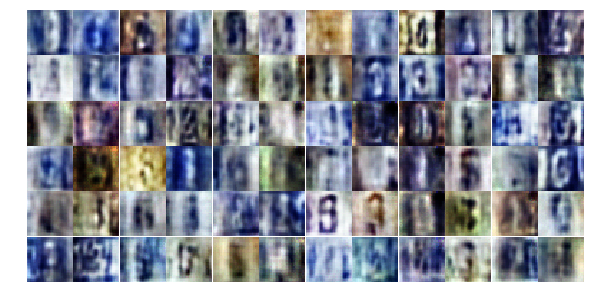

Epoch 4/25... Discriminator Loss: 0.1598... Generator Loss: 3.1784
Epoch 4/25... Discriminator Loss: 0.4102... Generator Loss: 3.7824
Epoch 4/25... Discriminator Loss: 0.5297... Generator Loss: 2.1294
Epoch 4/25... Discriminator Loss: 0.5227... Generator Loss: 2.4529
Epoch 4/25... Discriminator Loss: 0.2832... Generator Loss: 1.9894
Epoch 4/25... Discriminator Loss: 0.1524... Generator Loss: 4.0072
Epoch 4/25... Discriminator Loss: 0.2271... Generator Loss: 2.7009
Epoch 4/25... Discriminator Loss: 0.0457... Generator Loss: 8.1500
Epoch 4/25... Discriminator Loss: 0.2110... Generator Loss: 2.6035
Epoch 4/25... Discriminator Loss: 0.1386... Generator Loss: 5.9320


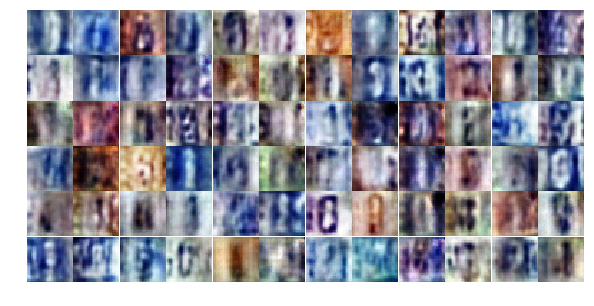

Epoch 4/25... Discriminator Loss: 0.4866... Generator Loss: 2.1867
Epoch 4/25... Discriminator Loss: 0.9915... Generator Loss: 0.7401
Epoch 4/25... Discriminator Loss: 0.6043... Generator Loss: 1.0995
Epoch 4/25... Discriminator Loss: 0.7202... Generator Loss: 1.0188
Epoch 4/25... Discriminator Loss: 0.1710... Generator Loss: 2.5338
Epoch 4/25... Discriminator Loss: 0.1216... Generator Loss: 4.3587
Epoch 4/25... Discriminator Loss: 0.5831... Generator Loss: 2.6939
Epoch 4/25... Discriminator Loss: 0.2981... Generator Loss: 5.9504
Epoch 4/25... Discriminator Loss: 1.0375... Generator Loss: 3.3296
Epoch 4/25... Discriminator Loss: 0.8407... Generator Loss: 4.6065


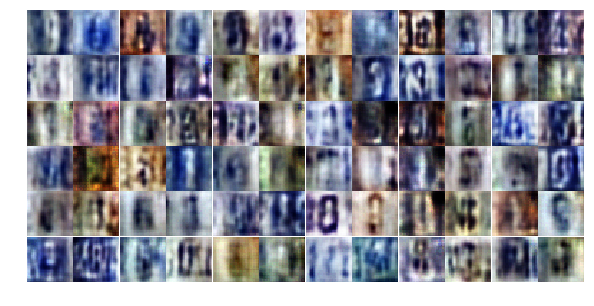

Epoch 4/25... Discriminator Loss: 0.9734... Generator Loss: 0.7997
Epoch 4/25... Discriminator Loss: 0.3153... Generator Loss: 2.3921
Epoch 4/25... Discriminator Loss: 0.6295... Generator Loss: 1.0484
Epoch 4/25... Discriminator Loss: 0.1617... Generator Loss: 3.1710
Epoch 4/25... Discriminator Loss: 0.4941... Generator Loss: 3.5249
Epoch 4/25... Discriminator Loss: 0.1360... Generator Loss: 3.3527
Epoch 4/25... Discriminator Loss: 0.1378... Generator Loss: 3.6596
Epoch 4/25... Discriminator Loss: 0.9102... Generator Loss: 5.8460
Epoch 4/25... Discriminator Loss: 0.3596... Generator Loss: 1.9952
Epoch 5/25... Discriminator Loss: 0.5190... Generator Loss: 5.3449


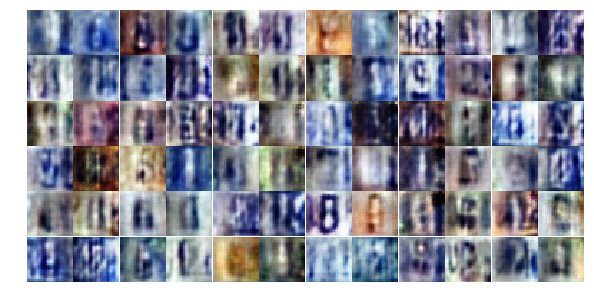

Epoch 5/25... Discriminator Loss: 0.2213... Generator Loss: 2.5958
Epoch 5/25... Discriminator Loss: 0.8687... Generator Loss: 0.7856
Epoch 5/25... Discriminator Loss: 0.2852... Generator Loss: 5.2197
Epoch 5/25... Discriminator Loss: 1.8970... Generator Loss: 0.8283
Epoch 5/25... Discriminator Loss: 0.3172... Generator Loss: 2.2254
Epoch 5/25... Discriminator Loss: 0.8417... Generator Loss: 1.1482
Epoch 5/25... Discriminator Loss: 0.6018... Generator Loss: 1.8699
Epoch 5/25... Discriminator Loss: 0.8719... Generator Loss: 2.8633
Epoch 5/25... Discriminator Loss: 2.0430... Generator Loss: 0.2094
Epoch 5/25... Discriminator Loss: 0.5705... Generator Loss: 3.3466


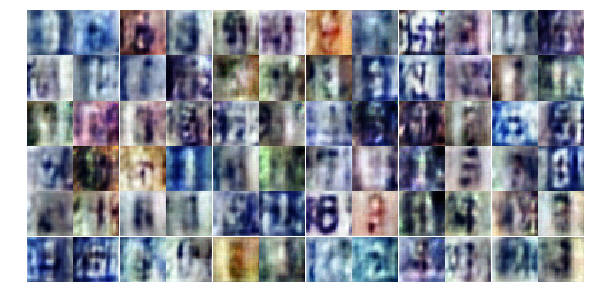

Epoch 5/25... Discriminator Loss: 0.4727... Generator Loss: 1.3951
Epoch 5/25... Discriminator Loss: 0.4647... Generator Loss: 1.4440
Epoch 5/25... Discriminator Loss: 0.1802... Generator Loss: 3.2181
Epoch 5/25... Discriminator Loss: 0.3138... Generator Loss: 2.3811
Epoch 5/25... Discriminator Loss: 0.1051... Generator Loss: 4.1182
Epoch 5/25... Discriminator Loss: 0.3468... Generator Loss: 1.7227
Epoch 5/25... Discriminator Loss: 1.5198... Generator Loss: 0.4134
Epoch 5/25... Discriminator Loss: 0.4318... Generator Loss: 1.7717
Epoch 5/25... Discriminator Loss: 0.2533... Generator Loss: 2.5150
Epoch 5/25... Discriminator Loss: 0.2420... Generator Loss: 2.9076


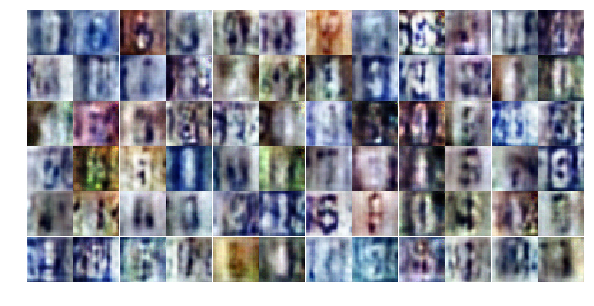

Epoch 5/25... Discriminator Loss: 0.3056... Generator Loss: 3.6051
Epoch 5/25... Discriminator Loss: 0.1150... Generator Loss: 4.0835
Epoch 5/25... Discriminator Loss: 0.6555... Generator Loss: 6.9546
Epoch 5/25... Discriminator Loss: 0.2518... Generator Loss: 2.2450
Epoch 5/25... Discriminator Loss: 1.0120... Generator Loss: 4.8847
Epoch 5/25... Discriminator Loss: 0.1537... Generator Loss: 3.8943
Epoch 5/25... Discriminator Loss: 0.7508... Generator Loss: 0.9122
Epoch 5/25... Discriminator Loss: 1.5124... Generator Loss: 0.8686
Epoch 5/25... Discriminator Loss: 0.7966... Generator Loss: 1.3607
Epoch 5/25... Discriminator Loss: 0.2986... Generator Loss: 3.3521


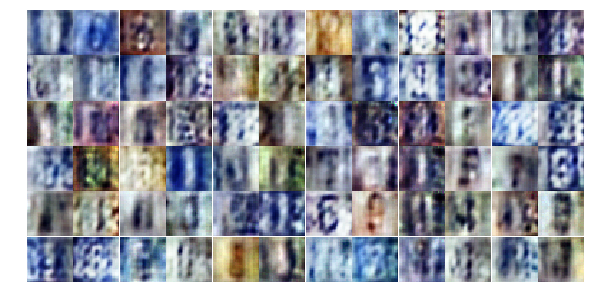

Epoch 5/25... Discriminator Loss: 0.2361... Generator Loss: 4.3701
Epoch 5/25... Discriminator Loss: 0.1198... Generator Loss: 4.6280
Epoch 5/25... Discriminator Loss: 0.1816... Generator Loss: 3.1290
Epoch 5/25... Discriminator Loss: 1.0096... Generator Loss: 0.7128
Epoch 5/25... Discriminator Loss: 0.6895... Generator Loss: 2.8333
Epoch 5/25... Discriminator Loss: 1.2716... Generator Loss: 0.4534
Epoch 5/25... Discriminator Loss: 0.2933... Generator Loss: 2.8017
Epoch 5/25... Discriminator Loss: 0.5033... Generator Loss: 2.9351
Epoch 5/25... Discriminator Loss: 0.2072... Generator Loss: 3.0631
Epoch 5/25... Discriminator Loss: 0.3159... Generator Loss: 2.8418


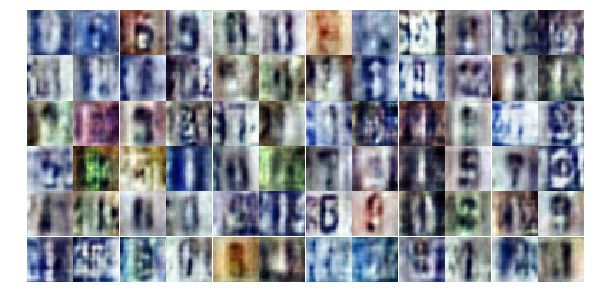

Epoch 5/25... Discriminator Loss: 0.2207... Generator Loss: 3.3376
Epoch 5/25... Discriminator Loss: 0.4622... Generator Loss: 1.3910
Epoch 5/25... Discriminator Loss: 0.5820... Generator Loss: 1.2812
Epoch 5/25... Discriminator Loss: 0.2977... Generator Loss: 2.1884
Epoch 5/25... Discriminator Loss: 0.3385... Generator Loss: 3.6746
Epoch 5/25... Discriminator Loss: 1.2235... Generator Loss: 5.7481
Epoch 5/25... Discriminator Loss: 0.8288... Generator Loss: 1.2911
Epoch 5/25... Discriminator Loss: 0.2793... Generator Loss: 3.8544
Epoch 5/25... Discriminator Loss: 0.4286... Generator Loss: 3.9140
Epoch 5/25... Discriminator Loss: 0.6729... Generator Loss: 1.0122


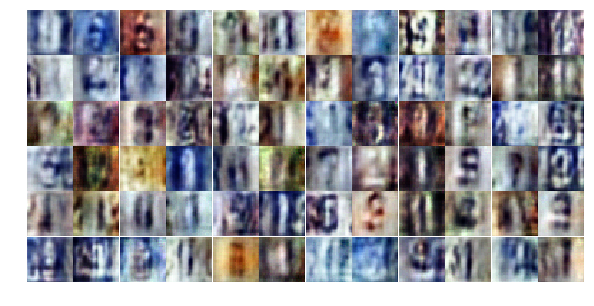

Epoch 5/25... Discriminator Loss: 0.1490... Generator Loss: 3.9064
Epoch 5/25... Discriminator Loss: 0.3282... Generator Loss: 1.7704
Epoch 5/25... Discriminator Loss: 0.1588... Generator Loss: 7.8589
Epoch 5/25... Discriminator Loss: 0.4487... Generator Loss: 1.3627
Epoch 5/25... Discriminator Loss: 0.9453... Generator Loss: 0.9246
Epoch 5/25... Discriminator Loss: 0.7829... Generator Loss: 1.1901
Epoch 6/25... Discriminator Loss: 0.8536... Generator Loss: 1.1832
Epoch 6/25... Discriminator Loss: 0.2904... Generator Loss: 2.2737
Epoch 6/25... Discriminator Loss: 0.5200... Generator Loss: 4.7219
Epoch 6/25... Discriminator Loss: 0.2031... Generator Loss: 3.2160


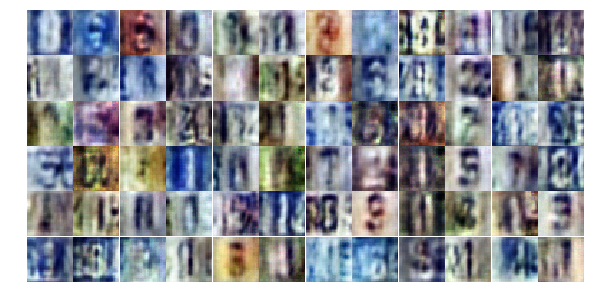

Epoch 6/25... Discriminator Loss: 0.2579... Generator Loss: 3.2902
Epoch 6/25... Discriminator Loss: 1.0536... Generator Loss: 0.7240
Epoch 6/25... Discriminator Loss: 0.8613... Generator Loss: 0.8543
Epoch 6/25... Discriminator Loss: 0.7441... Generator Loss: 0.9019
Epoch 6/25... Discriminator Loss: 0.6028... Generator Loss: 1.0504
Epoch 6/25... Discriminator Loss: 0.3687... Generator Loss: 3.5457
Epoch 6/25... Discriminator Loss: 1.2408... Generator Loss: 0.5122
Epoch 6/25... Discriminator Loss: 0.6962... Generator Loss: 0.9789
Epoch 6/25... Discriminator Loss: 0.7608... Generator Loss: 1.6660
Epoch 6/25... Discriminator Loss: 0.5867... Generator Loss: 3.3510


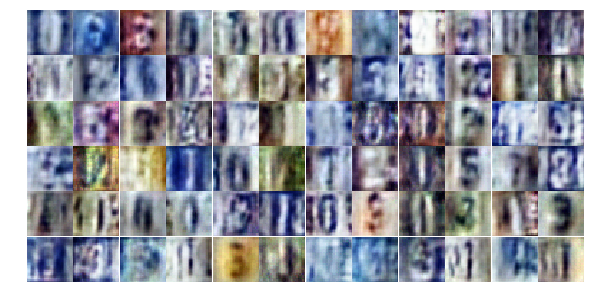

Epoch 6/25... Discriminator Loss: 0.1485... Generator Loss: 3.9992
Epoch 6/25... Discriminator Loss: 1.0184... Generator Loss: 1.3817
Epoch 6/25... Discriminator Loss: 0.4482... Generator Loss: 3.7027
Epoch 6/25... Discriminator Loss: 0.0988... Generator Loss: 4.2476
Epoch 6/25... Discriminator Loss: 0.4664... Generator Loss: 1.7885
Epoch 6/25... Discriminator Loss: 0.1641... Generator Loss: 3.4771
Epoch 6/25... Discriminator Loss: 0.1663... Generator Loss: 2.8914
Epoch 6/25... Discriminator Loss: 0.6461... Generator Loss: 1.7357
Epoch 6/25... Discriminator Loss: 1.0013... Generator Loss: 0.6373
Epoch 6/25... Discriminator Loss: 0.4229... Generator Loss: 1.5051


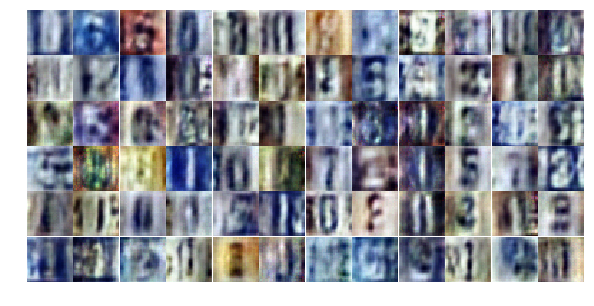

Epoch 6/25... Discriminator Loss: 0.3407... Generator Loss: 2.0707
Epoch 6/25... Discriminator Loss: 1.0314... Generator Loss: 4.6686
Epoch 6/25... Discriminator Loss: 1.2208... Generator Loss: 0.5201
Epoch 6/25... Discriminator Loss: 1.4174... Generator Loss: 0.4472
Epoch 6/25... Discriminator Loss: 0.3576... Generator Loss: 2.8942
Epoch 6/25... Discriminator Loss: 0.2848... Generator Loss: 3.1435
Epoch 6/25... Discriminator Loss: 0.3706... Generator Loss: 2.1058
Epoch 6/25... Discriminator Loss: 0.3582... Generator Loss: 1.6330
Epoch 6/25... Discriminator Loss: 0.1714... Generator Loss: 3.3372
Epoch 6/25... Discriminator Loss: 0.3726... Generator Loss: 3.4493


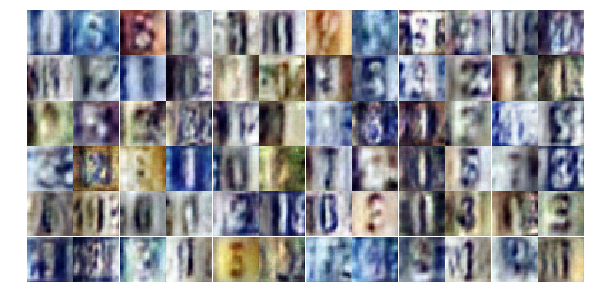

Epoch 6/25... Discriminator Loss: 0.2438... Generator Loss: 2.3084
Epoch 6/25... Discriminator Loss: 0.5449... Generator Loss: 1.3342
Epoch 6/25... Discriminator Loss: 0.2853... Generator Loss: 4.8359
Epoch 6/25... Discriminator Loss: 0.0851... Generator Loss: 3.4771
Epoch 6/25... Discriminator Loss: 0.3234... Generator Loss: 2.0598
Epoch 6/25... Discriminator Loss: 0.5773... Generator Loss: 4.8149
Epoch 6/25... Discriminator Loss: 0.5603... Generator Loss: 1.5268
Epoch 6/25... Discriminator Loss: 0.2389... Generator Loss: 3.1694
Epoch 6/25... Discriminator Loss: 0.2242... Generator Loss: 2.8255
Epoch 6/25... Discriminator Loss: 0.2982... Generator Loss: 2.8989


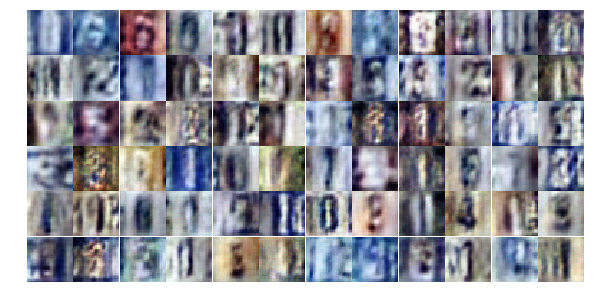

Epoch 6/25... Discriminator Loss: 1.9590... Generator Loss: 0.2813
Epoch 6/25... Discriminator Loss: 0.4810... Generator Loss: 4.7327
Epoch 6/25... Discriminator Loss: 1.2673... Generator Loss: 4.2357
Epoch 6/25... Discriminator Loss: 0.4978... Generator Loss: 2.1664
Epoch 6/25... Discriminator Loss: 0.3558... Generator Loss: 3.4091
Epoch 6/25... Discriminator Loss: 0.2950... Generator Loss: 1.7855
Epoch 6/25... Discriminator Loss: 0.1139... Generator Loss: 3.6115
Epoch 6/25... Discriminator Loss: 1.5054... Generator Loss: 0.3504
Epoch 6/25... Discriminator Loss: 1.0601... Generator Loss: 0.6006
Epoch 6/25... Discriminator Loss: 0.8324... Generator Loss: 0.8016


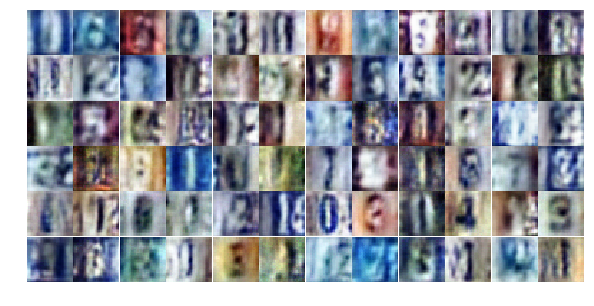

Epoch 6/25... Discriminator Loss: 0.4456... Generator Loss: 1.4238
Epoch 6/25... Discriminator Loss: 0.2229... Generator Loss: 3.5479
Epoch 6/25... Discriminator Loss: 1.6879... Generator Loss: 0.3739
Epoch 7/25... Discriminator Loss: 0.3927... Generator Loss: 2.5309
Epoch 7/25... Discriminator Loss: 0.5327... Generator Loss: 1.1569
Epoch 7/25... Discriminator Loss: 0.4221... Generator Loss: 4.7002
Epoch 7/25... Discriminator Loss: 0.7758... Generator Loss: 1.6631
Epoch 7/25... Discriminator Loss: 0.1831... Generator Loss: 3.0286
Epoch 7/25... Discriminator Loss: 0.3670... Generator Loss: 1.8337
Epoch 7/25... Discriminator Loss: 0.4677... Generator Loss: 1.4690


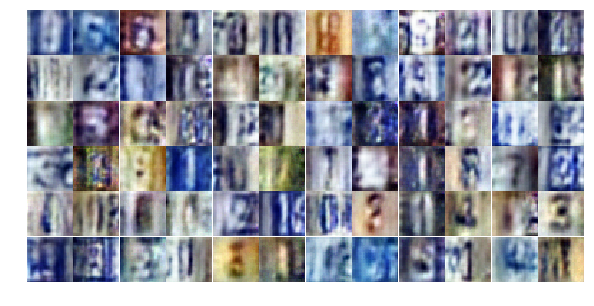

Epoch 7/25... Discriminator Loss: 0.3494... Generator Loss: 2.7760
Epoch 7/25... Discriminator Loss: 0.3579... Generator Loss: 2.3240
Epoch 7/25... Discriminator Loss: 0.3969... Generator Loss: 2.0016
Epoch 7/25... Discriminator Loss: 0.3446... Generator Loss: 1.8430
Epoch 7/25... Discriminator Loss: 0.1975... Generator Loss: 3.1937
Epoch 7/25... Discriminator Loss: 0.2586... Generator Loss: 3.1626
Epoch 7/25... Discriminator Loss: 0.7305... Generator Loss: 0.9528
Epoch 7/25... Discriminator Loss: 0.5562... Generator Loss: 1.1785
Epoch 7/25... Discriminator Loss: 0.6955... Generator Loss: 1.0490
Epoch 7/25... Discriminator Loss: 1.1544... Generator Loss: 0.7860


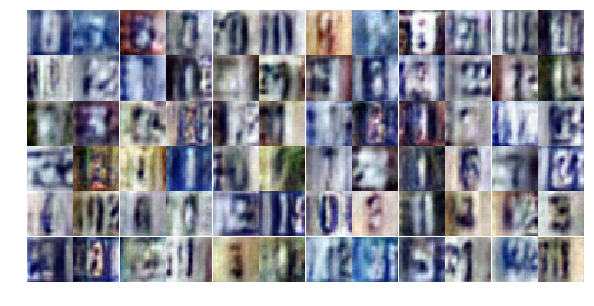

Epoch 7/25... Discriminator Loss: 0.6008... Generator Loss: 1.1580
Epoch 7/25... Discriminator Loss: 1.4965... Generator Loss: 3.0476
Epoch 7/25... Discriminator Loss: 0.3951... Generator Loss: 2.1297
Epoch 7/25... Discriminator Loss: 0.3426... Generator Loss: 2.2667
Epoch 7/25... Discriminator Loss: 0.4343... Generator Loss: 1.6958
Epoch 7/25... Discriminator Loss: 0.2810... Generator Loss: 3.8826
Epoch 7/25... Discriminator Loss: 0.2393... Generator Loss: 3.2752
Epoch 7/25... Discriminator Loss: 2.1152... Generator Loss: 0.2305
Epoch 7/25... Discriminator Loss: 0.5756... Generator Loss: 1.3259
Epoch 7/25... Discriminator Loss: 0.5099... Generator Loss: 2.8715


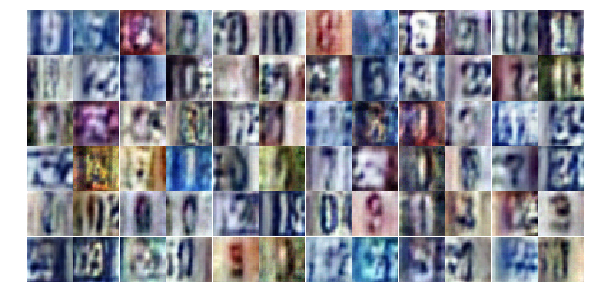

Epoch 7/25... Discriminator Loss: 0.7629... Generator Loss: 0.9416
Epoch 7/25... Discriminator Loss: 0.4716... Generator Loss: 1.4589
Epoch 7/25... Discriminator Loss: 0.2128... Generator Loss: 2.6606
Epoch 7/25... Discriminator Loss: 0.3295... Generator Loss: 1.9353
Epoch 7/25... Discriminator Loss: 0.2369... Generator Loss: 2.4421
Epoch 7/25... Discriminator Loss: 0.8925... Generator Loss: 0.6943
Epoch 7/25... Discriminator Loss: 1.0365... Generator Loss: 0.5757
Epoch 7/25... Discriminator Loss: 0.5220... Generator Loss: 1.3669
Epoch 7/25... Discriminator Loss: 0.7549... Generator Loss: 0.9304
Epoch 7/25... Discriminator Loss: 0.4503... Generator Loss: 3.3977


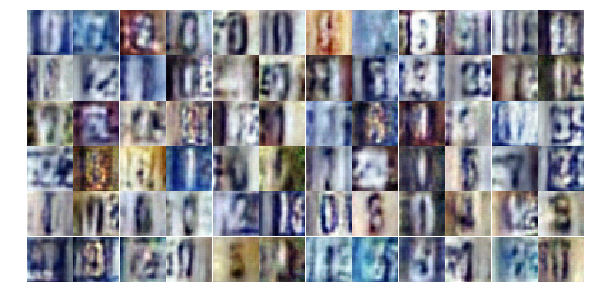

Epoch 7/25... Discriminator Loss: 0.4643... Generator Loss: 2.9420
Epoch 7/25... Discriminator Loss: 0.5007... Generator Loss: 1.5140
Epoch 7/25... Discriminator Loss: 0.1950... Generator Loss: 2.9611
Epoch 7/25... Discriminator Loss: 0.3110... Generator Loss: 3.6198
Epoch 7/25... Discriminator Loss: 0.4973... Generator Loss: 1.2392
Epoch 7/25... Discriminator Loss: 0.1902... Generator Loss: 4.7236
Epoch 7/25... Discriminator Loss: 0.2889... Generator Loss: 2.3287
Epoch 7/25... Discriminator Loss: 0.4284... Generator Loss: 2.7717
Epoch 7/25... Discriminator Loss: 0.2094... Generator Loss: 2.9243
Epoch 7/25... Discriminator Loss: 1.1668... Generator Loss: 0.5503


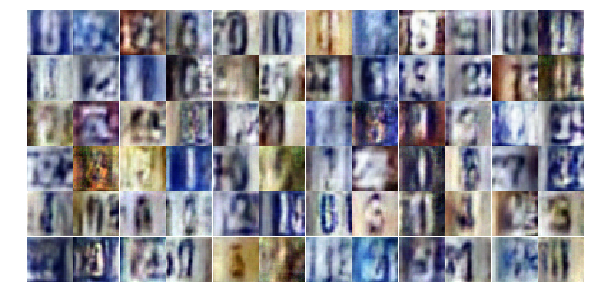

Epoch 7/25... Discriminator Loss: 0.6500... Generator Loss: 1.2543
Epoch 7/25... Discriminator Loss: 1.0137... Generator Loss: 2.3943
Epoch 7/25... Discriminator Loss: 0.5558... Generator Loss: 1.9046
Epoch 7/25... Discriminator Loss: 0.6501... Generator Loss: 1.0471
Epoch 7/25... Discriminator Loss: 0.5502... Generator Loss: 1.4076
Epoch 7/25... Discriminator Loss: 0.2292... Generator Loss: 2.5690
Epoch 7/25... Discriminator Loss: 0.9150... Generator Loss: 0.7252
Epoch 7/25... Discriminator Loss: 0.4772... Generator Loss: 1.8002
Epoch 7/25... Discriminator Loss: 0.2984... Generator Loss: 2.0901
Epoch 7/25... Discriminator Loss: 0.7976... Generator Loss: 0.9697


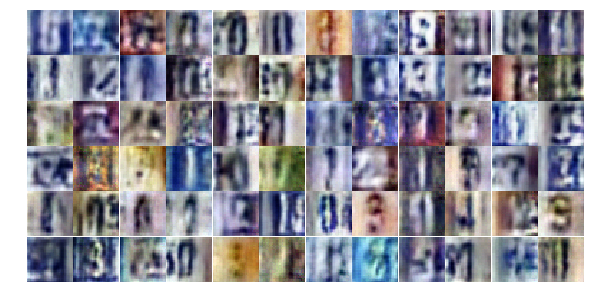

Epoch 7/25... Discriminator Loss: 0.2039... Generator Loss: 2.8847
Epoch 8/25... Discriminator Loss: 0.5365... Generator Loss: 1.6545
Epoch 8/25... Discriminator Loss: 0.8175... Generator Loss: 0.8144
Epoch 8/25... Discriminator Loss: 0.1218... Generator Loss: 3.9651
Epoch 8/25... Discriminator Loss: 0.3456... Generator Loss: 1.7314
Epoch 8/25... Discriminator Loss: 0.3976... Generator Loss: 1.4920
Epoch 8/25... Discriminator Loss: 0.7333... Generator Loss: 0.9878
Epoch 8/25... Discriminator Loss: 1.1695... Generator Loss: 3.2045
Epoch 8/25... Discriminator Loss: 2.0658... Generator Loss: 0.2440
Epoch 8/25... Discriminator Loss: 0.8362... Generator Loss: 0.8703


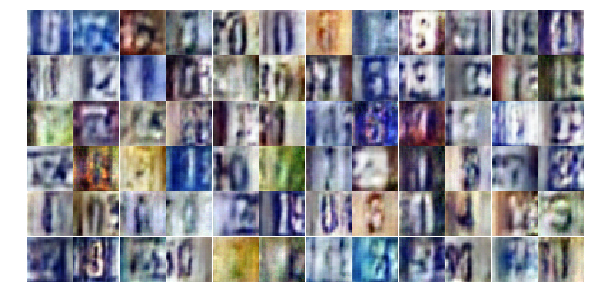

Epoch 8/25... Discriminator Loss: 0.4201... Generator Loss: 2.2800
Epoch 8/25... Discriminator Loss: 0.5442... Generator Loss: 1.3944
Epoch 8/25... Discriminator Loss: 0.3868... Generator Loss: 2.0404
Epoch 8/25... Discriminator Loss: 0.3345... Generator Loss: 1.7694
Epoch 8/25... Discriminator Loss: 0.7289... Generator Loss: 0.9389
Epoch 8/25... Discriminator Loss: 0.9174... Generator Loss: 0.7217
Epoch 8/25... Discriminator Loss: 0.2364... Generator Loss: 2.6229
Epoch 8/25... Discriminator Loss: 0.2575... Generator Loss: 2.6425
Epoch 8/25... Discriminator Loss: 0.4542... Generator Loss: 1.2655
Epoch 8/25... Discriminator Loss: 1.7922... Generator Loss: 0.2555


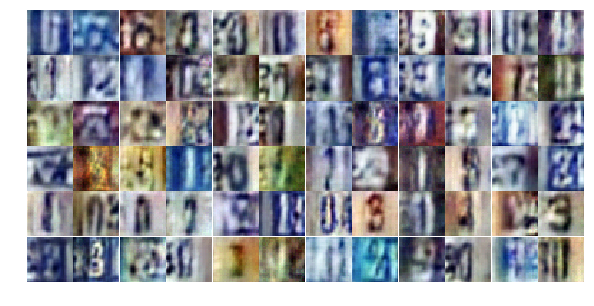

Epoch 8/25... Discriminator Loss: 0.3167... Generator Loss: 2.3990
Epoch 8/25... Discriminator Loss: 0.4293... Generator Loss: 1.5274
Epoch 8/25... Discriminator Loss: 0.9447... Generator Loss: 0.6471
Epoch 8/25... Discriminator Loss: 0.7002... Generator Loss: 1.1519
Epoch 8/25... Discriminator Loss: 0.3879... Generator Loss: 1.6749
Epoch 8/25... Discriminator Loss: 0.8219... Generator Loss: 0.8954
Epoch 8/25... Discriminator Loss: 0.4299... Generator Loss: 2.4012
Epoch 8/25... Discriminator Loss: 0.3786... Generator Loss: 1.8603
Epoch 8/25... Discriminator Loss: 0.4107... Generator Loss: 1.8597
Epoch 8/25... Discriminator Loss: 0.4713... Generator Loss: 1.8302


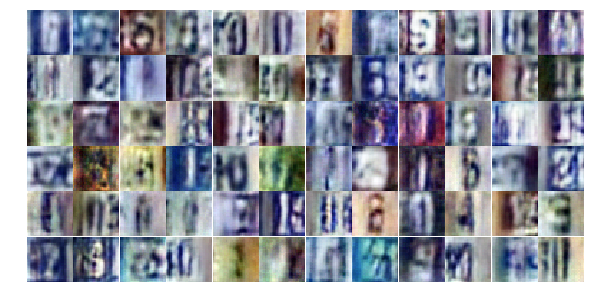

Epoch 8/25... Discriminator Loss: 0.4228... Generator Loss: 1.4729
Epoch 8/25... Discriminator Loss: 0.8343... Generator Loss: 0.7468
Epoch 8/25... Discriminator Loss: 0.3865... Generator Loss: 2.0584
Epoch 8/25... Discriminator Loss: 0.5899... Generator Loss: 1.1454
Epoch 8/25... Discriminator Loss: 0.2808... Generator Loss: 2.8498
Epoch 8/25... Discriminator Loss: 0.4454... Generator Loss: 1.5536
Epoch 8/25... Discriminator Loss: 0.2681... Generator Loss: 2.3297
Epoch 8/25... Discriminator Loss: 0.3620... Generator Loss: 2.3400
Epoch 8/25... Discriminator Loss: 0.9215... Generator Loss: 0.6792
Epoch 8/25... Discriminator Loss: 0.1949... Generator Loss: 3.1021


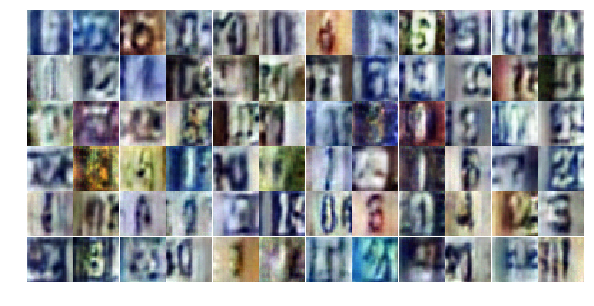

Epoch 8/25... Discriminator Loss: 0.1692... Generator Loss: 3.0283
Epoch 8/25... Discriminator Loss: 0.5288... Generator Loss: 1.8200
Epoch 8/25... Discriminator Loss: 1.5262... Generator Loss: 4.8914
Epoch 8/25... Discriminator Loss: 1.5806... Generator Loss: 0.4809
Epoch 8/25... Discriminator Loss: 1.3666... Generator Loss: 2.2812
Epoch 8/25... Discriminator Loss: 1.2420... Generator Loss: 0.5277
Epoch 8/25... Discriminator Loss: 0.7162... Generator Loss: 1.0626
Epoch 8/25... Discriminator Loss: 1.1928... Generator Loss: 0.5773
Epoch 8/25... Discriminator Loss: 0.9952... Generator Loss: 0.7856
Epoch 8/25... Discriminator Loss: 0.5762... Generator Loss: 1.4042


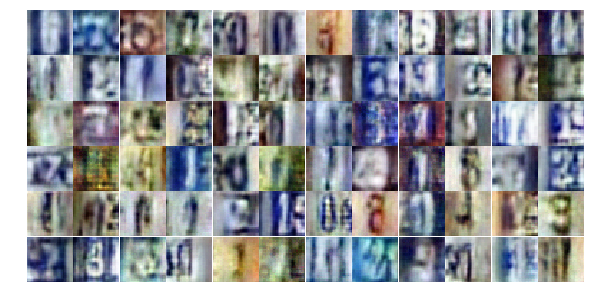

Epoch 8/25... Discriminator Loss: 0.7416... Generator Loss: 1.4958
Epoch 8/25... Discriminator Loss: 0.5307... Generator Loss: 1.5059
Epoch 8/25... Discriminator Loss: 0.4592... Generator Loss: 1.7731
Epoch 8/25... Discriminator Loss: 0.6720... Generator Loss: 1.0169
Epoch 8/25... Discriminator Loss: 0.3556... Generator Loss: 1.7475
Epoch 8/25... Discriminator Loss: 0.5705... Generator Loss: 1.4205
Epoch 8/25... Discriminator Loss: 0.5346... Generator Loss: 1.2841
Epoch 8/25... Discriminator Loss: 0.5216... Generator Loss: 1.3341
Epoch 9/25... Discriminator Loss: 0.6068... Generator Loss: 1.5679
Epoch 9/25... Discriminator Loss: 0.9099... Generator Loss: 0.6645


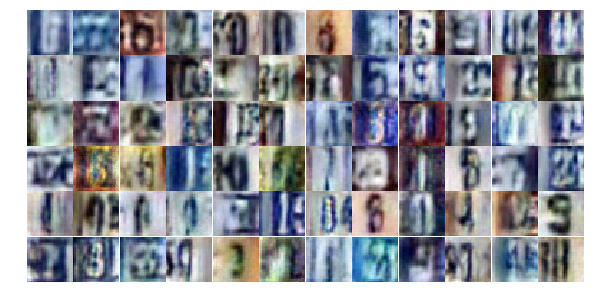

Epoch 9/25... Discriminator Loss: 0.9777... Generator Loss: 2.0483
Epoch 9/25... Discriminator Loss: 0.4806... Generator Loss: 1.9062
Epoch 9/25... Discriminator Loss: 0.6814... Generator Loss: 1.0996
Epoch 9/25... Discriminator Loss: 0.3174... Generator Loss: 1.8442
Epoch 9/25... Discriminator Loss: 0.5998... Generator Loss: 1.5523
Epoch 9/25... Discriminator Loss: 0.3741... Generator Loss: 2.0474
Epoch 9/25... Discriminator Loss: 0.4122... Generator Loss: 1.8593
Epoch 9/25... Discriminator Loss: 0.5082... Generator Loss: 1.3111
Epoch 9/25... Discriminator Loss: 0.4134... Generator Loss: 2.0308
Epoch 9/25... Discriminator Loss: 0.5153... Generator Loss: 1.3762


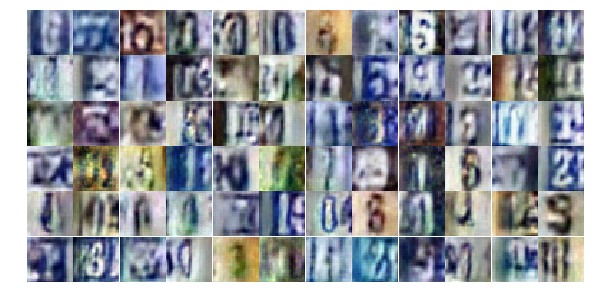

Epoch 9/25... Discriminator Loss: 0.3452... Generator Loss: 2.2806
Epoch 9/25... Discriminator Loss: 0.3673... Generator Loss: 1.6299
Epoch 9/25... Discriminator Loss: 1.1090... Generator Loss: 2.1887
Epoch 9/25... Discriminator Loss: 0.8454... Generator Loss: 0.8276
Epoch 9/25... Discriminator Loss: 0.9400... Generator Loss: 0.6540
Epoch 9/25... Discriminator Loss: 0.5304... Generator Loss: 1.3514
Epoch 9/25... Discriminator Loss: 0.8992... Generator Loss: 0.6979
Epoch 9/25... Discriminator Loss: 0.3876... Generator Loss: 1.7271
Epoch 9/25... Discriminator Loss: 0.7709... Generator Loss: 0.9026
Epoch 9/25... Discriminator Loss: 0.3867... Generator Loss: 1.6018


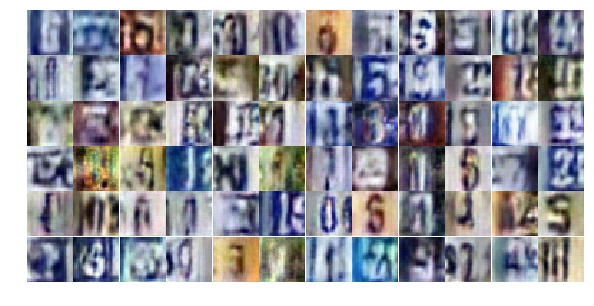

Epoch 9/25... Discriminator Loss: 0.5095... Generator Loss: 1.7720
Epoch 9/25... Discriminator Loss: 1.0482... Generator Loss: 0.7136
Epoch 9/25... Discriminator Loss: 0.6922... Generator Loss: 0.9716
Epoch 9/25... Discriminator Loss: 0.6426... Generator Loss: 1.2495
Epoch 9/25... Discriminator Loss: 0.3310... Generator Loss: 3.2419
Epoch 9/25... Discriminator Loss: 0.5579... Generator Loss: 2.1542
Epoch 9/25... Discriminator Loss: 0.9318... Generator Loss: 0.6521
Epoch 9/25... Discriminator Loss: 1.9948... Generator Loss: 3.9097
Epoch 9/25... Discriminator Loss: 0.6001... Generator Loss: 1.5449
Epoch 9/25... Discriminator Loss: 0.3281... Generator Loss: 2.5878


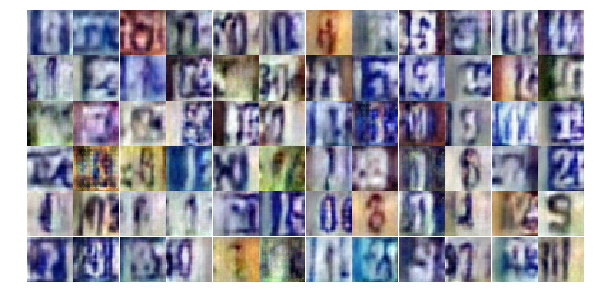

Epoch 9/25... Discriminator Loss: 0.5900... Generator Loss: 1.1977
Epoch 9/25... Discriminator Loss: 1.6984... Generator Loss: 0.2981
Epoch 9/25... Discriminator Loss: 0.9610... Generator Loss: 0.6729
Epoch 9/25... Discriminator Loss: 0.7620... Generator Loss: 0.9142
Epoch 9/25... Discriminator Loss: 0.5823... Generator Loss: 2.3400
Epoch 9/25... Discriminator Loss: 0.6375... Generator Loss: 0.9947
Epoch 9/25... Discriminator Loss: 0.3618... Generator Loss: 2.5937
Epoch 9/25... Discriminator Loss: 0.2472... Generator Loss: 2.3670
Epoch 9/25... Discriminator Loss: 1.2136... Generator Loss: 0.5165
Epoch 9/25... Discriminator Loss: 0.8467... Generator Loss: 0.8217


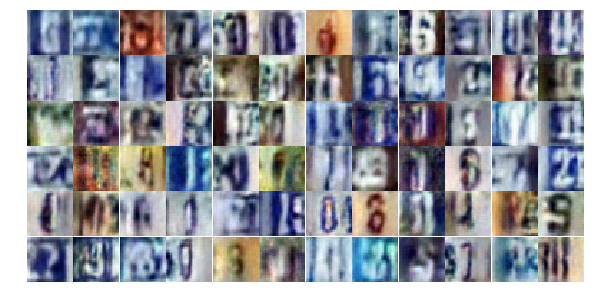

Epoch 9/25... Discriminator Loss: 0.8879... Generator Loss: 3.0615
Epoch 9/25... Discriminator Loss: 0.7415... Generator Loss: 0.9538
Epoch 9/25... Discriminator Loss: 0.7510... Generator Loss: 1.4312
Epoch 9/25... Discriminator Loss: 0.8707... Generator Loss: 2.7742
Epoch 9/25... Discriminator Loss: 0.7589... Generator Loss: 2.9009
Epoch 9/25... Discriminator Loss: 0.8771... Generator Loss: 0.7735
Epoch 9/25... Discriminator Loss: 1.3691... Generator Loss: 0.4207
Epoch 9/25... Discriminator Loss: 0.5837... Generator Loss: 1.7208
Epoch 9/25... Discriminator Loss: 0.4117... Generator Loss: 1.3894
Epoch 9/25... Discriminator Loss: 0.3986... Generator Loss: 2.2044


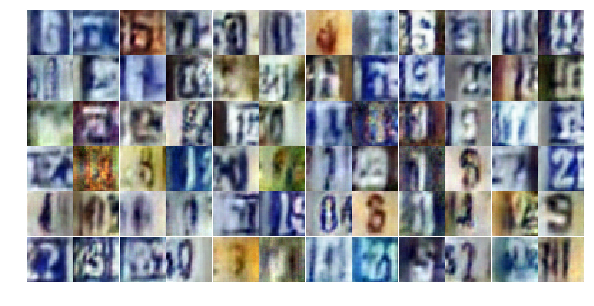

Epoch 9/25... Discriminator Loss: 0.7931... Generator Loss: 0.8029
Epoch 9/25... Discriminator Loss: 2.0067... Generator Loss: 3.8978
Epoch 9/25... Discriminator Loss: 1.0758... Generator Loss: 0.7320
Epoch 9/25... Discriminator Loss: 1.3755... Generator Loss: 0.4309
Epoch 9/25... Discriminator Loss: 0.5818... Generator Loss: 1.2744
Epoch 10/25... Discriminator Loss: 0.5452... Generator Loss: 1.2081
Epoch 10/25... Discriminator Loss: 0.4488... Generator Loss: 1.4148
Epoch 10/25... Discriminator Loss: 0.4902... Generator Loss: 1.5291
Epoch 10/25... Discriminator Loss: 0.7819... Generator Loss: 1.0651
Epoch 10/25... Discriminator Loss: 1.0139... Generator Loss: 0.5769


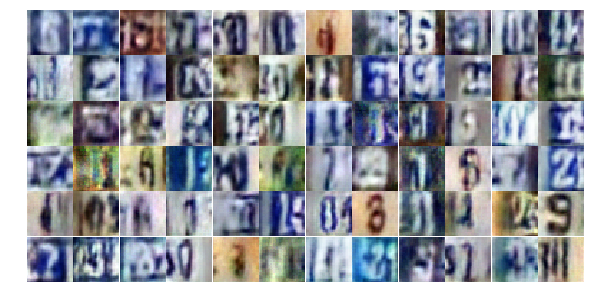

Epoch 10/25... Discriminator Loss: 0.8017... Generator Loss: 0.8258
Epoch 10/25... Discriminator Loss: 0.4288... Generator Loss: 1.8651
Epoch 10/25... Discriminator Loss: 0.4879... Generator Loss: 1.5790
Epoch 10/25... Discriminator Loss: 0.6107... Generator Loss: 1.8967
Epoch 10/25... Discriminator Loss: 0.5218... Generator Loss: 1.9928
Epoch 10/25... Discriminator Loss: 0.8329... Generator Loss: 0.8467
Epoch 10/25... Discriminator Loss: 0.4827... Generator Loss: 1.3402
Epoch 10/25... Discriminator Loss: 0.9893... Generator Loss: 0.6424
Epoch 10/25... Discriminator Loss: 2.4018... Generator Loss: 0.1666
Epoch 10/25... Discriminator Loss: 0.6046... Generator Loss: 1.9058


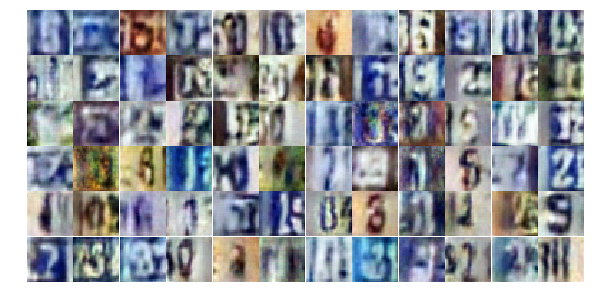

Epoch 10/25... Discriminator Loss: 0.9457... Generator Loss: 0.7623
Epoch 10/25... Discriminator Loss: 0.8512... Generator Loss: 0.7552
Epoch 10/25... Discriminator Loss: 0.5799... Generator Loss: 1.1678
Epoch 10/25... Discriminator Loss: 0.8472... Generator Loss: 0.7708
Epoch 10/25... Discriminator Loss: 0.7256... Generator Loss: 0.9138
Epoch 10/25... Discriminator Loss: 0.3946... Generator Loss: 1.7567
Epoch 10/25... Discriminator Loss: 0.5102... Generator Loss: 1.3693
Epoch 10/25... Discriminator Loss: 0.4215... Generator Loss: 2.1199
Epoch 10/25... Discriminator Loss: 0.6124... Generator Loss: 1.0774
Epoch 10/25... Discriminator Loss: 0.3874... Generator Loss: 2.2067


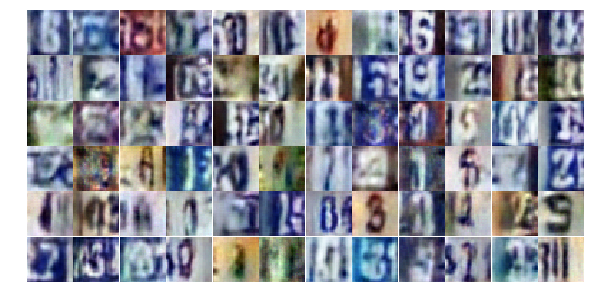

Epoch 10/25... Discriminator Loss: 0.9410... Generator Loss: 0.6513
Epoch 10/25... Discriminator Loss: 0.6111... Generator Loss: 1.1648
Epoch 10/25... Discriminator Loss: 0.2147... Generator Loss: 2.5996
Epoch 10/25... Discriminator Loss: 0.5031... Generator Loss: 1.3515
Epoch 10/25... Discriminator Loss: 0.4758... Generator Loss: 1.4163
Epoch 10/25... Discriminator Loss: 0.4424... Generator Loss: 1.6398
Epoch 10/25... Discriminator Loss: 0.2621... Generator Loss: 2.5328
Epoch 10/25... Discriminator Loss: 0.4468... Generator Loss: 2.0793
Epoch 10/25... Discriminator Loss: 1.3633... Generator Loss: 4.4212
Epoch 10/25... Discriminator Loss: 1.0771... Generator Loss: 0.9103


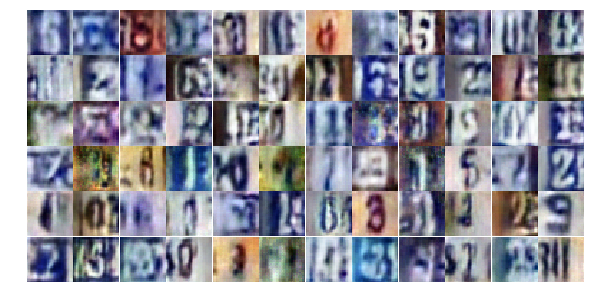

Epoch 10/25... Discriminator Loss: 0.6463... Generator Loss: 2.0247
Epoch 10/25... Discriminator Loss: 0.7455... Generator Loss: 0.8821
Epoch 10/25... Discriminator Loss: 0.2652... Generator Loss: 2.3936
Epoch 10/25... Discriminator Loss: 0.5698... Generator Loss: 1.2378
Epoch 10/25... Discriminator Loss: 0.7702... Generator Loss: 0.8679
Epoch 10/25... Discriminator Loss: 0.6774... Generator Loss: 1.1958
Epoch 10/25... Discriminator Loss: 0.5819... Generator Loss: 1.1824
Epoch 10/25... Discriminator Loss: 0.2506... Generator Loss: 2.1351
Epoch 10/25... Discriminator Loss: 0.4277... Generator Loss: 1.3651
Epoch 10/25... Discriminator Loss: 0.9300... Generator Loss: 3.4556


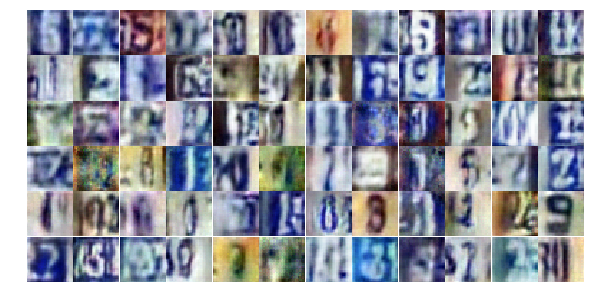

Epoch 10/25... Discriminator Loss: 1.0743... Generator Loss: 0.6072
Epoch 10/25... Discriminator Loss: 2.0559... Generator Loss: 0.1913
Epoch 10/25... Discriminator Loss: 0.8128... Generator Loss: 0.8806
Epoch 10/25... Discriminator Loss: 0.3482... Generator Loss: 1.9858
Epoch 10/25... Discriminator Loss: 0.4530... Generator Loss: 2.0284
Epoch 10/25... Discriminator Loss: 0.5113... Generator Loss: 2.0218
Epoch 10/25... Discriminator Loss: 0.5148... Generator Loss: 1.3592
Epoch 10/25... Discriminator Loss: 0.5158... Generator Loss: 1.3430
Epoch 10/25... Discriminator Loss: 0.2609... Generator Loss: 2.1698
Epoch 10/25... Discriminator Loss: 0.4727... Generator Loss: 1.3132


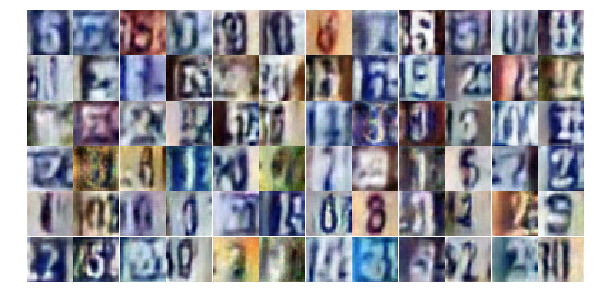

Epoch 10/25... Discriminator Loss: 0.7145... Generator Loss: 1.1092
Epoch 10/25... Discriminator Loss: 0.6129... Generator Loss: 1.0723
Epoch 10/25... Discriminator Loss: 0.3988... Generator Loss: 1.5850
Epoch 11/25... Discriminator Loss: 0.7996... Generator Loss: 0.7961
Epoch 11/25... Discriminator Loss: 0.4027... Generator Loss: 1.6061
Epoch 11/25... Discriminator Loss: 1.1686... Generator Loss: 0.4696
Epoch 11/25... Discriminator Loss: 0.5075... Generator Loss: 1.4190
Epoch 11/25... Discriminator Loss: 0.2828... Generator Loss: 2.2276
Epoch 11/25... Discriminator Loss: 0.4395... Generator Loss: 2.1798
Epoch 11/25... Discriminator Loss: 0.7009... Generator Loss: 0.9513


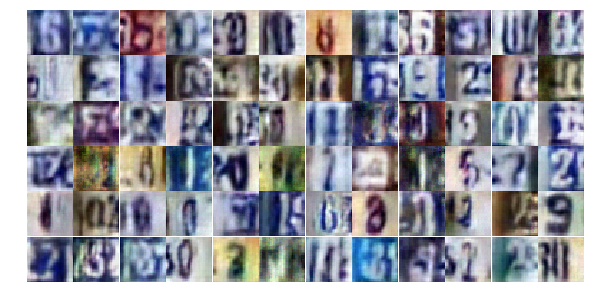

Epoch 11/25... Discriminator Loss: 0.3968... Generator Loss: 6.2760
Epoch 11/25... Discriminator Loss: 1.1032... Generator Loss: 2.3431
Epoch 11/25... Discriminator Loss: 0.2460... Generator Loss: 2.0981
Epoch 11/25... Discriminator Loss: 0.6088... Generator Loss: 1.1267
Epoch 11/25... Discriminator Loss: 0.6053... Generator Loss: 3.6738
Epoch 11/25... Discriminator Loss: 0.2580... Generator Loss: 2.5698
Epoch 11/25... Discriminator Loss: 0.3879... Generator Loss: 1.6791
Epoch 11/25... Discriminator Loss: 0.4647... Generator Loss: 1.5011
Epoch 11/25... Discriminator Loss: 0.6087... Generator Loss: 1.0224
Epoch 11/25... Discriminator Loss: 0.7697... Generator Loss: 0.9664


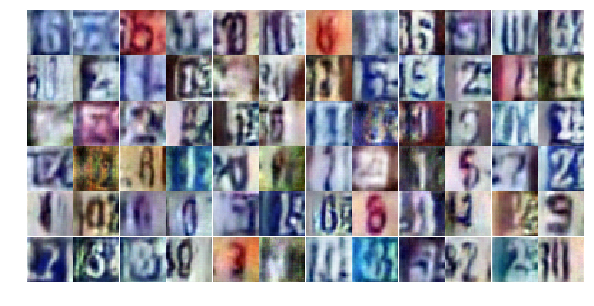

Epoch 11/25... Discriminator Loss: 0.2404... Generator Loss: 2.4612
Epoch 11/25... Discriminator Loss: 1.4796... Generator Loss: 0.3895
Epoch 11/25... Discriminator Loss: 1.3919... Generator Loss: 0.3895
Epoch 11/25... Discriminator Loss: 0.5565... Generator Loss: 1.3077
Epoch 11/25... Discriminator Loss: 0.3903... Generator Loss: 1.7992
Epoch 11/25... Discriminator Loss: 0.3149... Generator Loss: 2.1375
Epoch 11/25... Discriminator Loss: 0.6821... Generator Loss: 1.0806
Epoch 11/25... Discriminator Loss: 0.6854... Generator Loss: 0.9407
Epoch 11/25... Discriminator Loss: 0.5519... Generator Loss: 1.0805
Epoch 11/25... Discriminator Loss: 0.7177... Generator Loss: 0.9186


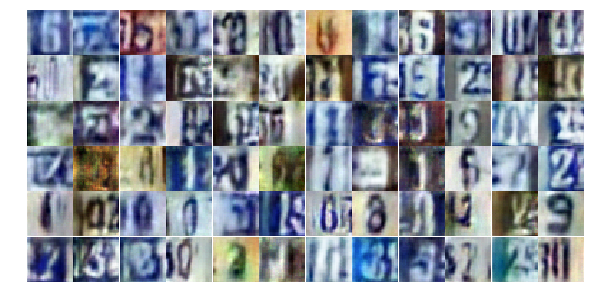

Epoch 11/25... Discriminator Loss: 2.0662... Generator Loss: 0.2149
Epoch 11/25... Discriminator Loss: 1.0524... Generator Loss: 0.9164
Epoch 11/25... Discriminator Loss: 0.4276... Generator Loss: 1.6752
Epoch 11/25... Discriminator Loss: 0.5294... Generator Loss: 1.6961
Epoch 11/25... Discriminator Loss: 0.2312... Generator Loss: 3.0115
Epoch 11/25... Discriminator Loss: 0.9720... Generator Loss: 0.6933
Epoch 11/25... Discriminator Loss: 1.4639... Generator Loss: 0.3783
Epoch 11/25... Discriminator Loss: 0.4819... Generator Loss: 1.3270
Epoch 11/25... Discriminator Loss: 1.0321... Generator Loss: 0.5729
Epoch 11/25... Discriminator Loss: 0.4893... Generator Loss: 1.2288


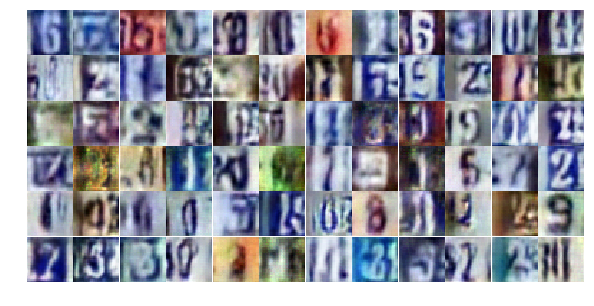

Epoch 11/25... Discriminator Loss: 0.4776... Generator Loss: 1.8100
Epoch 11/25... Discriminator Loss: 0.3920... Generator Loss: 1.6540
Epoch 11/25... Discriminator Loss: 0.5869... Generator Loss: 1.2054
Epoch 11/25... Discriminator Loss: 0.5666... Generator Loss: 1.7332
Epoch 11/25... Discriminator Loss: 0.6526... Generator Loss: 1.0058
Epoch 11/25... Discriminator Loss: 0.5928... Generator Loss: 1.2090
Epoch 11/25... Discriminator Loss: 1.0190... Generator Loss: 1.1438
Epoch 11/25... Discriminator Loss: 0.6855... Generator Loss: 2.6568
Epoch 11/25... Discriminator Loss: 1.6784... Generator Loss: 0.4605
Epoch 11/25... Discriminator Loss: 0.7794... Generator Loss: 0.8810


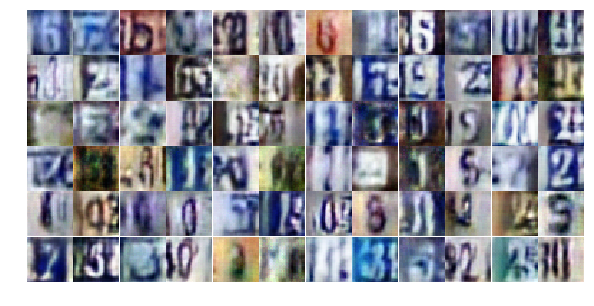

Epoch 11/25... Discriminator Loss: 0.6422... Generator Loss: 1.1765
Epoch 11/25... Discriminator Loss: 0.4177... Generator Loss: 1.5513
Epoch 11/25... Discriminator Loss: 0.8827... Generator Loss: 0.7806
Epoch 11/25... Discriminator Loss: 0.8693... Generator Loss: 0.7203
Epoch 11/25... Discriminator Loss: 0.6852... Generator Loss: 1.0359
Epoch 11/25... Discriminator Loss: 0.5694... Generator Loss: 1.1998
Epoch 11/25... Discriminator Loss: 1.3327... Generator Loss: 0.4491
Epoch 11/25... Discriminator Loss: 0.3902... Generator Loss: 2.7519
Epoch 11/25... Discriminator Loss: 2.3541... Generator Loss: 0.1505
Epoch 11/25... Discriminator Loss: 0.4905... Generator Loss: 1.8298


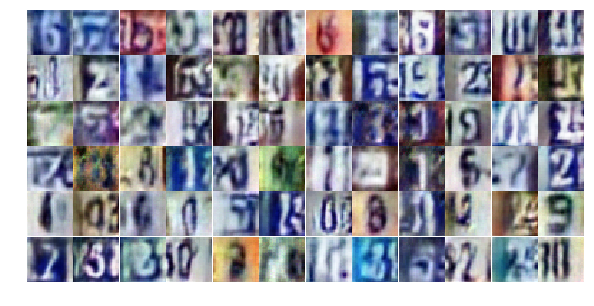

Epoch 12/25... Discriminator Loss: 0.4479... Generator Loss: 1.8201
Epoch 12/25... Discriminator Loss: 0.3734... Generator Loss: 3.3643
Epoch 12/25... Discriminator Loss: 2.1534... Generator Loss: 0.1586
Epoch 12/25... Discriminator Loss: 0.6657... Generator Loss: 1.1520
Epoch 12/25... Discriminator Loss: 0.6450... Generator Loss: 1.0476
Epoch 12/25... Discriminator Loss: 0.9209... Generator Loss: 0.6726
Epoch 12/25... Discriminator Loss: 0.4979... Generator Loss: 2.2371
Epoch 12/25... Discriminator Loss: 0.8486... Generator Loss: 0.7669
Epoch 12/25... Discriminator Loss: 0.4509... Generator Loss: 2.7094
Epoch 12/25... Discriminator Loss: 1.5570... Generator Loss: 0.3081


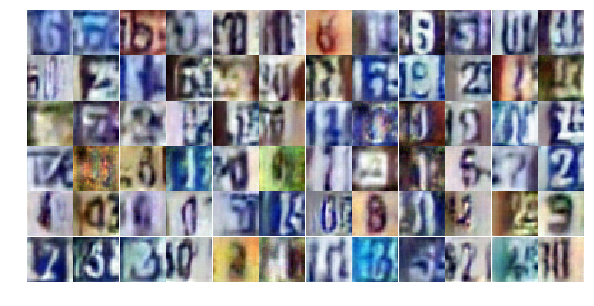

Epoch 12/25... Discriminator Loss: 0.3655... Generator Loss: 1.5697
Epoch 12/25... Discriminator Loss: 0.5393... Generator Loss: 1.9725
Epoch 12/25... Discriminator Loss: 0.5101... Generator Loss: 1.6427
Epoch 12/25... Discriminator Loss: 0.6537... Generator Loss: 1.4937
Epoch 12/25... Discriminator Loss: 0.3970... Generator Loss: 1.8903
Epoch 12/25... Discriminator Loss: 1.2633... Generator Loss: 1.9618
Epoch 12/25... Discriminator Loss: 0.6634... Generator Loss: 1.0695
Epoch 12/25... Discriminator Loss: 0.3697... Generator Loss: 1.6568
Epoch 12/25... Discriminator Loss: 0.6893... Generator Loss: 2.0324
Epoch 12/25... Discriminator Loss: 0.7495... Generator Loss: 0.8813


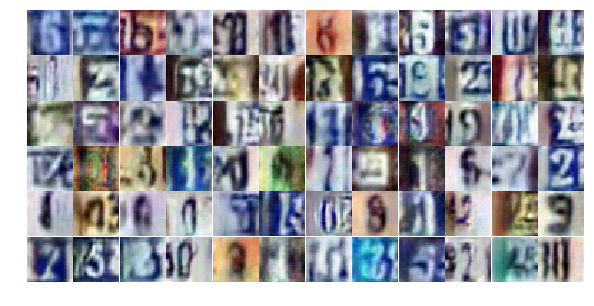

Epoch 12/25... Discriminator Loss: 0.4262... Generator Loss: 1.4349
Epoch 12/25... Discriminator Loss: 0.5072... Generator Loss: 1.3033
Epoch 12/25... Discriminator Loss: 0.4385... Generator Loss: 1.5205
Epoch 12/25... Discriminator Loss: 0.5241... Generator Loss: 1.5764
Epoch 12/25... Discriminator Loss: 0.3654... Generator Loss: 1.6573
Epoch 12/25... Discriminator Loss: 0.3303... Generator Loss: 1.7529
Epoch 12/25... Discriminator Loss: 0.6205... Generator Loss: 1.1348
Epoch 12/25... Discriminator Loss: 0.3271... Generator Loss: 2.1158
Epoch 12/25... Discriminator Loss: 0.5895... Generator Loss: 1.7452
Epoch 12/25... Discriminator Loss: 0.7570... Generator Loss: 0.9793


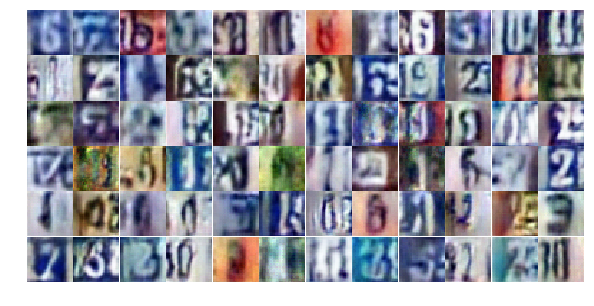

Epoch 12/25... Discriminator Loss: 0.6156... Generator Loss: 1.1142
Epoch 12/25... Discriminator Loss: 1.2840... Generator Loss: 0.4110
Epoch 12/25... Discriminator Loss: 0.5896... Generator Loss: 1.2982
Epoch 12/25... Discriminator Loss: 0.9568... Generator Loss: 0.6633
Epoch 12/25... Discriminator Loss: 0.3855... Generator Loss: 2.3748
Epoch 12/25... Discriminator Loss: 1.0028... Generator Loss: 0.6636
Epoch 12/25... Discriminator Loss: 0.8407... Generator Loss: 0.7884
Epoch 12/25... Discriminator Loss: 0.7102... Generator Loss: 1.0165
Epoch 12/25... Discriminator Loss: 0.1745... Generator Loss: 3.3257
Epoch 12/25... Discriminator Loss: 0.3461... Generator Loss: 1.6400


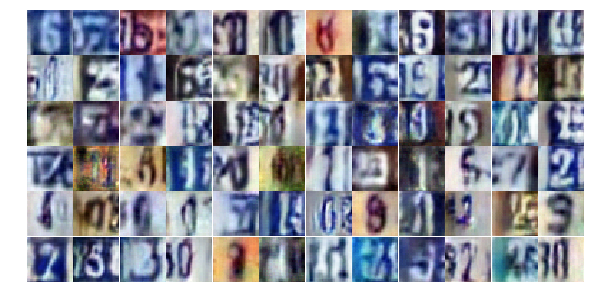

Epoch 12/25... Discriminator Loss: 0.2908... Generator Loss: 2.4914
Epoch 12/25... Discriminator Loss: 0.2808... Generator Loss: 1.9833
Epoch 12/25... Discriminator Loss: 0.1598... Generator Loss: 2.9507
Epoch 12/25... Discriminator Loss: 0.4153... Generator Loss: 1.6987
Epoch 12/25... Discriminator Loss: 0.8306... Generator Loss: 0.7996
Epoch 12/25... Discriminator Loss: 0.6222... Generator Loss: 4.2447
Epoch 12/25... Discriminator Loss: 1.1772... Generator Loss: 0.5237
Epoch 12/25... Discriminator Loss: 1.0211... Generator Loss: 0.6833
Epoch 12/25... Discriminator Loss: 0.2423... Generator Loss: 3.1518
Epoch 12/25... Discriminator Loss: 0.5626... Generator Loss: 1.7581


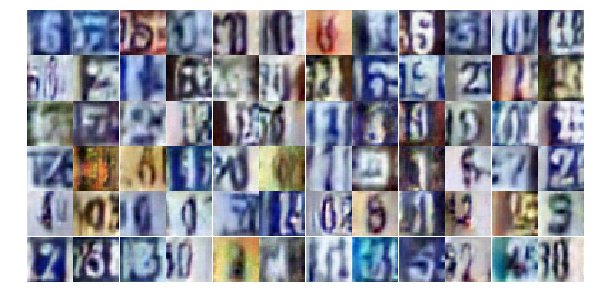

Epoch 12/25... Discriminator Loss: 1.0249... Generator Loss: 0.6339
Epoch 12/25... Discriminator Loss: 0.8987... Generator Loss: 0.7192
Epoch 12/25... Discriminator Loss: 0.6115... Generator Loss: 1.9415
Epoch 12/25... Discriminator Loss: 1.3656... Generator Loss: 0.3693
Epoch 12/25... Discriminator Loss: 0.5381... Generator Loss: 1.2653
Epoch 12/25... Discriminator Loss: 0.7813... Generator Loss: 3.0879
Epoch 12/25... Discriminator Loss: 0.9116... Generator Loss: 0.7416
Epoch 13/25... Discriminator Loss: 0.4760... Generator Loss: 1.4920
Epoch 13/25... Discriminator Loss: 0.1166... Generator Loss: 3.8076
Epoch 13/25... Discriminator Loss: 1.5648... Generator Loss: 0.3179


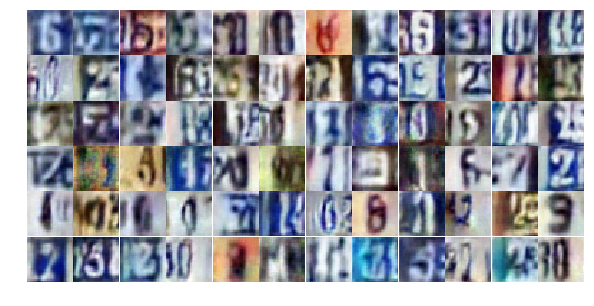

Epoch 13/25... Discriminator Loss: 0.3267... Generator Loss: 2.6784
Epoch 13/25... Discriminator Loss: 0.4744... Generator Loss: 1.6435
Epoch 13/25... Discriminator Loss: 0.7382... Generator Loss: 1.0672
Epoch 13/25... Discriminator Loss: 0.8085... Generator Loss: 0.9517
Epoch 13/25... Discriminator Loss: 0.6832... Generator Loss: 1.9184
Epoch 13/25... Discriminator Loss: 0.2602... Generator Loss: 2.4997
Epoch 13/25... Discriminator Loss: 0.2062... Generator Loss: 3.4414
Epoch 13/25... Discriminator Loss: 0.4618... Generator Loss: 1.5047
Epoch 13/25... Discriminator Loss: 0.5284... Generator Loss: 1.2249
Epoch 13/25... Discriminator Loss: 0.4699... Generator Loss: 1.2432


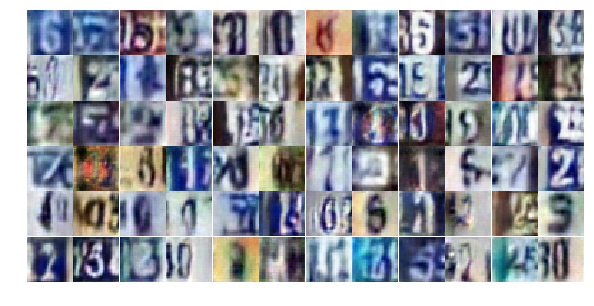

Epoch 13/25... Discriminator Loss: 0.5770... Generator Loss: 3.0132
Epoch 13/25... Discriminator Loss: 0.4612... Generator Loss: 1.4320
Epoch 13/25... Discriminator Loss: 1.1747... Generator Loss: 1.9486
Epoch 13/25... Discriminator Loss: 0.6966... Generator Loss: 1.9157
Epoch 13/25... Discriminator Loss: 1.0437... Generator Loss: 0.5827
Epoch 13/25... Discriminator Loss: 0.7832... Generator Loss: 0.8762
Epoch 13/25... Discriminator Loss: 0.6514... Generator Loss: 1.4288
Epoch 13/25... Discriminator Loss: 0.9562... Generator Loss: 0.6438
Epoch 13/25... Discriminator Loss: 0.5763... Generator Loss: 1.1605
Epoch 13/25... Discriminator Loss: 1.1466... Generator Loss: 0.5186


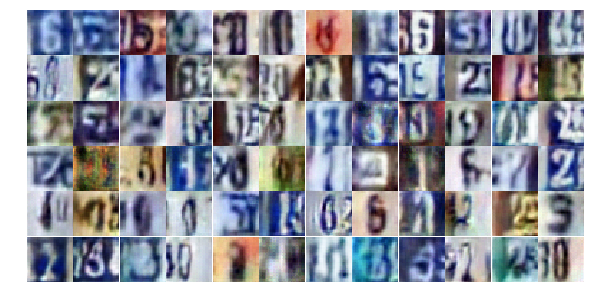

Epoch 13/25... Discriminator Loss: 1.0170... Generator Loss: 0.6142
Epoch 13/25... Discriminator Loss: 0.4358... Generator Loss: 1.8195
Epoch 13/25... Discriminator Loss: 0.3927... Generator Loss: 2.6059
Epoch 13/25... Discriminator Loss: 0.6804... Generator Loss: 1.0856
Epoch 13/25... Discriminator Loss: 0.3009... Generator Loss: 1.9466
Epoch 13/25... Discriminator Loss: 0.7982... Generator Loss: 0.8032
Epoch 13/25... Discriminator Loss: 0.9514... Generator Loss: 3.8881
Epoch 13/25... Discriminator Loss: 0.6785... Generator Loss: 1.6011
Epoch 13/25... Discriminator Loss: 0.1459... Generator Loss: 3.1784
Epoch 13/25... Discriminator Loss: 0.4574... Generator Loss: 3.2717


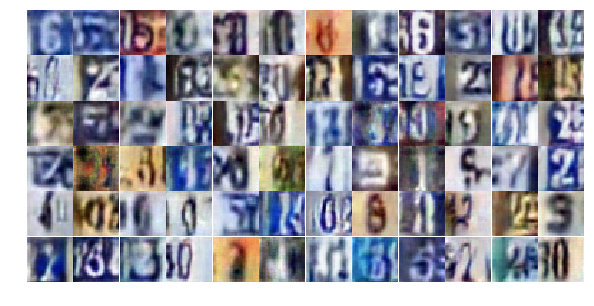

Epoch 13/25... Discriminator Loss: 0.5990... Generator Loss: 1.1565
Epoch 13/25... Discriminator Loss: 0.6885... Generator Loss: 1.0373
Epoch 13/25... Discriminator Loss: 0.6576... Generator Loss: 0.9808
Epoch 13/25... Discriminator Loss: 0.4434... Generator Loss: 2.4924
Epoch 13/25... Discriminator Loss: 0.6680... Generator Loss: 0.9926
Epoch 13/25... Discriminator Loss: 1.3306... Generator Loss: 0.4720
Epoch 13/25... Discriminator Loss: 0.4555... Generator Loss: 1.6123
Epoch 13/25... Discriminator Loss: 0.5944... Generator Loss: 1.2024
Epoch 13/25... Discriminator Loss: 0.6053... Generator Loss: 1.9470
Epoch 13/25... Discriminator Loss: 0.4009... Generator Loss: 1.4942


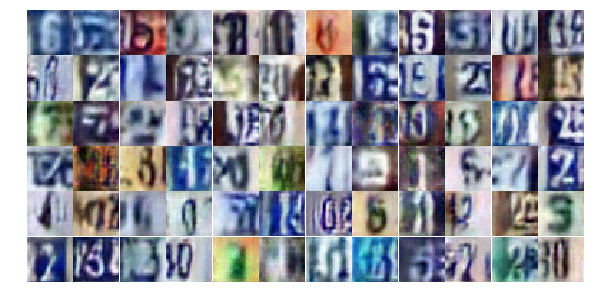

Epoch 13/25... Discriminator Loss: 0.3366... Generator Loss: 1.6764
Epoch 13/25... Discriminator Loss: 0.4173... Generator Loss: 1.4279
Epoch 13/25... Discriminator Loss: 0.4348... Generator Loss: 2.4898
Epoch 13/25... Discriminator Loss: 0.9594... Generator Loss: 1.7754
Epoch 13/25... Discriminator Loss: 0.9934... Generator Loss: 1.1048
Epoch 13/25... Discriminator Loss: 0.7296... Generator Loss: 0.8983
Epoch 13/25... Discriminator Loss: 0.9484... Generator Loss: 0.6734
Epoch 13/25... Discriminator Loss: 0.7028... Generator Loss: 0.9582
Epoch 13/25... Discriminator Loss: 0.6385... Generator Loss: 1.0891
Epoch 13/25... Discriminator Loss: 1.2882... Generator Loss: 0.4791


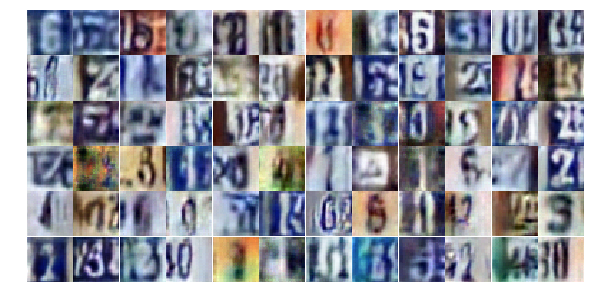

Epoch 13/25... Discriminator Loss: 0.2112... Generator Loss: 2.9900
Epoch 13/25... Discriminator Loss: 0.5168... Generator Loss: 1.3580
Epoch 13/25... Discriminator Loss: 0.7376... Generator Loss: 1.0091
Epoch 13/25... Discriminator Loss: 0.5729... Generator Loss: 1.1997
Epoch 14/25... Discriminator Loss: 0.6651... Generator Loss: 1.0322
Epoch 14/25... Discriminator Loss: 0.1936... Generator Loss: 3.2282
Epoch 14/25... Discriminator Loss: 1.0626... Generator Loss: 0.5672
Epoch 14/25... Discriminator Loss: 0.4696... Generator Loss: 1.6159
Epoch 14/25... Discriminator Loss: 0.6142... Generator Loss: 1.1011
Epoch 14/25... Discriminator Loss: 0.5972... Generator Loss: 1.1914


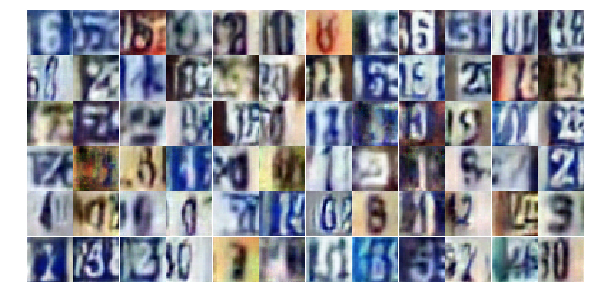

Epoch 14/25... Discriminator Loss: 0.5687... Generator Loss: 2.0379
Epoch 14/25... Discriminator Loss: 0.7408... Generator Loss: 1.2668
Epoch 14/25... Discriminator Loss: 0.7006... Generator Loss: 1.0149
Epoch 14/25... Discriminator Loss: 0.7122... Generator Loss: 1.0657
Epoch 14/25... Discriminator Loss: 1.0674... Generator Loss: 0.5265
Epoch 14/25... Discriminator Loss: 0.4689... Generator Loss: 1.2992
Epoch 14/25... Discriminator Loss: 0.3713... Generator Loss: 2.4341
Epoch 14/25... Discriminator Loss: 1.8025... Generator Loss: 0.2438
Epoch 14/25... Discriminator Loss: 1.4004... Generator Loss: 0.4027
Epoch 14/25... Discriminator Loss: 2.5323... Generator Loss: 0.1116


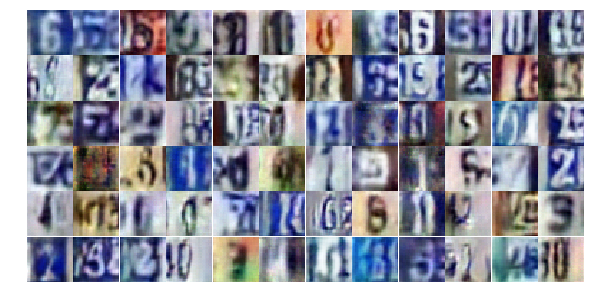

Epoch 14/25... Discriminator Loss: 0.4867... Generator Loss: 1.2206
Epoch 14/25... Discriminator Loss: 0.5131... Generator Loss: 1.1795
Epoch 14/25... Discriminator Loss: 0.8835... Generator Loss: 0.7419
Epoch 14/25... Discriminator Loss: 0.4403... Generator Loss: 1.4535
Epoch 14/25... Discriminator Loss: 1.1465... Generator Loss: 0.5081
Epoch 14/25... Discriminator Loss: 0.5586... Generator Loss: 1.1870
Epoch 14/25... Discriminator Loss: 0.8000... Generator Loss: 0.8738
Epoch 14/25... Discriminator Loss: 0.8216... Generator Loss: 0.7676
Epoch 14/25... Discriminator Loss: 0.3374... Generator Loss: 1.7915
Epoch 14/25... Discriminator Loss: 0.2255... Generator Loss: 2.2282


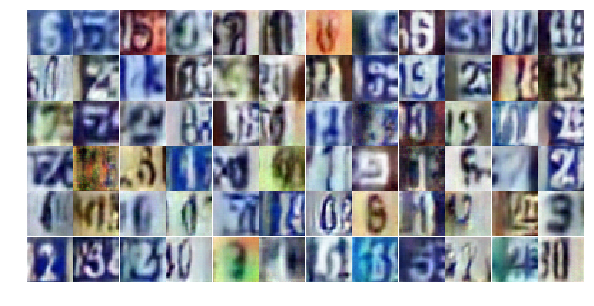

Epoch 14/25... Discriminator Loss: 1.4776... Generator Loss: 0.3512
Epoch 14/25... Discriminator Loss: 0.3099... Generator Loss: 1.8761
Epoch 14/25... Discriminator Loss: 0.2331... Generator Loss: 3.2913
Epoch 14/25... Discriminator Loss: 0.4185... Generator Loss: 1.4848
Epoch 14/25... Discriminator Loss: 0.2556... Generator Loss: 3.9809
Epoch 14/25... Discriminator Loss: 0.4292... Generator Loss: 1.5190
Epoch 14/25... Discriminator Loss: 0.5139... Generator Loss: 1.4442
Epoch 14/25... Discriminator Loss: 0.2666... Generator Loss: 2.0213
Epoch 14/25... Discriminator Loss: 0.1863... Generator Loss: 3.5051
Epoch 14/25... Discriminator Loss: 0.6080... Generator Loss: 1.1097


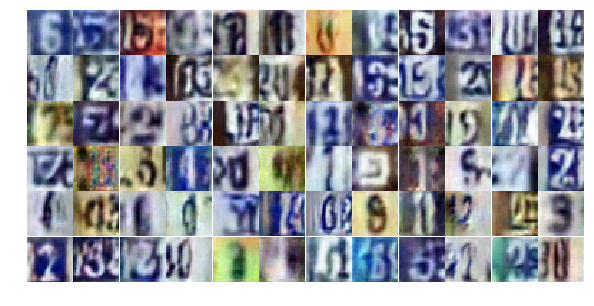

Epoch 14/25... Discriminator Loss: 0.6716... Generator Loss: 1.6375
Epoch 14/25... Discriminator Loss: 0.8022... Generator Loss: 2.5867
Epoch 14/25... Discriminator Loss: 0.3516... Generator Loss: 1.9179
Epoch 14/25... Discriminator Loss: 0.3789... Generator Loss: 1.5923
Epoch 14/25... Discriminator Loss: 0.7023... Generator Loss: 0.9273
Epoch 14/25... Discriminator Loss: 1.4341... Generator Loss: 3.3228
Epoch 14/25... Discriminator Loss: 0.6086... Generator Loss: 1.2381
Epoch 14/25... Discriminator Loss: 0.5598... Generator Loss: 1.2116
Epoch 14/25... Discriminator Loss: 1.1903... Generator Loss: 0.5676
Epoch 14/25... Discriminator Loss: 1.0197... Generator Loss: 0.6125


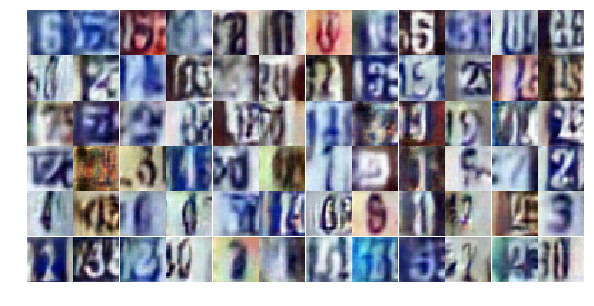

Epoch 14/25... Discriminator Loss: 1.0543... Generator Loss: 0.5701
Epoch 14/25... Discriminator Loss: 0.6785... Generator Loss: 1.1111
Epoch 14/25... Discriminator Loss: 0.3022... Generator Loss: 2.1864
Epoch 14/25... Discriminator Loss: 0.2732... Generator Loss: 2.2838
Epoch 14/25... Discriminator Loss: 0.1540... Generator Loss: 3.3330
Epoch 14/25... Discriminator Loss: 0.5929... Generator Loss: 1.2746
Epoch 14/25... Discriminator Loss: 0.3928... Generator Loss: 1.9674
Epoch 14/25... Discriminator Loss: 1.9647... Generator Loss: 1.5556
Epoch 14/25... Discriminator Loss: 1.0540... Generator Loss: 1.3466
Epoch 14/25... Discriminator Loss: 0.7867... Generator Loss: 0.9446


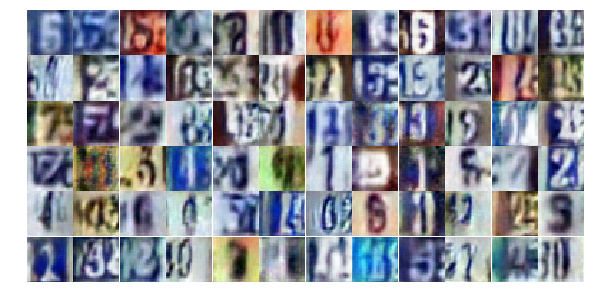

Epoch 14/25... Discriminator Loss: 0.5545... Generator Loss: 1.7182
Epoch 14/25... Discriminator Loss: 0.7537... Generator Loss: 0.8996
Epoch 15/25... Discriminator Loss: 0.7910... Generator Loss: 0.8188
Epoch 15/25... Discriminator Loss: 0.4222... Generator Loss: 1.7613
Epoch 15/25... Discriminator Loss: 0.5826... Generator Loss: 1.6284
Epoch 15/25... Discriminator Loss: 0.5237... Generator Loss: 1.3059
Epoch 15/25... Discriminator Loss: 0.2656... Generator Loss: 2.6157
Epoch 15/25... Discriminator Loss: 0.4819... Generator Loss: 1.3105
Epoch 15/25... Discriminator Loss: 1.7126... Generator Loss: 0.3469
Epoch 15/25... Discriminator Loss: 0.2976... Generator Loss: 2.4508


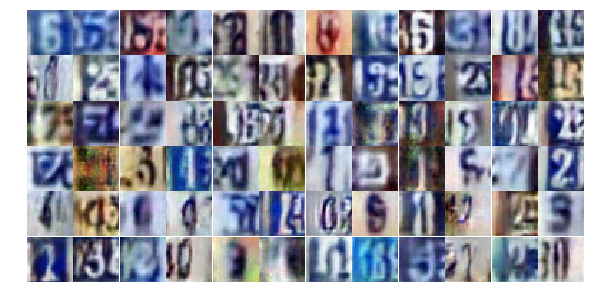

Epoch 15/25... Discriminator Loss: 0.5379... Generator Loss: 2.5091
Epoch 15/25... Discriminator Loss: 0.6489... Generator Loss: 1.4282
Epoch 15/25... Discriminator Loss: 0.8371... Generator Loss: 0.7875
Epoch 15/25... Discriminator Loss: 1.2540... Generator Loss: 0.4728
Epoch 15/25... Discriminator Loss: 1.0289... Generator Loss: 0.6952
Epoch 15/25... Discriminator Loss: 0.2578... Generator Loss: 2.6387
Epoch 15/25... Discriminator Loss: 1.6383... Generator Loss: 0.2734
Epoch 15/25... Discriminator Loss: 0.8584... Generator Loss: 2.0767
Epoch 15/25... Discriminator Loss: 0.9469... Generator Loss: 3.0660
Epoch 15/25... Discriminator Loss: 0.8601... Generator Loss: 0.7604


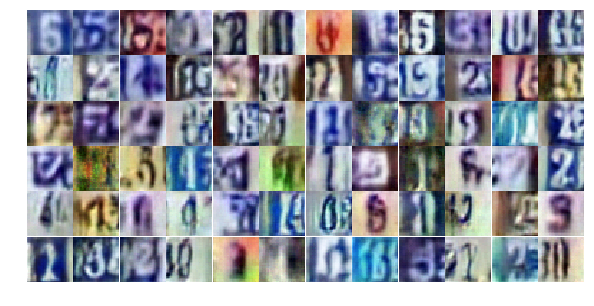

Epoch 15/25... Discriminator Loss: 0.4164... Generator Loss: 1.8693
Epoch 15/25... Discriminator Loss: 0.4901... Generator Loss: 1.3119
Epoch 15/25... Discriminator Loss: 0.5729... Generator Loss: 1.4643
Epoch 15/25... Discriminator Loss: 0.5298... Generator Loss: 1.3650
Epoch 15/25... Discriminator Loss: 0.7877... Generator Loss: 0.9535
Epoch 15/25... Discriminator Loss: 0.4365... Generator Loss: 1.4550
Epoch 15/25... Discriminator Loss: 0.7257... Generator Loss: 1.0163
Epoch 15/25... Discriminator Loss: 0.1691... Generator Loss: 2.7445
Epoch 15/25... Discriminator Loss: 0.6451... Generator Loss: 1.0329
Epoch 15/25... Discriminator Loss: 0.8473... Generator Loss: 0.7763


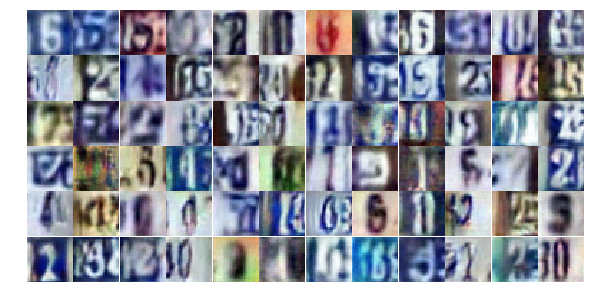

Epoch 15/25... Discriminator Loss: 0.3195... Generator Loss: 2.9574
Epoch 15/25... Discriminator Loss: 0.4945... Generator Loss: 1.3997
Epoch 15/25... Discriminator Loss: 0.4018... Generator Loss: 1.5275
Epoch 15/25... Discriminator Loss: 0.4239... Generator Loss: 1.5072
Epoch 15/25... Discriminator Loss: 0.2321... Generator Loss: 3.9345
Epoch 15/25... Discriminator Loss: 1.0720... Generator Loss: 3.3616
Epoch 15/25... Discriminator Loss: 0.5983... Generator Loss: 1.3167
Epoch 15/25... Discriminator Loss: 0.5887... Generator Loss: 1.1173
Epoch 15/25... Discriminator Loss: 0.6822... Generator Loss: 2.8540
Epoch 15/25... Discriminator Loss: 0.7393... Generator Loss: 1.2680


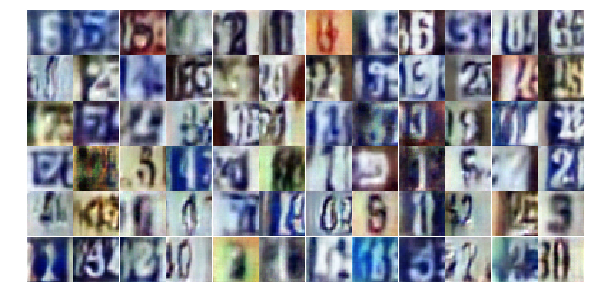

Epoch 15/25... Discriminator Loss: 0.8396... Generator Loss: 2.0032
Epoch 15/25... Discriminator Loss: 1.0512... Generator Loss: 0.5781
Epoch 15/25... Discriminator Loss: 0.4385... Generator Loss: 2.2333
Epoch 15/25... Discriminator Loss: 0.4839... Generator Loss: 1.6517
Epoch 15/25... Discriminator Loss: 0.3328... Generator Loss: 1.7246
Epoch 15/25... Discriminator Loss: 1.7943... Generator Loss: 0.2698
Epoch 15/25... Discriminator Loss: 0.6355... Generator Loss: 1.0372
Epoch 15/25... Discriminator Loss: 0.4932... Generator Loss: 2.0043
Epoch 15/25... Discriminator Loss: 0.7406... Generator Loss: 0.9189
Epoch 15/25... Discriminator Loss: 0.4397... Generator Loss: 2.6086


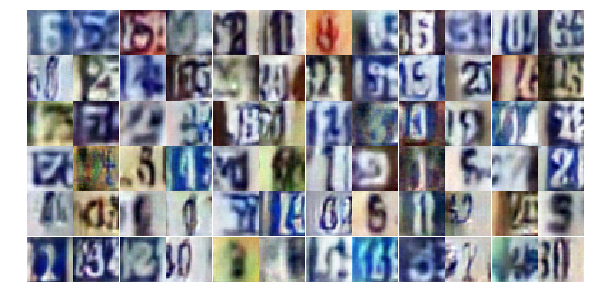

Epoch 15/25... Discriminator Loss: 0.7994... Generator Loss: 0.8247
Epoch 15/25... Discriminator Loss: 0.2385... Generator Loss: 3.2593
Epoch 15/25... Discriminator Loss: 0.3764... Generator Loss: 1.6156
Epoch 15/25... Discriminator Loss: 0.6518... Generator Loss: 1.0139
Epoch 15/25... Discriminator Loss: 0.3853... Generator Loss: 1.6376
Epoch 15/25... Discriminator Loss: 1.1865... Generator Loss: 2.2727
Epoch 15/25... Discriminator Loss: 0.5971... Generator Loss: 1.2366
Epoch 15/25... Discriminator Loss: 0.5980... Generator Loss: 1.9007
Epoch 15/25... Discriminator Loss: 0.9103... Generator Loss: 0.8522
Epoch 16/25... Discriminator Loss: 0.6854... Generator Loss: 1.0158


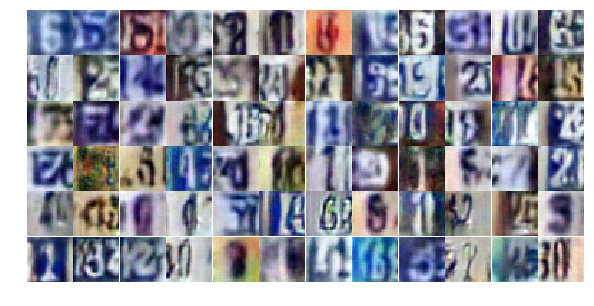

Epoch 16/25... Discriminator Loss: 0.5828... Generator Loss: 1.2386
Epoch 16/25... Discriminator Loss: 0.4855... Generator Loss: 1.5531
Epoch 16/25... Discriminator Loss: 0.5697... Generator Loss: 1.1597
Epoch 16/25... Discriminator Loss: 0.6333... Generator Loss: 1.0276
Epoch 16/25... Discriminator Loss: 0.3693... Generator Loss: 1.7220
Epoch 16/25... Discriminator Loss: 0.6078... Generator Loss: 1.1894
Epoch 16/25... Discriminator Loss: 1.1137... Generator Loss: 0.7084
Epoch 16/25... Discriminator Loss: 0.2201... Generator Loss: 3.6877
Epoch 16/25... Discriminator Loss: 1.2197... Generator Loss: 0.4965
Epoch 16/25... Discriminator Loss: 2.7216... Generator Loss: 0.1084


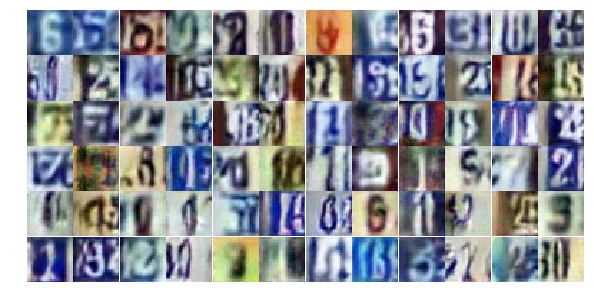

Epoch 16/25... Discriminator Loss: 0.8953... Generator Loss: 0.8228
Epoch 16/25... Discriminator Loss: 0.4009... Generator Loss: 2.0585
Epoch 16/25... Discriminator Loss: 0.2038... Generator Loss: 2.9521
Epoch 16/25... Discriminator Loss: 1.4415... Generator Loss: 0.3457
Epoch 16/25... Discriminator Loss: 0.4686... Generator Loss: 1.9016
Epoch 16/25... Discriminator Loss: 0.6033... Generator Loss: 1.1269
Epoch 16/25... Discriminator Loss: 0.8397... Generator Loss: 0.8356
Epoch 16/25... Discriminator Loss: 0.5502... Generator Loss: 1.5389
Epoch 16/25... Discriminator Loss: 0.5274... Generator Loss: 1.2763
Epoch 16/25... Discriminator Loss: 0.8106... Generator Loss: 0.7765


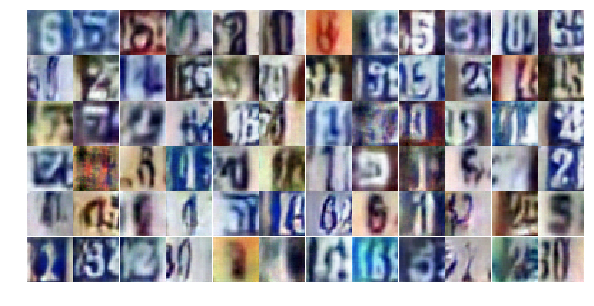

Epoch 16/25... Discriminator Loss: 0.7785... Generator Loss: 0.8645
Epoch 16/25... Discriminator Loss: 0.5428... Generator Loss: 1.3761
Epoch 16/25... Discriminator Loss: 0.8045... Generator Loss: 0.8275
Epoch 16/25... Discriminator Loss: 0.8865... Generator Loss: 0.7215
Epoch 16/25... Discriminator Loss: 0.2618... Generator Loss: 2.3135
Epoch 16/25... Discriminator Loss: 1.1526... Generator Loss: 0.5164
Epoch 16/25... Discriminator Loss: 0.7877... Generator Loss: 0.9709
Epoch 16/25... Discriminator Loss: 0.4864... Generator Loss: 2.1139
Epoch 16/25... Discriminator Loss: 0.6536... Generator Loss: 1.2330
Epoch 16/25... Discriminator Loss: 0.7868... Generator Loss: 0.9433


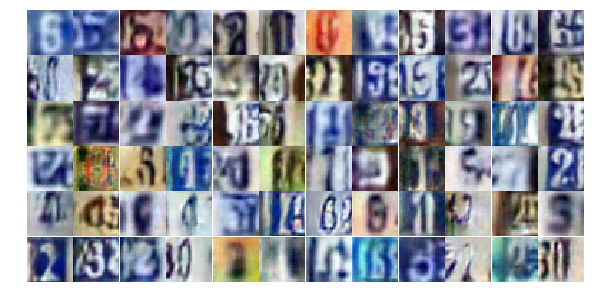

Epoch 16/25... Discriminator Loss: 0.5987... Generator Loss: 1.1003
Epoch 16/25... Discriminator Loss: 0.5749... Generator Loss: 1.1484
Epoch 16/25... Discriminator Loss: 0.7118... Generator Loss: 0.9824
Epoch 16/25... Discriminator Loss: 1.5706... Generator Loss: 2.8241
Epoch 16/25... Discriminator Loss: 0.8546... Generator Loss: 0.8476
Epoch 16/25... Discriminator Loss: 0.7030... Generator Loss: 1.0321
Epoch 16/25... Discriminator Loss: 0.7351... Generator Loss: 0.9532
Epoch 16/25... Discriminator Loss: 0.9281... Generator Loss: 0.6981
Epoch 16/25... Discriminator Loss: 0.7027... Generator Loss: 0.9451
Epoch 16/25... Discriminator Loss: 0.3372... Generator Loss: 1.7462


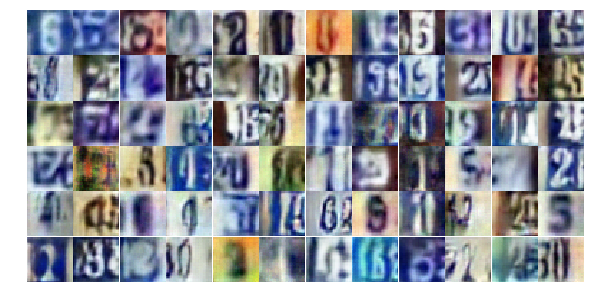

Epoch 16/25... Discriminator Loss: 0.6847... Generator Loss: 1.1631
Epoch 16/25... Discriminator Loss: 0.8527... Generator Loss: 0.8266
Epoch 16/25... Discriminator Loss: 0.8883... Generator Loss: 0.7476
Epoch 16/25... Discriminator Loss: 0.4471... Generator Loss: 1.6250
Epoch 16/25... Discriminator Loss: 1.2930... Generator Loss: 0.4170
Epoch 16/25... Discriminator Loss: 1.1349... Generator Loss: 0.5487
Epoch 16/25... Discriminator Loss: 0.5145... Generator Loss: 1.4533
Epoch 16/25... Discriminator Loss: 1.0141... Generator Loss: 0.6433
Epoch 16/25... Discriminator Loss: 0.4545... Generator Loss: 1.4690
Epoch 16/25... Discriminator Loss: 0.4829... Generator Loss: 1.4338


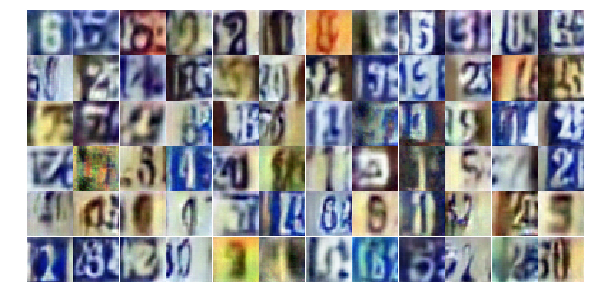

Epoch 16/25... Discriminator Loss: 2.1389... Generator Loss: 0.1800
Epoch 16/25... Discriminator Loss: 0.7069... Generator Loss: 1.0425
Epoch 16/25... Discriminator Loss: 1.8529... Generator Loss: 0.2341
Epoch 16/25... Discriminator Loss: 0.5761... Generator Loss: 1.7781
Epoch 16/25... Discriminator Loss: 0.6571... Generator Loss: 1.0701
Epoch 16/25... Discriminator Loss: 0.4709... Generator Loss: 1.6048
Epoch 17/25... Discriminator Loss: 0.8705... Generator Loss: 0.7681
Epoch 17/25... Discriminator Loss: 0.5031... Generator Loss: 1.3602
Epoch 17/25... Discriminator Loss: 0.5036... Generator Loss: 2.7787
Epoch 17/25... Discriminator Loss: 0.3594... Generator Loss: 1.5595


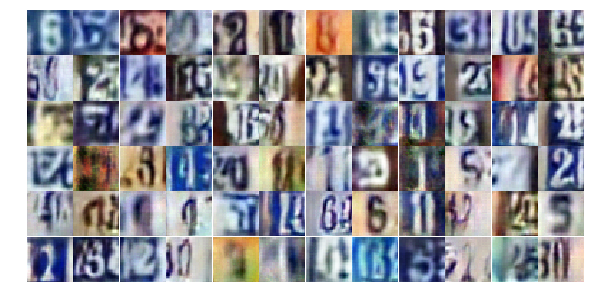

Epoch 17/25... Discriminator Loss: 0.3498... Generator Loss: 1.8251
Epoch 17/25... Discriminator Loss: 0.1833... Generator Loss: 3.7842
Epoch 17/25... Discriminator Loss: 1.1549... Generator Loss: 0.5360
Epoch 17/25... Discriminator Loss: 1.1160... Generator Loss: 0.6411
Epoch 17/25... Discriminator Loss: 0.8649... Generator Loss: 0.8199
Epoch 17/25... Discriminator Loss: 0.8928... Generator Loss: 0.8496
Epoch 17/25... Discriminator Loss: 0.6990... Generator Loss: 0.8875
Epoch 17/25... Discriminator Loss: 1.0373... Generator Loss: 0.6186
Epoch 17/25... Discriminator Loss: 0.3944... Generator Loss: 1.6921
Epoch 17/25... Discriminator Loss: 0.8900... Generator Loss: 2.8415


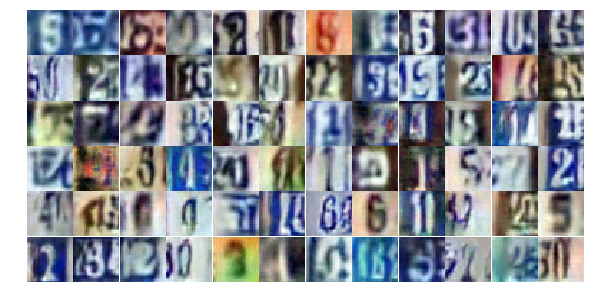

Epoch 17/25... Discriminator Loss: 1.0697... Generator Loss: 2.1310
Epoch 17/25... Discriminator Loss: 1.5702... Generator Loss: 3.3294
Epoch 17/25... Discriminator Loss: 0.6770... Generator Loss: 1.0179
Epoch 17/25... Discriminator Loss: 1.1046... Generator Loss: 0.5399
Epoch 17/25... Discriminator Loss: 0.5630... Generator Loss: 1.2486
Epoch 17/25... Discriminator Loss: 0.6256... Generator Loss: 1.0868
Epoch 17/25... Discriminator Loss: 0.6105... Generator Loss: 1.3196
Epoch 17/25... Discriminator Loss: 0.3850... Generator Loss: 1.5767
Epoch 17/25... Discriminator Loss: 0.4929... Generator Loss: 1.5192
Epoch 17/25... Discriminator Loss: 0.2113... Generator Loss: 2.7393


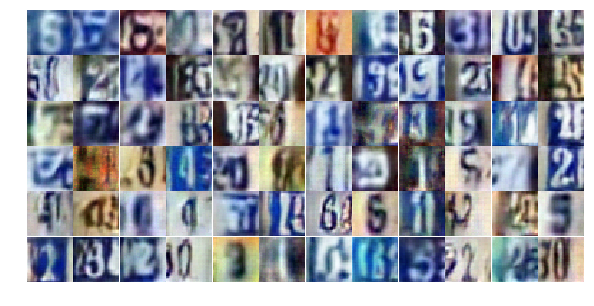

Epoch 17/25... Discriminator Loss: 1.9570... Generator Loss: 0.2040
Epoch 17/25... Discriminator Loss: 0.6265... Generator Loss: 1.3281
Epoch 17/25... Discriminator Loss: 0.3842... Generator Loss: 2.5817
Epoch 17/25... Discriminator Loss: 0.7687... Generator Loss: 0.8691
Epoch 17/25... Discriminator Loss: 0.9424... Generator Loss: 1.4540
Epoch 17/25... Discriminator Loss: 0.2885... Generator Loss: 2.1384
Epoch 17/25... Discriminator Loss: 0.2598... Generator Loss: 2.2973
Epoch 17/25... Discriminator Loss: 0.3210... Generator Loss: 1.9730
Epoch 17/25... Discriminator Loss: 0.7866... Generator Loss: 1.5379
Epoch 17/25... Discriminator Loss: 0.4551... Generator Loss: 1.5189


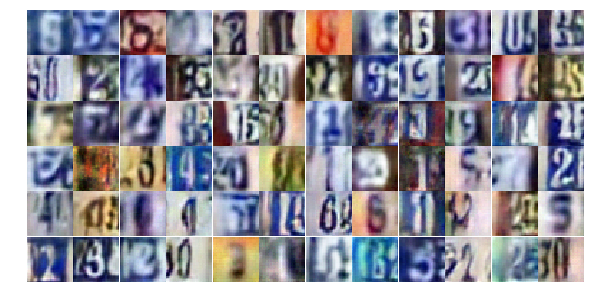

Epoch 17/25... Discriminator Loss: 0.3147... Generator Loss: 2.7746
Epoch 17/25... Discriminator Loss: 0.8171... Generator Loss: 1.1264
Epoch 17/25... Discriminator Loss: 0.4355... Generator Loss: 2.4397
Epoch 17/25... Discriminator Loss: 1.1982... Generator Loss: 0.5044
Epoch 17/25... Discriminator Loss: 0.6921... Generator Loss: 0.9377
Epoch 17/25... Discriminator Loss: 0.3354... Generator Loss: 1.8111
Epoch 17/25... Discriminator Loss: 0.1983... Generator Loss: 3.1024
Epoch 17/25... Discriminator Loss: 0.2986... Generator Loss: 1.9786
Epoch 17/25... Discriminator Loss: 0.6021... Generator Loss: 1.0466
Epoch 17/25... Discriminator Loss: 0.3100... Generator Loss: 1.8159


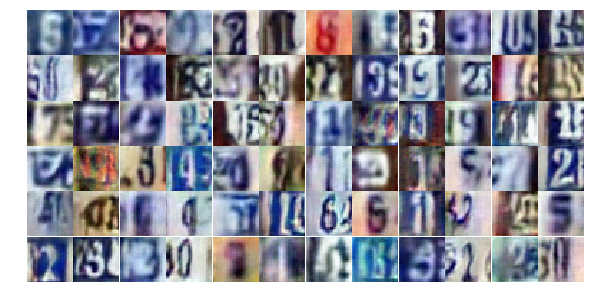

Epoch 17/25... Discriminator Loss: 1.0262... Generator Loss: 0.6545
Epoch 17/25... Discriminator Loss: 0.3001... Generator Loss: 2.3627
Epoch 17/25... Discriminator Loss: 2.0365... Generator Loss: 1.8742
Epoch 17/25... Discriminator Loss: 0.6470... Generator Loss: 1.3578
Epoch 17/25... Discriminator Loss: 0.5458... Generator Loss: 1.5587
Epoch 17/25... Discriminator Loss: 0.8416... Generator Loss: 0.9231
Epoch 17/25... Discriminator Loss: 0.8851... Generator Loss: 0.7900
Epoch 17/25... Discriminator Loss: 1.0948... Generator Loss: 0.5785
Epoch 17/25... Discriminator Loss: 1.2145... Generator Loss: 0.4990
Epoch 17/25... Discriminator Loss: 1.0705... Generator Loss: 0.8833


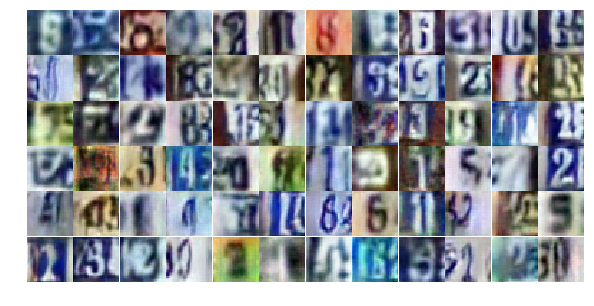

Epoch 17/25... Discriminator Loss: 0.5971... Generator Loss: 1.3159
Epoch 17/25... Discriminator Loss: 1.1057... Generator Loss: 0.5689
Epoch 17/25... Discriminator Loss: 0.2619... Generator Loss: 2.4406
Epoch 17/25... Discriminator Loss: 0.4315... Generator Loss: 1.5177
Epoch 18/25... Discriminator Loss: 0.5870... Generator Loss: 1.1252
Epoch 18/25... Discriminator Loss: 1.5018... Generator Loss: 0.3615
Epoch 18/25... Discriminator Loss: 0.6282... Generator Loss: 1.1086
Epoch 18/25... Discriminator Loss: 0.6700... Generator Loss: 1.0258
Epoch 18/25... Discriminator Loss: 1.0130... Generator Loss: 0.6327
Epoch 18/25... Discriminator Loss: 0.6192... Generator Loss: 1.2532


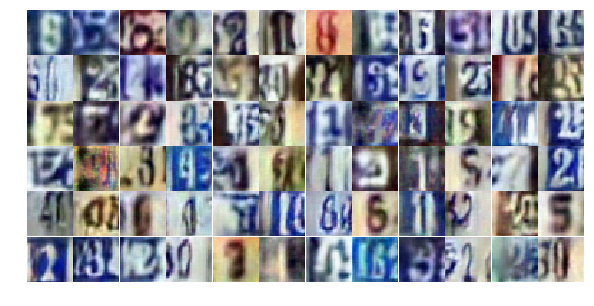

Epoch 18/25... Discriminator Loss: 1.1133... Generator Loss: 3.0716
Epoch 18/25... Discriminator Loss: 0.7732... Generator Loss: 0.9264
Epoch 18/25... Discriminator Loss: 0.7352... Generator Loss: 0.9015
Epoch 18/25... Discriminator Loss: 0.4855... Generator Loss: 1.5270
Epoch 18/25... Discriminator Loss: 0.6455... Generator Loss: 1.1168
Epoch 18/25... Discriminator Loss: 0.9693... Generator Loss: 0.6973
Epoch 18/25... Discriminator Loss: 0.5128... Generator Loss: 1.2344
Epoch 18/25... Discriminator Loss: 0.3000... Generator Loss: 2.3462
Epoch 18/25... Discriminator Loss: 0.5788... Generator Loss: 1.9086
Epoch 18/25... Discriminator Loss: 0.2997... Generator Loss: 2.3085


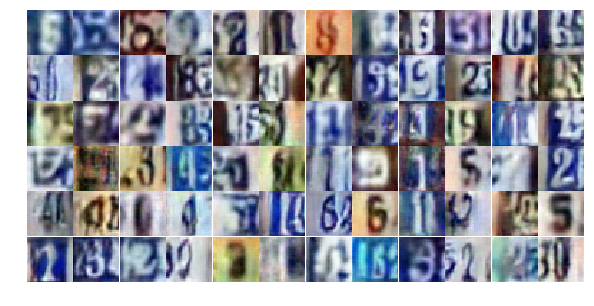

Epoch 18/25... Discriminator Loss: 0.7628... Generator Loss: 1.0138
Epoch 18/25... Discriminator Loss: 0.6792... Generator Loss: 1.0857
Epoch 18/25... Discriminator Loss: 0.7899... Generator Loss: 1.0989
Epoch 18/25... Discriminator Loss: 0.5345... Generator Loss: 1.2776
Epoch 18/25... Discriminator Loss: 0.6381... Generator Loss: 1.0442
Epoch 18/25... Discriminator Loss: 1.0420... Generator Loss: 0.6139
Epoch 18/25... Discriminator Loss: 0.7258... Generator Loss: 2.6369
Epoch 18/25... Discriminator Loss: 0.9885... Generator Loss: 0.6530
Epoch 18/25... Discriminator Loss: 0.7057... Generator Loss: 0.9413
Epoch 18/25... Discriminator Loss: 0.5717... Generator Loss: 1.1911


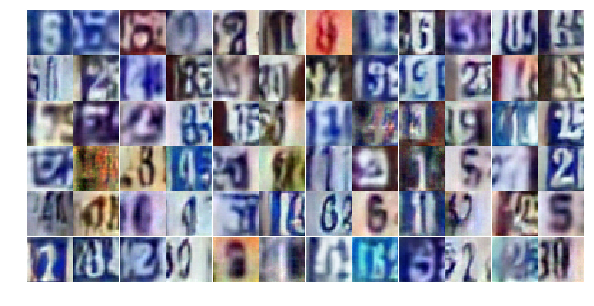

Epoch 18/25... Discriminator Loss: 0.4814... Generator Loss: 1.5244
Epoch 18/25... Discriminator Loss: 0.7346... Generator Loss: 0.9949
Epoch 18/25... Discriminator Loss: 0.5132... Generator Loss: 1.4386
Epoch 18/25... Discriminator Loss: 0.4309... Generator Loss: 1.6256
Epoch 18/25... Discriminator Loss: 1.2234... Generator Loss: 0.5139
Epoch 18/25... Discriminator Loss: 0.3060... Generator Loss: 2.3623
Epoch 18/25... Discriminator Loss: 0.4484... Generator Loss: 1.5749
Epoch 18/25... Discriminator Loss: 0.4391... Generator Loss: 2.1189
Epoch 18/25... Discriminator Loss: 0.3559... Generator Loss: 1.7264
Epoch 18/25... Discriminator Loss: 0.7852... Generator Loss: 1.6897


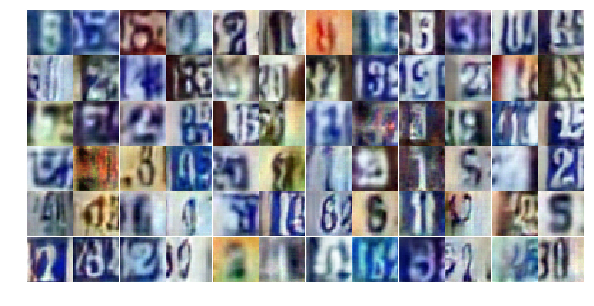

Epoch 18/25... Discriminator Loss: 0.6234... Generator Loss: 1.2556
Epoch 18/25... Discriminator Loss: 0.8364... Generator Loss: 0.8759
Epoch 18/25... Discriminator Loss: 0.5749... Generator Loss: 1.1683
Epoch 18/25... Discriminator Loss: 0.5696... Generator Loss: 1.1558
Epoch 18/25... Discriminator Loss: 0.9017... Generator Loss: 0.7781
Epoch 18/25... Discriminator Loss: 0.2941... Generator Loss: 1.8809
Epoch 18/25... Discriminator Loss: 0.3019... Generator Loss: 2.1616
Epoch 18/25... Discriminator Loss: 0.8664... Generator Loss: 2.9298
Epoch 18/25... Discriminator Loss: 0.4324... Generator Loss: 1.4770
Epoch 18/25... Discriminator Loss: 0.4274... Generator Loss: 1.4068


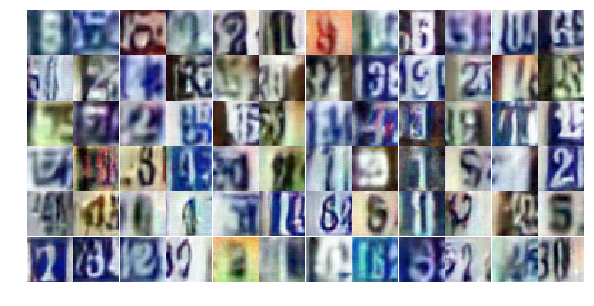

Epoch 18/25... Discriminator Loss: 0.6571... Generator Loss: 0.9508
Epoch 18/25... Discriminator Loss: 1.1745... Generator Loss: 0.4952
Epoch 18/25... Discriminator Loss: 0.8805... Generator Loss: 0.7580
Epoch 18/25... Discriminator Loss: 1.2503... Generator Loss: 2.8878
Epoch 18/25... Discriminator Loss: 1.6648... Generator Loss: 0.3737
Epoch 18/25... Discriminator Loss: 0.4029... Generator Loss: 1.7570
Epoch 18/25... Discriminator Loss: 0.8381... Generator Loss: 0.8216
Epoch 18/25... Discriminator Loss: 0.3581... Generator Loss: 2.1372
Epoch 18/25... Discriminator Loss: 1.4028... Generator Loss: 0.5317
Epoch 18/25... Discriminator Loss: 1.2219... Generator Loss: 0.6192


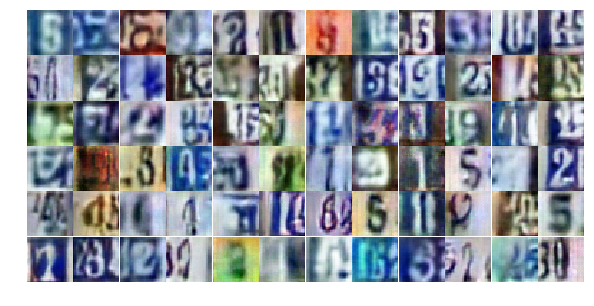

Epoch 18/25... Discriminator Loss: 0.5230... Generator Loss: 1.6716
Epoch 19/25... Discriminator Loss: 0.7118... Generator Loss: 1.4881
Epoch 19/25... Discriminator Loss: 0.8758... Generator Loss: 0.7746
Epoch 19/25... Discriminator Loss: 0.8265... Generator Loss: 0.8141
Epoch 19/25... Discriminator Loss: 0.7062... Generator Loss: 0.9257
Epoch 19/25... Discriminator Loss: 1.1967... Generator Loss: 0.5214
Epoch 19/25... Discriminator Loss: 0.9638... Generator Loss: 0.6647
Epoch 19/25... Discriminator Loss: 0.8053... Generator Loss: 0.9100
Epoch 19/25... Discriminator Loss: 0.4845... Generator Loss: 1.9179
Epoch 19/25... Discriminator Loss: 0.4886... Generator Loss: 1.4096


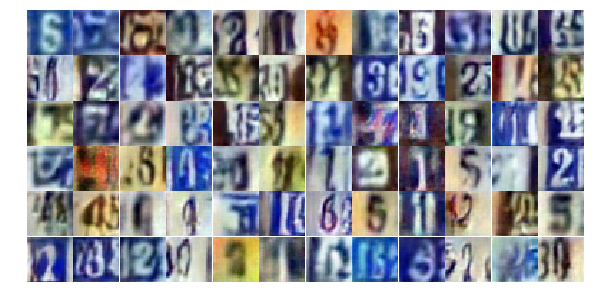

Epoch 19/25... Discriminator Loss: 0.4118... Generator Loss: 1.7990
Epoch 19/25... Discriminator Loss: 0.7754... Generator Loss: 0.8409
Epoch 19/25... Discriminator Loss: 0.8239... Generator Loss: 1.0482
Epoch 19/25... Discriminator Loss: 1.2461... Generator Loss: 0.4563
Epoch 19/25... Discriminator Loss: 0.4590... Generator Loss: 1.2914
Epoch 19/25... Discriminator Loss: 1.3871... Generator Loss: 0.4096
Epoch 19/25... Discriminator Loss: 0.3897... Generator Loss: 1.6763
Epoch 19/25... Discriminator Loss: 0.6684... Generator Loss: 1.0282
Epoch 19/25... Discriminator Loss: 0.9523... Generator Loss: 2.4173
Epoch 19/25... Discriminator Loss: 0.9436... Generator Loss: 0.9394


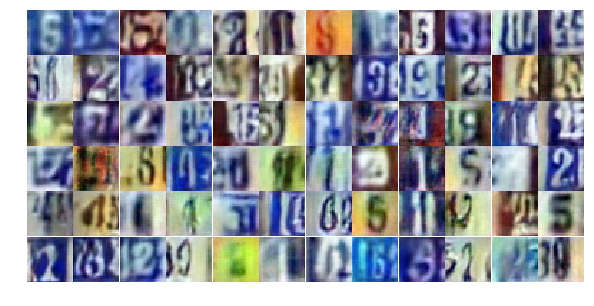

Epoch 19/25... Discriminator Loss: 0.2642... Generator Loss: 2.2926
Epoch 19/25... Discriminator Loss: 1.2302... Generator Loss: 0.5224
Epoch 19/25... Discriminator Loss: 1.4507... Generator Loss: 0.4359
Epoch 19/25... Discriminator Loss: 0.4112... Generator Loss: 2.1341
Epoch 19/25... Discriminator Loss: 0.8990... Generator Loss: 0.8208
Epoch 19/25... Discriminator Loss: 0.6310... Generator Loss: 1.3605
Epoch 19/25... Discriminator Loss: 1.0130... Generator Loss: 0.7720
Epoch 19/25... Discriminator Loss: 0.5248... Generator Loss: 1.3878
Epoch 19/25... Discriminator Loss: 0.3904... Generator Loss: 2.3784
Epoch 19/25... Discriminator Loss: 0.5854... Generator Loss: 1.7330


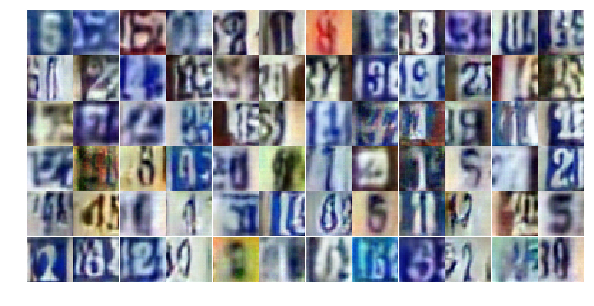

Epoch 19/25... Discriminator Loss: 0.5286... Generator Loss: 1.8570
Epoch 19/25... Discriminator Loss: 0.5646... Generator Loss: 1.2317
Epoch 19/25... Discriminator Loss: 0.2386... Generator Loss: 2.0053
Epoch 19/25... Discriminator Loss: 0.3567... Generator Loss: 1.9041
Epoch 19/25... Discriminator Loss: 0.5720... Generator Loss: 1.2948
Epoch 19/25... Discriminator Loss: 1.8472... Generator Loss: 0.3550
Epoch 19/25... Discriminator Loss: 0.6117... Generator Loss: 1.2657
Epoch 19/25... Discriminator Loss: 0.4990... Generator Loss: 1.5227
Epoch 19/25... Discriminator Loss: 0.7216... Generator Loss: 1.0713
Epoch 19/25... Discriminator Loss: 0.1473... Generator Loss: 3.2594


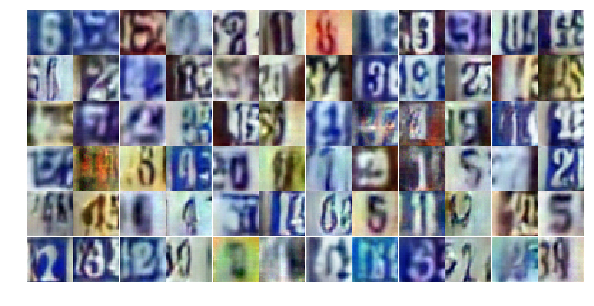

Epoch 19/25... Discriminator Loss: 0.8532... Generator Loss: 0.8104
Epoch 19/25... Discriminator Loss: 0.6360... Generator Loss: 1.0025
Epoch 19/25... Discriminator Loss: 0.4995... Generator Loss: 1.7229
Epoch 19/25... Discriminator Loss: 0.7929... Generator Loss: 0.8496
Epoch 19/25... Discriminator Loss: 0.7583... Generator Loss: 0.9180
Epoch 19/25... Discriminator Loss: 1.0466... Generator Loss: 0.7118
Epoch 19/25... Discriminator Loss: 0.7026... Generator Loss: 1.0391
Epoch 19/25... Discriminator Loss: 0.4282... Generator Loss: 1.7484
Epoch 19/25... Discriminator Loss: 0.6412... Generator Loss: 1.2049
Epoch 19/25... Discriminator Loss: 0.5452... Generator Loss: 1.8579


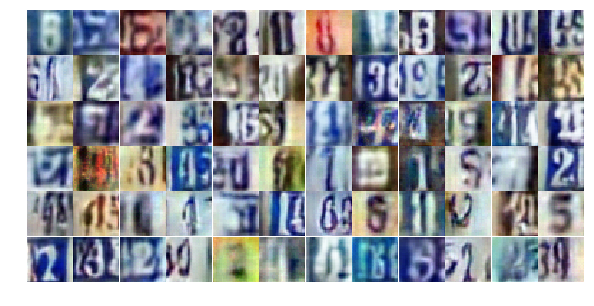

Epoch 19/25... Discriminator Loss: 0.6212... Generator Loss: 1.3483
Epoch 19/25... Discriminator Loss: 0.3251... Generator Loss: 1.9804
Epoch 19/25... Discriminator Loss: 0.6385... Generator Loss: 2.7063
Epoch 19/25... Discriminator Loss: 0.9404... Generator Loss: 0.8360
Epoch 19/25... Discriminator Loss: 0.6984... Generator Loss: 2.8297
Epoch 19/25... Discriminator Loss: 0.5573... Generator Loss: 1.2270
Epoch 19/25... Discriminator Loss: 1.7140... Generator Loss: 0.2730
Epoch 19/25... Discriminator Loss: 0.5984... Generator Loss: 2.8939
Epoch 20/25... Discriminator Loss: 0.4033... Generator Loss: 1.7015
Epoch 20/25... Discriminator Loss: 0.4938... Generator Loss: 1.4257


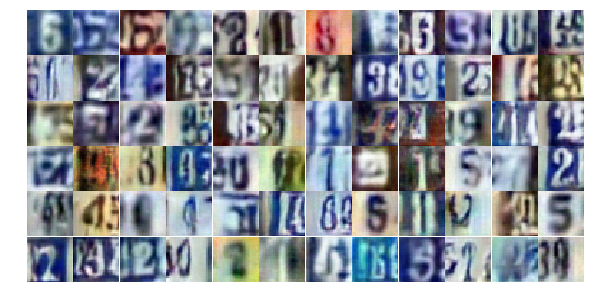

Epoch 20/25... Discriminator Loss: 0.5139... Generator Loss: 2.1220
Epoch 20/25... Discriminator Loss: 0.8741... Generator Loss: 0.7649
Epoch 20/25... Discriminator Loss: 0.7166... Generator Loss: 1.0744
Epoch 20/25... Discriminator Loss: 0.6932... Generator Loss: 1.0213
Epoch 20/25... Discriminator Loss: 0.5833... Generator Loss: 1.5308
Epoch 20/25... Discriminator Loss: 0.7254... Generator Loss: 0.9528
Epoch 20/25... Discriminator Loss: 0.8755... Generator Loss: 0.7767
Epoch 20/25... Discriminator Loss: 0.6424... Generator Loss: 1.2479
Epoch 20/25... Discriminator Loss: 1.1626... Generator Loss: 0.6381
Epoch 20/25... Discriminator Loss: 0.7311... Generator Loss: 0.9788


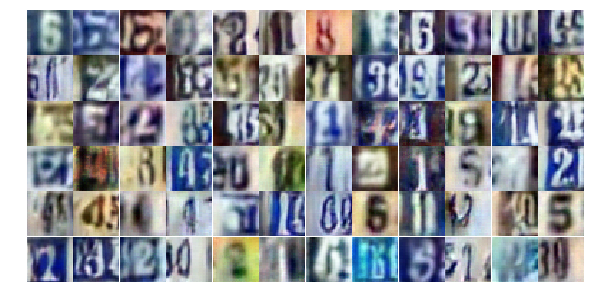

Epoch 20/25... Discriminator Loss: 1.1607... Generator Loss: 0.5383
Epoch 20/25... Discriminator Loss: 0.9917... Generator Loss: 0.8023
Epoch 20/25... Discriminator Loss: 0.7844... Generator Loss: 0.8502
Epoch 20/25... Discriminator Loss: 0.4451... Generator Loss: 1.7038
Epoch 20/25... Discriminator Loss: 0.5265... Generator Loss: 1.3684
Epoch 20/25... Discriminator Loss: 0.4129... Generator Loss: 2.5463
Epoch 20/25... Discriminator Loss: 1.1930... Generator Loss: 0.5907
Epoch 20/25... Discriminator Loss: 0.7763... Generator Loss: 0.8745
Epoch 20/25... Discriminator Loss: 0.4562... Generator Loss: 1.6349
Epoch 20/25... Discriminator Loss: 1.0945... Generator Loss: 0.5511


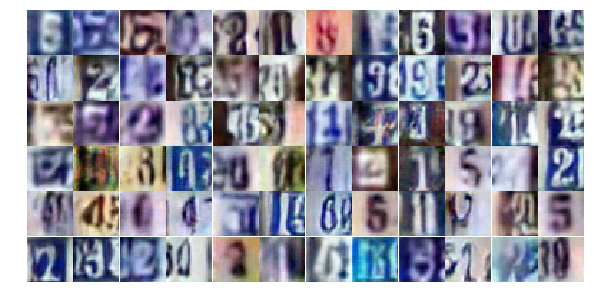

Epoch 20/25... Discriminator Loss: 0.4722... Generator Loss: 1.3475
Epoch 20/25... Discriminator Loss: 0.7614... Generator Loss: 1.1507
Epoch 20/25... Discriminator Loss: 0.6400... Generator Loss: 3.7611
Epoch 20/25... Discriminator Loss: 0.9387... Generator Loss: 0.8364
Epoch 20/25... Discriminator Loss: 0.7678... Generator Loss: 0.9706
Epoch 20/25... Discriminator Loss: 0.4122... Generator Loss: 1.6249
Epoch 20/25... Discriminator Loss: 0.6745... Generator Loss: 4.2360
Epoch 20/25... Discriminator Loss: 1.7887... Generator Loss: 0.3055
Epoch 20/25... Discriminator Loss: 0.8670... Generator Loss: 0.7866
Epoch 20/25... Discriminator Loss: 0.6160... Generator Loss: 1.0585


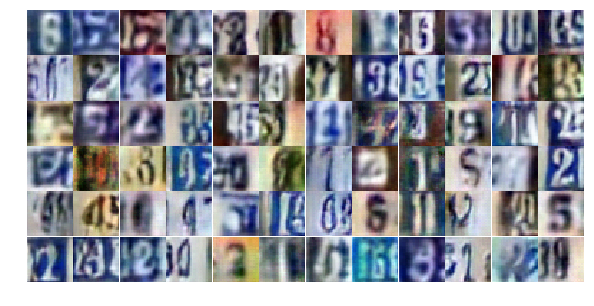

Epoch 20/25... Discriminator Loss: 0.6535... Generator Loss: 1.0246
Epoch 20/25... Discriminator Loss: 0.7157... Generator Loss: 0.9547
Epoch 20/25... Discriminator Loss: 0.6173... Generator Loss: 1.4092
Epoch 20/25... Discriminator Loss: 0.9987... Generator Loss: 0.6540
Epoch 20/25... Discriminator Loss: 1.0935... Generator Loss: 0.5383
Epoch 20/25... Discriminator Loss: 0.6920... Generator Loss: 0.9638
Epoch 20/25... Discriminator Loss: 0.7561... Generator Loss: 0.8949
Epoch 20/25... Discriminator Loss: 0.8702... Generator Loss: 0.8352
Epoch 20/25... Discriminator Loss: 0.5834... Generator Loss: 1.2612
Epoch 20/25... Discriminator Loss: 1.5401... Generator Loss: 0.4101


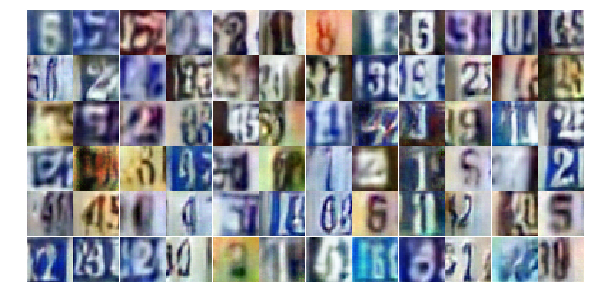

Epoch 20/25... Discriminator Loss: 1.1647... Generator Loss: 0.4971
Epoch 20/25... Discriminator Loss: 0.7330... Generator Loss: 0.9736
Epoch 20/25... Discriminator Loss: 2.0841... Generator Loss: 0.2183
Epoch 20/25... Discriminator Loss: 1.3591... Generator Loss: 0.6256
Epoch 20/25... Discriminator Loss: 0.8754... Generator Loss: 1.0465
Epoch 20/25... Discriminator Loss: 1.3307... Generator Loss: 0.4916
Epoch 20/25... Discriminator Loss: 0.8704... Generator Loss: 0.8062
Epoch 20/25... Discriminator Loss: 0.3642... Generator Loss: 2.1037
Epoch 20/25... Discriminator Loss: 0.5101... Generator Loss: 1.8098
Epoch 20/25... Discriminator Loss: 0.5910... Generator Loss: 1.2024


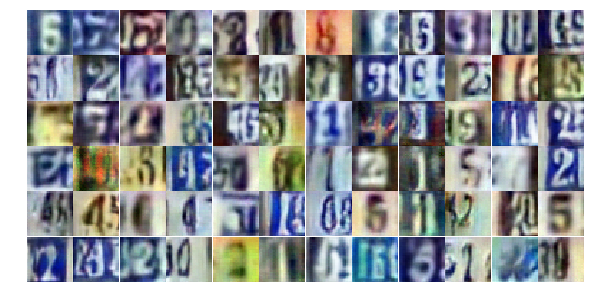

Epoch 20/25... Discriminator Loss: 0.4791... Generator Loss: 1.7311
Epoch 20/25... Discriminator Loss: 0.3952... Generator Loss: 2.5679
Epoch 20/25... Discriminator Loss: 0.5199... Generator Loss: 1.5695
Epoch 20/25... Discriminator Loss: 0.4713... Generator Loss: 1.8327
Epoch 20/25... Discriminator Loss: 0.4643... Generator Loss: 1.4884
Epoch 20/25... Discriminator Loss: 0.8484... Generator Loss: 0.7510
Epoch 21/25... Discriminator Loss: 0.9822... Generator Loss: 0.7055
Epoch 21/25... Discriminator Loss: 0.4338... Generator Loss: 1.4851
Epoch 21/25... Discriminator Loss: 0.5259... Generator Loss: 1.6366
Epoch 21/25... Discriminator Loss: 1.0576... Generator Loss: 0.5832


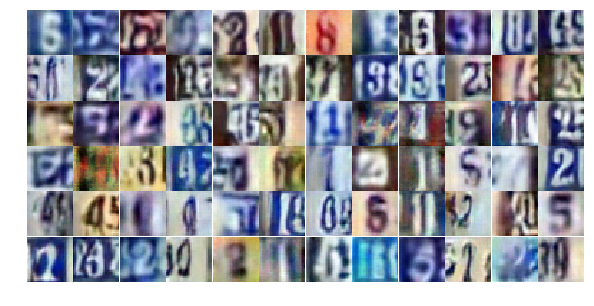

Epoch 21/25... Discriminator Loss: 0.4636... Generator Loss: 1.9251
Epoch 21/25... Discriminator Loss: 5.5967... Generator Loss: 0.0121
Epoch 21/25... Discriminator Loss: 1.4007... Generator Loss: 1.3646
Epoch 21/25... Discriminator Loss: 0.7615... Generator Loss: 1.1299
Epoch 21/25... Discriminator Loss: 0.7029... Generator Loss: 1.0757
Epoch 21/25... Discriminator Loss: 0.7600... Generator Loss: 0.8937
Epoch 21/25... Discriminator Loss: 0.5414... Generator Loss: 1.2192
Epoch 21/25... Discriminator Loss: 0.9147... Generator Loss: 0.8087
Epoch 21/25... Discriminator Loss: 0.7990... Generator Loss: 0.8470
Epoch 21/25... Discriminator Loss: 0.7814... Generator Loss: 0.8927


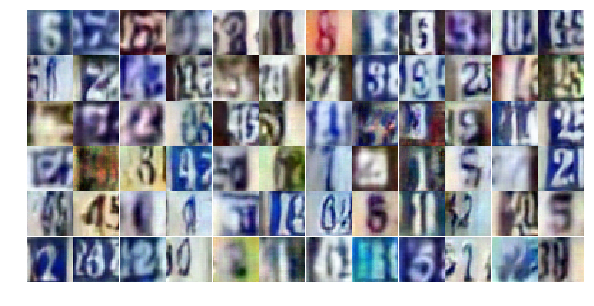

Epoch 21/25... Discriminator Loss: 0.3424... Generator Loss: 1.9392
Epoch 21/25... Discriminator Loss: 1.0012... Generator Loss: 0.7371
Epoch 21/25... Discriminator Loss: 2.2251... Generator Loss: 0.1631
Epoch 21/25... Discriminator Loss: 1.1050... Generator Loss: 0.6362
Epoch 21/25... Discriminator Loss: 0.5803... Generator Loss: 1.3068
Epoch 21/25... Discriminator Loss: 0.7438... Generator Loss: 0.9248
Epoch 21/25... Discriminator Loss: 0.8970... Generator Loss: 0.7455
Epoch 21/25... Discriminator Loss: 0.3563... Generator Loss: 1.7038
Epoch 21/25... Discriminator Loss: 0.5339... Generator Loss: 1.3603
Epoch 21/25... Discriminator Loss: 0.7260... Generator Loss: 1.0277


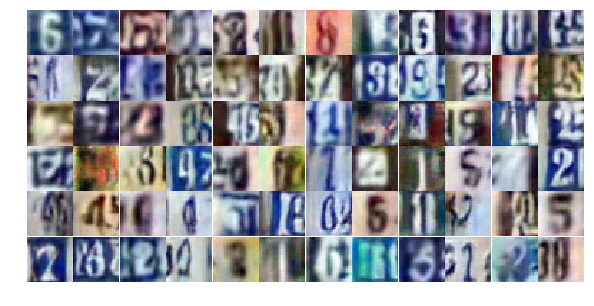

Epoch 21/25... Discriminator Loss: 0.8173... Generator Loss: 0.9118
Epoch 21/25... Discriminator Loss: 0.2790... Generator Loss: 2.5911
Epoch 21/25... Discriminator Loss: 1.3445... Generator Loss: 0.4195
Epoch 21/25... Discriminator Loss: 0.3831... Generator Loss: 2.1366
Epoch 21/25... Discriminator Loss: 0.9177... Generator Loss: 0.7636
Epoch 21/25... Discriminator Loss: 1.0430... Generator Loss: 0.6409
Epoch 21/25... Discriminator Loss: 0.4424... Generator Loss: 1.8320
Epoch 21/25... Discriminator Loss: 0.6826... Generator Loss: 1.0220
Epoch 21/25... Discriminator Loss: 1.2033... Generator Loss: 0.4977
Epoch 21/25... Discriminator Loss: 1.4123... Generator Loss: 0.3880


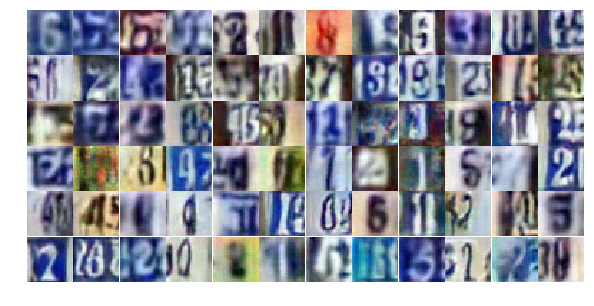

Epoch 21/25... Discriminator Loss: 1.5440... Generator Loss: 0.3405
Epoch 21/25... Discriminator Loss: 0.3258... Generator Loss: 1.9095
Epoch 21/25... Discriminator Loss: 0.9323... Generator Loss: 0.7543
Epoch 21/25... Discriminator Loss: 0.7820... Generator Loss: 0.9511
Epoch 21/25... Discriminator Loss: 0.6696... Generator Loss: 1.0666
Epoch 21/25... Discriminator Loss: 1.2616... Generator Loss: 0.4973
Epoch 21/25... Discriminator Loss: 1.2652... Generator Loss: 0.5150
Epoch 21/25... Discriminator Loss: 1.0074... Generator Loss: 0.6177
Epoch 21/25... Discriminator Loss: 0.9540... Generator Loss: 0.6514
Epoch 21/25... Discriminator Loss: 0.3263... Generator Loss: 1.8171


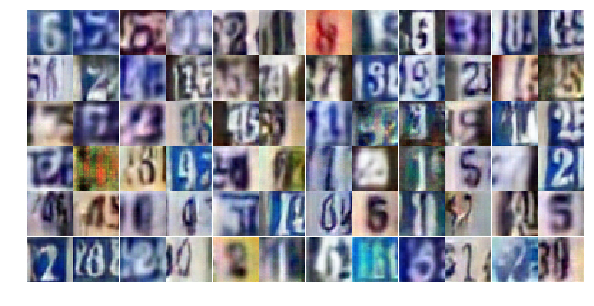

Epoch 21/25... Discriminator Loss: 0.5608... Generator Loss: 1.2404
Epoch 21/25... Discriminator Loss: 1.2132... Generator Loss: 0.5211
Epoch 21/25... Discriminator Loss: 0.5374... Generator Loss: 1.2056
Epoch 21/25... Discriminator Loss: 0.7970... Generator Loss: 0.9156
Epoch 21/25... Discriminator Loss: 0.4115... Generator Loss: 1.6492
Epoch 21/25... Discriminator Loss: 0.6043... Generator Loss: 1.0941
Epoch 21/25... Discriminator Loss: 0.7894... Generator Loss: 0.9128
Epoch 21/25... Discriminator Loss: 0.5763... Generator Loss: 1.2204
Epoch 21/25... Discriminator Loss: 0.6744... Generator Loss: 1.1277
Epoch 21/25... Discriminator Loss: 1.5713... Generator Loss: 0.3444


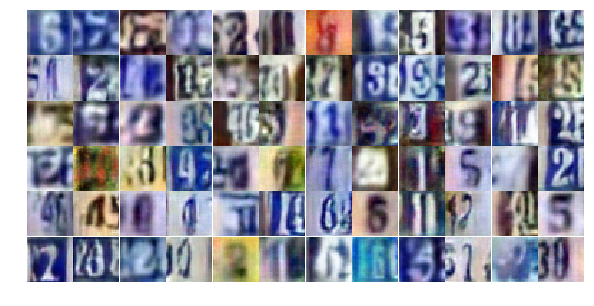

Epoch 21/25... Discriminator Loss: 0.6048... Generator Loss: 1.2518
Epoch 21/25... Discriminator Loss: 0.9118... Generator Loss: 0.7392
Epoch 21/25... Discriminator Loss: 1.2732... Generator Loss: 0.5023
Epoch 22/25... Discriminator Loss: 0.6548... Generator Loss: 1.1563
Epoch 22/25... Discriminator Loss: 0.4066... Generator Loss: 1.6642
Epoch 22/25... Discriminator Loss: 0.5385... Generator Loss: 1.2481
Epoch 22/25... Discriminator Loss: 0.1808... Generator Loss: 2.7558
Epoch 22/25... Discriminator Loss: 0.3039... Generator Loss: 1.7573
Epoch 22/25... Discriminator Loss: 1.5004... Generator Loss: 0.3436
Epoch 22/25... Discriminator Loss: 2.6374... Generator Loss: 4.4774


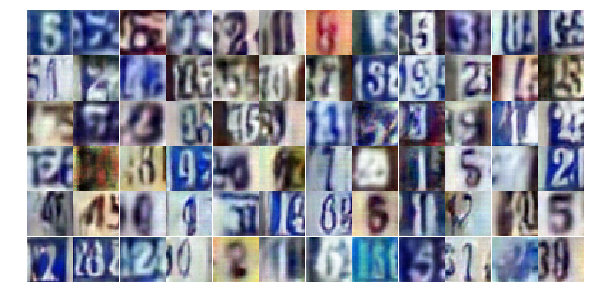

Epoch 22/25... Discriminator Loss: 1.5778... Generator Loss: 0.9922
Epoch 22/25... Discriminator Loss: 1.0455... Generator Loss: 0.8166
Epoch 22/25... Discriminator Loss: 1.5293... Generator Loss: 0.4016
Epoch 22/25... Discriminator Loss: 0.7593... Generator Loss: 1.5564
Epoch 22/25... Discriminator Loss: 0.9434... Generator Loss: 0.7875
Epoch 22/25... Discriminator Loss: 0.8361... Generator Loss: 0.8244
Epoch 22/25... Discriminator Loss: 0.7890... Generator Loss: 0.8758
Epoch 22/25... Discriminator Loss: 0.2903... Generator Loss: 2.1683
Epoch 22/25... Discriminator Loss: 0.7589... Generator Loss: 1.0728
Epoch 22/25... Discriminator Loss: 1.6140... Generator Loss: 0.2952


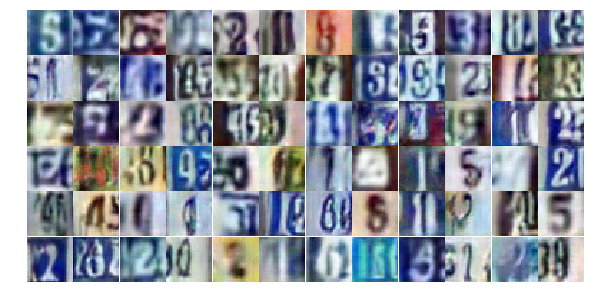

Epoch 22/25... Discriminator Loss: 0.4843... Generator Loss: 1.9833
Epoch 22/25... Discriminator Loss: 0.7012... Generator Loss: 1.4520
Epoch 22/25... Discriminator Loss: 0.7431... Generator Loss: 1.5284
Epoch 22/25... Discriminator Loss: 0.2924... Generator Loss: 1.6867
Epoch 22/25... Discriminator Loss: 0.3704... Generator Loss: 2.0028
Epoch 22/25... Discriminator Loss: 0.5046... Generator Loss: 1.6310
Epoch 22/25... Discriminator Loss: 0.3535... Generator Loss: 1.8461
Epoch 22/25... Discriminator Loss: 0.3936... Generator Loss: 1.6587
Epoch 22/25... Discriminator Loss: 0.2943... Generator Loss: 2.3575
Epoch 22/25... Discriminator Loss: 1.0584... Generator Loss: 0.5991


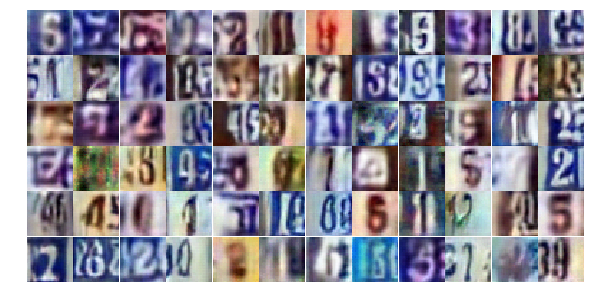

Epoch 22/25... Discriminator Loss: 0.3816... Generator Loss: 1.5514
Epoch 22/25... Discriminator Loss: 0.6168... Generator Loss: 1.0354
Epoch 22/25... Discriminator Loss: 1.0023... Generator Loss: 0.6851
Epoch 22/25... Discriminator Loss: 1.2182... Generator Loss: 0.5016
Epoch 22/25... Discriminator Loss: 0.8977... Generator Loss: 0.8608
Epoch 22/25... Discriminator Loss: 0.8309... Generator Loss: 0.8515
Epoch 22/25... Discriminator Loss: 1.2083... Generator Loss: 0.5512
Epoch 22/25... Discriminator Loss: 0.9187... Generator Loss: 0.7812
Epoch 22/25... Discriminator Loss: 0.8358... Generator Loss: 0.8056
Epoch 22/25... Discriminator Loss: 0.7186... Generator Loss: 1.0080


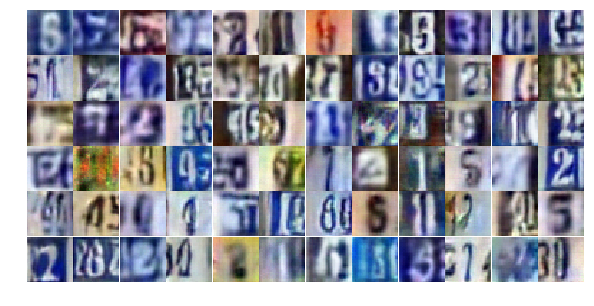

Epoch 22/25... Discriminator Loss: 0.6060... Generator Loss: 1.1501
Epoch 22/25... Discriminator Loss: 0.4986... Generator Loss: 1.5051
Epoch 22/25... Discriminator Loss: 0.5998... Generator Loss: 1.0781
Epoch 22/25... Discriminator Loss: 0.2455... Generator Loss: 2.7366
Epoch 22/25... Discriminator Loss: 0.3458... Generator Loss: 3.2750
Epoch 22/25... Discriminator Loss: 0.4118... Generator Loss: 1.5134
Epoch 22/25... Discriminator Loss: 0.6008... Generator Loss: 1.2852
Epoch 22/25... Discriminator Loss: 1.2166... Generator Loss: 0.5654
Epoch 22/25... Discriminator Loss: 0.6918... Generator Loss: 1.0254
Epoch 22/25... Discriminator Loss: 0.9917... Generator Loss: 0.7272


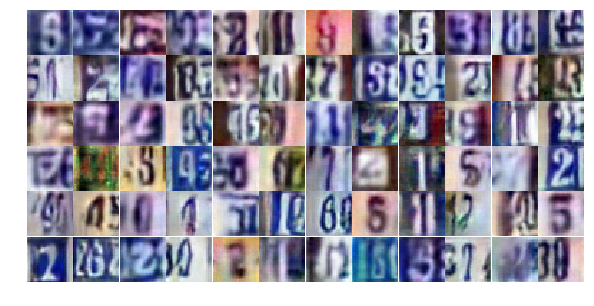

Epoch 22/25... Discriminator Loss: 0.6463... Generator Loss: 1.4370
Epoch 22/25... Discriminator Loss: 0.6234... Generator Loss: 1.1276
Epoch 22/25... Discriminator Loss: 0.8069... Generator Loss: 0.8101
Epoch 22/25... Discriminator Loss: 1.2110... Generator Loss: 0.5379
Epoch 22/25... Discriminator Loss: 0.9119... Generator Loss: 0.8238
Epoch 22/25... Discriminator Loss: 0.8843... Generator Loss: 0.7279
Epoch 22/25... Discriminator Loss: 1.4309... Generator Loss: 0.4661
Epoch 22/25... Discriminator Loss: 0.5573... Generator Loss: 1.1199
Epoch 22/25... Discriminator Loss: 0.4382... Generator Loss: 2.2277
Epoch 22/25... Discriminator Loss: 0.7318... Generator Loss: 0.9369


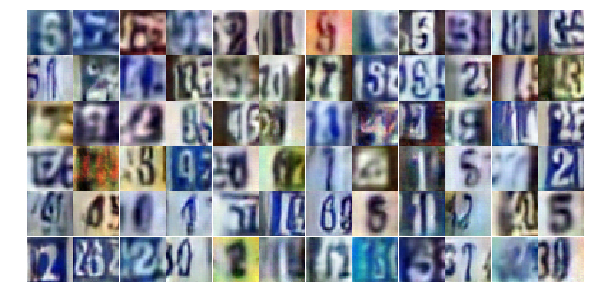

Epoch 23/25... Discriminator Loss: 0.6015... Generator Loss: 1.0649
Epoch 23/25... Discriminator Loss: 0.3943... Generator Loss: 1.5911
Epoch 23/25... Discriminator Loss: 1.3918... Generator Loss: 0.4878
Epoch 23/25... Discriminator Loss: 0.5605... Generator Loss: 1.3824
Epoch 23/25... Discriminator Loss: 0.3784... Generator Loss: 1.7977
Epoch 23/25... Discriminator Loss: 0.8336... Generator Loss: 0.8421
Epoch 23/25... Discriminator Loss: 1.2561... Generator Loss: 0.5199
Epoch 23/25... Discriminator Loss: 0.9697... Generator Loss: 0.7060
Epoch 23/25... Discriminator Loss: 0.6481... Generator Loss: 1.1139
Epoch 23/25... Discriminator Loss: 0.3437... Generator Loss: 1.8470


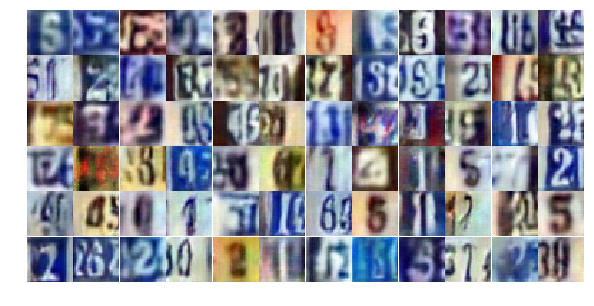

Epoch 23/25... Discriminator Loss: 0.3756... Generator Loss: 1.7799
Epoch 23/25... Discriminator Loss: 0.5968... Generator Loss: 1.1326
Epoch 23/25... Discriminator Loss: 0.6082... Generator Loss: 1.1458
Epoch 23/25... Discriminator Loss: 0.6009... Generator Loss: 1.4853
Epoch 23/25... Discriminator Loss: 0.4269... Generator Loss: 1.4024
Epoch 23/25... Discriminator Loss: 0.9661... Generator Loss: 0.6529
Epoch 23/25... Discriminator Loss: 0.4821... Generator Loss: 1.4551
Epoch 23/25... Discriminator Loss: 0.6943... Generator Loss: 1.1565
Epoch 23/25... Discriminator Loss: 1.2031... Generator Loss: 0.4984
Epoch 23/25... Discriminator Loss: 0.4674... Generator Loss: 1.9093


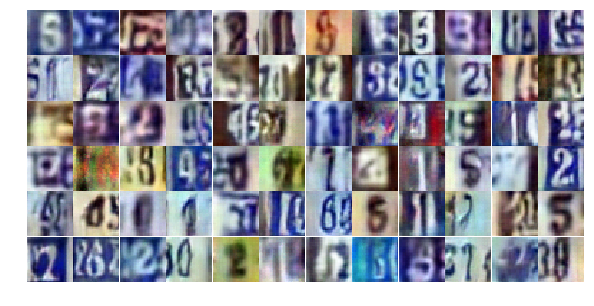

Epoch 23/25... Discriminator Loss: 1.1677... Generator Loss: 0.5333
Epoch 23/25... Discriminator Loss: 0.5235... Generator Loss: 1.4291
Epoch 23/25... Discriminator Loss: 1.0929... Generator Loss: 0.5866
Epoch 23/25... Discriminator Loss: 0.7073... Generator Loss: 0.9293
Epoch 23/25... Discriminator Loss: 0.6931... Generator Loss: 0.9724
Epoch 23/25... Discriminator Loss: 0.4905... Generator Loss: 1.9573
Epoch 23/25... Discriminator Loss: 0.6205... Generator Loss: 1.1348
Epoch 23/25... Discriminator Loss: 0.3923... Generator Loss: 1.5084
Epoch 23/25... Discriminator Loss: 0.8444... Generator Loss: 0.9364
Epoch 23/25... Discriminator Loss: 0.5166... Generator Loss: 2.0548


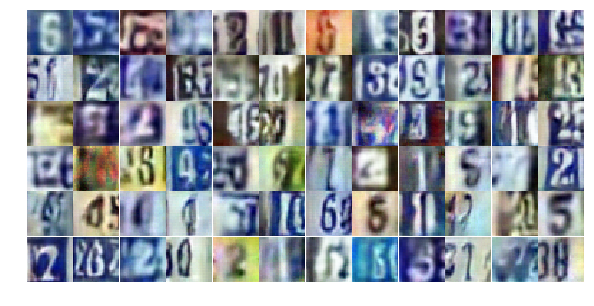

Epoch 23/25... Discriminator Loss: 0.3645... Generator Loss: 1.9388
Epoch 23/25... Discriminator Loss: 0.3565... Generator Loss: 1.7865
Epoch 23/25... Discriminator Loss: 0.9480... Generator Loss: 0.8350
Epoch 23/25... Discriminator Loss: 1.6684... Generator Loss: 0.3062
Epoch 23/25... Discriminator Loss: 0.6714... Generator Loss: 1.1650
Epoch 23/25... Discriminator Loss: 0.7733... Generator Loss: 1.0980
Epoch 23/25... Discriminator Loss: 0.8223... Generator Loss: 0.9354
Epoch 23/25... Discriminator Loss: 0.6670... Generator Loss: 1.2022
Epoch 23/25... Discriminator Loss: 0.4824... Generator Loss: 1.6146
Epoch 23/25... Discriminator Loss: 0.5316... Generator Loss: 1.2450


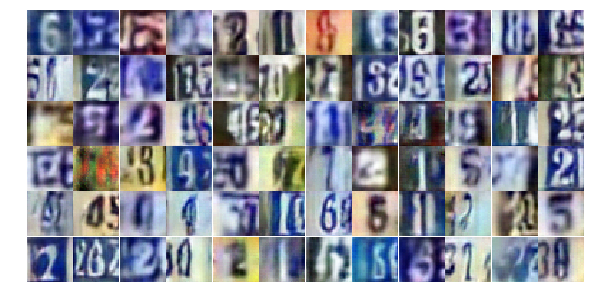

Epoch 23/25... Discriminator Loss: 0.7005... Generator Loss: 1.1316
Epoch 23/25... Discriminator Loss: 0.6735... Generator Loss: 0.9337
Epoch 23/25... Discriminator Loss: 0.7041... Generator Loss: 1.0429
Epoch 23/25... Discriminator Loss: 0.8559... Generator Loss: 0.7680
Epoch 23/25... Discriminator Loss: 3.7383... Generator Loss: 6.6560
Epoch 23/25... Discriminator Loss: 1.7989... Generator Loss: 1.5027
Epoch 23/25... Discriminator Loss: 1.5843... Generator Loss: 1.4554
Epoch 23/25... Discriminator Loss: 1.4434... Generator Loss: 0.8731
Epoch 23/25... Discriminator Loss: 1.0988... Generator Loss: 2.1986
Epoch 23/25... Discriminator Loss: 0.8430... Generator Loss: 0.9103


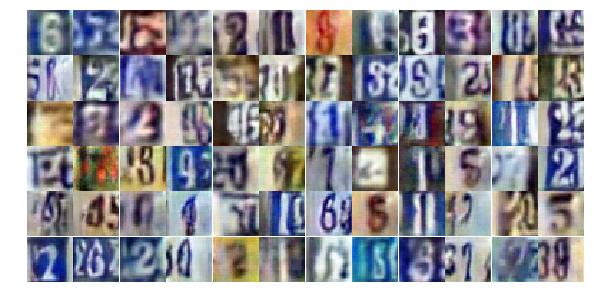

Epoch 23/25... Discriminator Loss: 0.7630... Generator Loss: 0.9876
Epoch 23/25... Discriminator Loss: 1.2860... Generator Loss: 0.4965
Epoch 23/25... Discriminator Loss: 0.8343... Generator Loss: 0.9016
Epoch 23/25... Discriminator Loss: 0.3808... Generator Loss: 1.7052
Epoch 23/25... Discriminator Loss: 1.3242... Generator Loss: 0.4263
Epoch 23/25... Discriminator Loss: 0.7634... Generator Loss: 1.0085
Epoch 23/25... Discriminator Loss: 1.0789... Generator Loss: 0.6164
Epoch 24/25... Discriminator Loss: 0.4712... Generator Loss: 1.5005
Epoch 24/25... Discriminator Loss: 0.7267... Generator Loss: 1.0169
Epoch 24/25... Discriminator Loss: 1.0028... Generator Loss: 0.7112


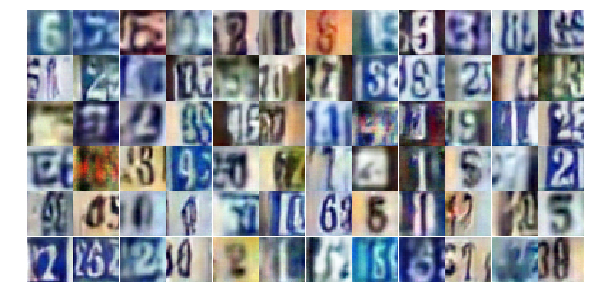

Epoch 24/25... Discriminator Loss: 0.6657... Generator Loss: 1.2254
Epoch 24/25... Discriminator Loss: 0.4968... Generator Loss: 1.6760
Epoch 24/25... Discriminator Loss: 0.4924... Generator Loss: 1.3323
Epoch 24/25... Discriminator Loss: 1.0180... Generator Loss: 2.3093
Epoch 24/25... Discriminator Loss: 0.6452... Generator Loss: 1.0951
Epoch 24/25... Discriminator Loss: 0.9496... Generator Loss: 0.7100
Epoch 24/25... Discriminator Loss: 0.7352... Generator Loss: 0.9975
Epoch 24/25... Discriminator Loss: 1.3198... Generator Loss: 0.4962
Epoch 24/25... Discriminator Loss: 0.5859... Generator Loss: 1.0938
Epoch 24/25... Discriminator Loss: 0.3872... Generator Loss: 1.6448


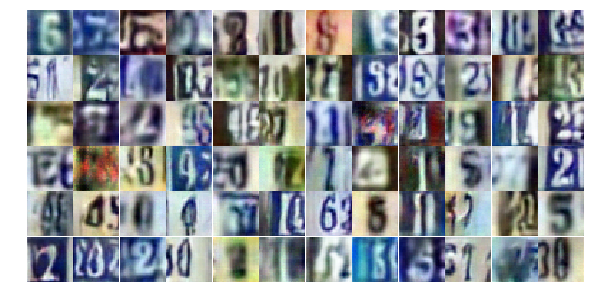

Epoch 24/25... Discriminator Loss: 1.1384... Generator Loss: 0.5498
Epoch 24/25... Discriminator Loss: 1.2587... Generator Loss: 0.4628
Epoch 24/25... Discriminator Loss: 1.3153... Generator Loss: 0.4566
Epoch 24/25... Discriminator Loss: 0.3615... Generator Loss: 2.0464
Epoch 24/25... Discriminator Loss: 0.7849... Generator Loss: 2.1861
Epoch 24/25... Discriminator Loss: 0.7512... Generator Loss: 1.0349
Epoch 24/25... Discriminator Loss: 0.5111... Generator Loss: 1.4588
Epoch 24/25... Discriminator Loss: 1.1011... Generator Loss: 0.7190
Epoch 24/25... Discriminator Loss: 0.7650... Generator Loss: 0.9402
Epoch 24/25... Discriminator Loss: 0.8428... Generator Loss: 0.8807


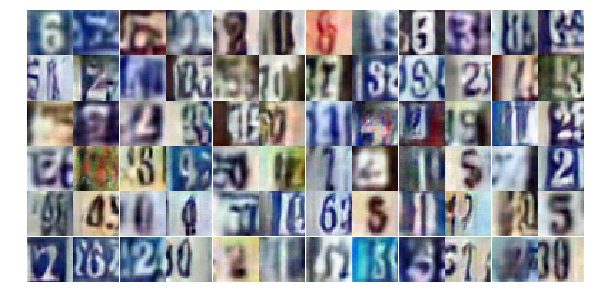

Epoch 24/25... Discriminator Loss: 0.3733... Generator Loss: 1.7547
Epoch 24/25... Discriminator Loss: 0.6251... Generator Loss: 1.2109
Epoch 24/25... Discriminator Loss: 0.2129... Generator Loss: 2.1680
Epoch 24/25... Discriminator Loss: 0.8554... Generator Loss: 0.7945
Epoch 24/25... Discriminator Loss: 0.4463... Generator Loss: 1.8861
Epoch 24/25... Discriminator Loss: 1.1526... Generator Loss: 0.9080
Epoch 24/25... Discriminator Loss: 0.4410... Generator Loss: 1.4530
Epoch 24/25... Discriminator Loss: 0.5245... Generator Loss: 2.9039
Epoch 24/25... Discriminator Loss: 0.5834... Generator Loss: 1.4412
Epoch 24/25... Discriminator Loss: 0.8045... Generator Loss: 0.8005


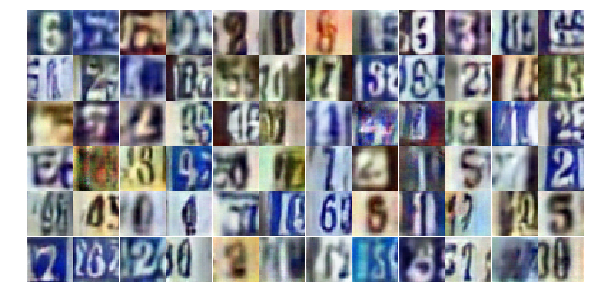

Epoch 24/25... Discriminator Loss: 0.4933... Generator Loss: 1.3845
Epoch 24/25... Discriminator Loss: 0.7784... Generator Loss: 0.8143
Epoch 24/25... Discriminator Loss: 0.6511... Generator Loss: 1.2167
Epoch 24/25... Discriminator Loss: 1.4294... Generator Loss: 0.3959
Epoch 24/25... Discriminator Loss: 0.9600... Generator Loss: 0.7391
Epoch 24/25... Discriminator Loss: 0.7613... Generator Loss: 0.8249
Epoch 24/25... Discriminator Loss: 0.9060... Generator Loss: 0.8002
Epoch 24/25... Discriminator Loss: 0.5702... Generator Loss: 1.4107
Epoch 24/25... Discriminator Loss: 0.7061... Generator Loss: 1.0731
Epoch 24/25... Discriminator Loss: 0.3923... Generator Loss: 1.8596


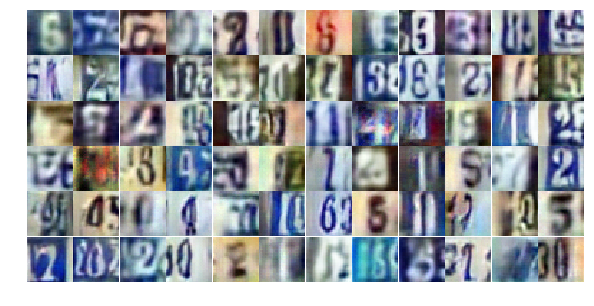

Epoch 24/25... Discriminator Loss: 0.6716... Generator Loss: 1.0914
Epoch 24/25... Discriminator Loss: 1.3054... Generator Loss: 0.4131
Epoch 24/25... Discriminator Loss: 0.5878... Generator Loss: 1.2268
Epoch 24/25... Discriminator Loss: 1.2420... Generator Loss: 0.5750
Epoch 24/25... Discriminator Loss: 1.5845... Generator Loss: 0.3532
Epoch 24/25... Discriminator Loss: 0.5061... Generator Loss: 1.4050
Epoch 24/25... Discriminator Loss: 0.9395... Generator Loss: 0.6526
Epoch 24/25... Discriminator Loss: 0.6224... Generator Loss: 1.0907
Epoch 24/25... Discriminator Loss: 0.8406... Generator Loss: 0.8103
Epoch 24/25... Discriminator Loss: 0.5706... Generator Loss: 1.6017


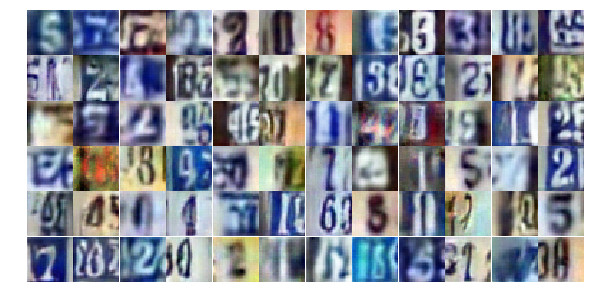

Epoch 24/25... Discriminator Loss: 0.5126... Generator Loss: 1.3735
Epoch 24/25... Discriminator Loss: 1.0998... Generator Loss: 0.5622
Epoch 24/25... Discriminator Loss: 0.3738... Generator Loss: 1.6179
Epoch 24/25... Discriminator Loss: 1.2076... Generator Loss: 0.4964
Epoch 24/25... Discriminator Loss: 1.0629... Generator Loss: 0.6158
Epoch 25/25... Discriminator Loss: 0.6177... Generator Loss: 1.4334
Epoch 25/25... Discriminator Loss: 0.4489... Generator Loss: 1.5647
Epoch 25/25... Discriminator Loss: 0.4655... Generator Loss: 1.4038
Epoch 25/25... Discriminator Loss: 1.5993... Generator Loss: 0.3927
Epoch 25/25... Discriminator Loss: 0.8454... Generator Loss: 0.8433


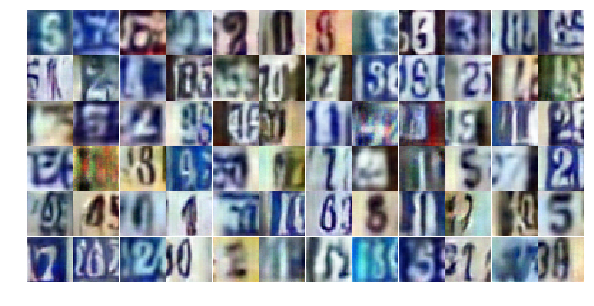

Epoch 25/25... Discriminator Loss: 0.4876... Generator Loss: 1.6753
Epoch 25/25... Discriminator Loss: 2.0782... Generator Loss: 0.2938
Epoch 25/25... Discriminator Loss: 1.2189... Generator Loss: 3.0941
Epoch 25/25... Discriminator Loss: 0.7334... Generator Loss: 1.0184
Epoch 25/25... Discriminator Loss: 0.8840... Generator Loss: 2.2351
Epoch 25/25... Discriminator Loss: 0.3654... Generator Loss: 1.9566
Epoch 25/25... Discriminator Loss: 0.9447... Generator Loss: 0.7133
Epoch 25/25... Discriminator Loss: 0.7255... Generator Loss: 1.0832
Epoch 25/25... Discriminator Loss: 0.8080... Generator Loss: 0.8957
Epoch 25/25... Discriminator Loss: 0.5123... Generator Loss: 1.4926


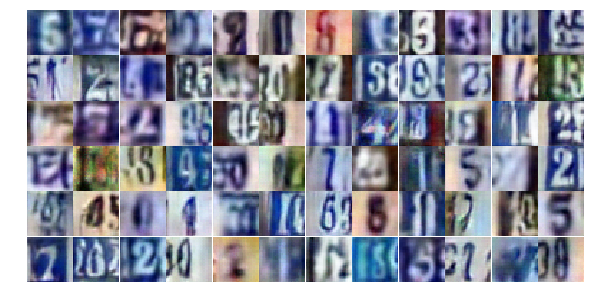

Epoch 25/25... Discriminator Loss: 0.7134... Generator Loss: 1.1361
Epoch 25/25... Discriminator Loss: 0.5590... Generator Loss: 2.7643
Epoch 25/25... Discriminator Loss: 1.4792... Generator Loss: 0.3980
Epoch 25/25... Discriminator Loss: 0.8516... Generator Loss: 0.8243
Epoch 25/25... Discriminator Loss: 0.6734... Generator Loss: 1.0712
Epoch 25/25... Discriminator Loss: 0.4294... Generator Loss: 1.5026
Epoch 25/25... Discriminator Loss: 0.7774... Generator Loss: 0.8752
Epoch 25/25... Discriminator Loss: 0.9978... Generator Loss: 0.6541
Epoch 25/25... Discriminator Loss: 0.4641... Generator Loss: 1.4464
Epoch 25/25... Discriminator Loss: 0.7780... Generator Loss: 0.9579


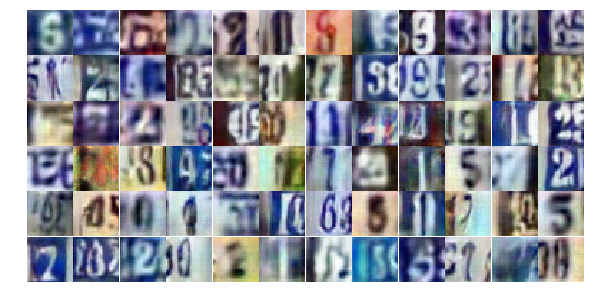

Epoch 25/25... Discriminator Loss: 1.3612... Generator Loss: 0.4495
Epoch 25/25... Discriminator Loss: 0.6536... Generator Loss: 0.9864
Epoch 25/25... Discriminator Loss: 1.6893... Generator Loss: 0.2977
Epoch 25/25... Discriminator Loss: 0.5792... Generator Loss: 1.2172
Epoch 25/25... Discriminator Loss: 0.6683... Generator Loss: 1.2896
Epoch 25/25... Discriminator Loss: 0.2893... Generator Loss: 1.9988
Epoch 25/25... Discriminator Loss: 0.8374... Generator Loss: 0.7807
Epoch 25/25... Discriminator Loss: 0.4605... Generator Loss: 1.5072
Epoch 25/25... Discriminator Loss: 0.7830... Generator Loss: 0.9679
Epoch 25/25... Discriminator Loss: 0.5332... Generator Loss: 1.3447


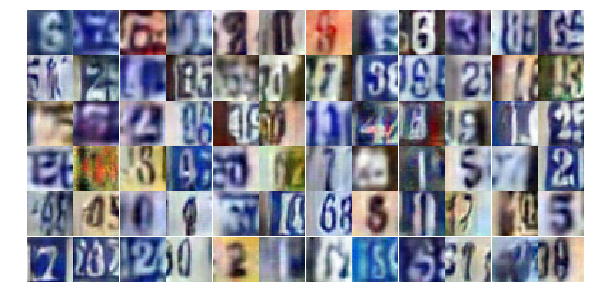

Epoch 25/25... Discriminator Loss: 1.1300... Generator Loss: 0.5358
Epoch 25/25... Discriminator Loss: 0.3327... Generator Loss: 2.8469
Epoch 25/25... Discriminator Loss: 0.5480... Generator Loss: 1.4354
Epoch 25/25... Discriminator Loss: 0.3132... Generator Loss: 1.9306
Epoch 25/25... Discriminator Loss: 0.7768... Generator Loss: 0.8635
Epoch 25/25... Discriminator Loss: 1.5760... Generator Loss: 0.3319
Epoch 25/25... Discriminator Loss: 0.9341... Generator Loss: 0.7167
Epoch 25/25... Discriminator Loss: 0.2718... Generator Loss: 2.2706
Epoch 25/25... Discriminator Loss: 1.9193... Generator Loss: 0.2306
Epoch 25/25... Discriminator Loss: 0.5260... Generator Loss: 1.4638


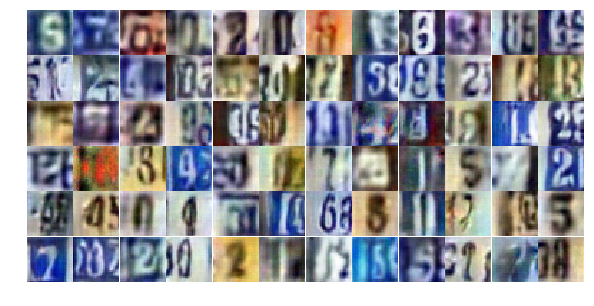

Epoch 25/25... Discriminator Loss: 1.3926... Generator Loss: 0.4727
Epoch 25/25... Discriminator Loss: 0.6428... Generator Loss: 1.3812
Epoch 25/25... Discriminator Loss: 1.0978... Generator Loss: 0.6422
Epoch 25/25... Discriminator Loss: 0.5859... Generator Loss: 1.2571
Epoch 25/25... Discriminator Loss: 0.9219... Generator Loss: 0.7612
Epoch 25/25... Discriminator Loss: 0.3903... Generator Loss: 1.5841
Epoch 25/25... Discriminator Loss: 0.5879... Generator Loss: 1.3702
Epoch 25/25... Discriminator Loss: 0.3762... Generator Loss: 1.7084
Epoch 25/25... Discriminator Loss: 0.4475... Generator Loss: 2.3325
Epoch 25/25... Discriminator Loss: 1.1144... Generator Loss: 0.6317


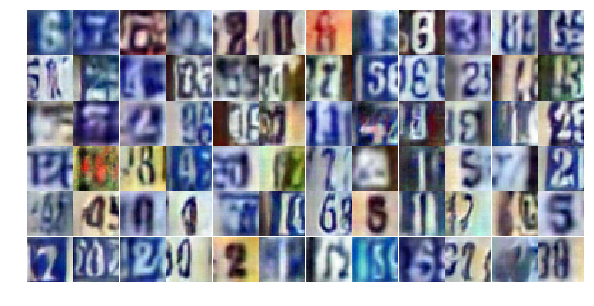

Epoch 25/25... Discriminator Loss: 0.3668... Generator Loss: 1.9417
Epoch 25/25... Discriminator Loss: 1.1985... Generator Loss: 0.5053


In [25]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

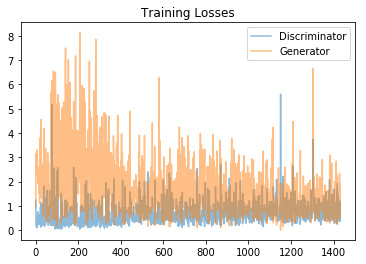

In [26]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/usr/local/lib/python3.5/dist-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


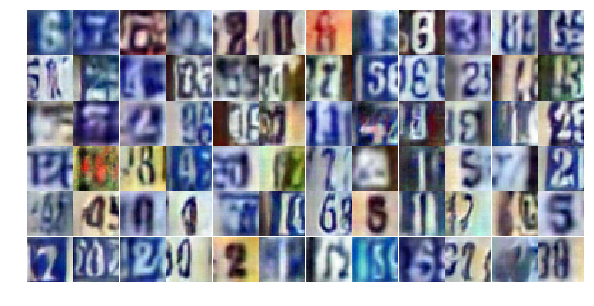

In [27]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))